

```
# This is formatted as code
```

# Data

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from prophet import Prophet
from google.colab import drive

drive.mount("/content/drive")
%cd /content/drive/MyDrive/Capstone/Data/cleaned/
%ls

Mounted at /content/drive
/content/drive/.shortcut-targets-by-id/1vzI5qEHuzB31gSTnOrTquwU_Kg35t7Z5/Capstone/Data/cleaned
foo.png                    Manufacturing.xlsx  Service_all.xlsx
Manufacturing_all.xlsx     model.png           Service_filled.xlsx
Manufacturing_filled.xlsx  outputs/            Service.xlsx


In [2]:
dic_country = \
{'AUS': 'Australia',
 'BRA': 'Brazil',
 'CAN': 'India',
 'CHN': 'China',
 'GBR': 'United Kingdom',
 'IND': 'India',
 'JPN': 'Japan',
 'SGP': 'Singapore',
 'USA': 'United States'}
pd.DataFrame(dic_country,index=[0]).T.reset_index().rename(columns = {'index': 'country_code', 0: 'country_name'})

,country_code,country_name
0,AUS,Australia
1,BRA,Brazil
2,CAN,India
3,CHN,China
4,GBR,United Kingdom
5,IND,India
6,JPN,Japan
7,SGP,Singapore
8,USA,United States


In [3]:
Data_dic_m = pd.ExcelFile('Manufacturing_filled.xlsx')
Data_dic_s = pd.ExcelFile('Service_filled.xlsx')

In [4]:
def get_sheet_by_methods(data, method_num, verbose = 0):
  sheet_names = data.sheet_names
  sheet_imputation_map = pd.DataFrame([[s, s[:3].strip(),s[3:]] for s in sheet_names], columns = ['sheet_name', 'country_code', 'imputation method'])
  methods = sheet_imputation_map['imputation method'].unique()
  if verbose:
    print('methods tried:',methods, len(methods))
  return list(sheet_imputation_map.loc[sheet_imputation_map['imputation method'] == methods[method_num]]['sheet_name'].values)

In [5]:
m_dfs = {}
# for i in range(len(Data_dic_m.sheet_names) // 10):
  # for sheet in get_sheet_by_methods(Data_dic_m, i):
for sheet in Data_dic_m.sheet_names:
    df = pd.read_excel(Data_dic_m, sheet_name=sheet)
    df['Year'] = [i.year for i in pd.to_datetime(df.Year, format='%Y')]
    df = df.set_index('Year')
    m_dfs[(sheet)] = df

In [6]:
s_dfs = {}
# for i in range(len(Data_dic_s.sheet_names) // 10):
  # for sheet in get_sheet_by_methods(Data_dic_s, i):
for sheet in Data_dic_s.sheet_names:
    df = pd.read_excel(Data_dic_s, sheet_name=sheet)
    df['Year'] = [i.year for i in pd.to_datetime(df.Year, format='%Y')]
    df = df.set_index('Year')
    s_dfs[(sheet)] = df

In [7]:
m_dfs.keys()

dict_keys(['AUS', 'BRA', 'CAN', 'CHN', 'GBR', 'IND', 'JPN', 'SGP', 'USA'])

In [8]:
aus_data_m = m_dfs[("AUS")]
bra_data_m = m_dfs[("BRA")]
can_data_m = m_dfs[("CAN")]
chn_data_m = m_dfs[("CHN")]
gbr_data_m = m_dfs[("GBR")]
ind_data_m = m_dfs[("IND")]
jpn_data_m = m_dfs[("JPN")]
sgp_data_m = m_dfs[("SGP")]
usa_data_m = m_dfs[("USA")]

In [9]:
aus_data_s = s_dfs[("AUS")]
bra_data_s = s_dfs[("BRA")]
can_data_s = s_dfs[("CAN")]
chn_data_s = s_dfs[("CHN")]
gbr_data_s = s_dfs[("GBR")]
ind_data_s = s_dfs[("IND")]
jpn_data_s = s_dfs[("JPN")]
sgp_data_s = s_dfs[("SGP")]
usa_data_s = s_dfs[("USA")]

In [10]:
aus_data_m.keys()

Index(['Employment_in_industry_male', 'High_technology_exports',
       'Research_development_expenditure', 'Researchers in R&D',
       'Population_labor_rate', 'Population_density',
       'Foreign_direct_investment', 'Net_trade_in_goods_services',
       'Air_freight_million_ton_km', 'Container_port_traffic_TEU',
       'Railways_goods_trans_million_ton-km',
       'Industry_value_added_current_USD', 'GDP_per_capita_current_USD',
       'Final_consumption', 'New_business_density',
       'Employment_in_industry_%_of_total_employment',
       'Manufacturing_value added_%_of_GDP'],
      dtype='object')

In [11]:
aus_data_s.keys()

Index(['Employment_in_services_male', 'Urban_population_growth',
       'Net_trade_in_goods_services', 'Foreign_direct_investment',
       'Mobile_cellular_subscriptions', 'Secure_Internet_servers',
       'School_enrollment_tertiary', 'Population_labor_rate',
       'Population_density', 'Access_electricity',
       'Employment_in_service_%_of_total_employment',
       'GDP_per_capita_current_USD', 'Final_consumption',
       'Educational_attainment',
       'Individuals_using_the_Internet_%_of_population',
       'Poverty_headcount_ratio', 'New_business_density',
       'Services_value_added_%_of_GDP'],
      dtype='object')

In [12]:
  data = aus_data_s
  cur_col = list(data.columns)
  scaled_data1 = data.copy()
  scaled_data1['Month'] = 1
  scaled_data1.loc[2021, 'Month'] = 12
  scaled_data1 = scaled_data1[['Month'] + cur_col]
  tmp = scaled_data1.copy().reset_index()
  pd_year_month = pd.DataFrame(
      {'Year': np.array([[i] * 12 for i in list(data.index)]).reshape(-1),
       'Month':list(range(1, 13)) * len(data)
  })
  scaled_data1 = pd_year_month.merge(scaled_data1,  on = ['Year', 'Month'], how ='left')\
              .interpolate(method="polynomial", order=2)

# Prophet Model

In [13]:
def mse(y, yhat):
  res = 0
  for i in range(len(y)):
    res += (y[i] - yhat[i]) ** 2
  return res / len(y)

def rmse(y, yhat):
  res = 0
  for i in range(len(y)):
    res += (y[i] - yhat[i]) ** 2
  return (res / len(y)) ** 0.5

def mae(y, yhat):
  res = 0
  for i in range(len(y)):
    res += abs(y[i] - yhat[i])
  return res / len(y)

def mape(y, yhat):
  res = 0
  for i in range(len(y)):
    res += (abs(y[i] - yhat[i]) / y[i]) * 100
  return res / len(y)

In [ ]:
def fit_model_m(data):
  prophet = Prophet(seasonality_mode='multiplicative')
  data = data.reset_index()
  data = data.rename(columns={'Year': "ds", "Manufacturing_value added_%_of_GDP": "y"})
  data_train = data[data['ds'] <= 2016]
  data_test = data[data['ds'] > 2016]
  data_test = list(data_test['y'])
  prophet.fit(data_train)
  future = prophet.make_future_dataframe(periods = 51, freq="YS").tail(42)
  forecast = prophet.predict(future)
  prophet.plot(forecast)
  print("--------------------Evaluation---------------------")
  print("MSE : ", mse(data_test, list(forecast['yhat'][-5:])))
  print("MAE : ", mae(data_test, list(forecast['yhat'][-5:])))
  print("MAPE : ", mape(data_test, list(forecast['yhat'][-5:])))
  print("--------------------Evaluation---------------------")
  return prophet

In [14]:
def fit_model_s(data):
  prophet = Prophet(seasonality_mode='multiplicative')
  data = data.reset_index()
  data = data.rename(columns={'Year': "ds", "Services_value_added_%_of_GDP": "y"})
  data_train = data[data['ds'] <= 2016]
  data_test = data[data['ds'] > 2016]
  data_test = list(data_test['y'])
  prophet.fit(data_train)
  future = prophet.make_future_dataframe(periods = 51, freq="YS").tail(42)
  forecast = prophet.predict(future)
  prophet.plot(forecast)
  print("--------------------Evaluation---------------------")
  print("MSE : ", mse(data_test, list(forecast['yhat'][-5:])))
  print("MAE : ", mae(data_test, list(forecast['yhat'][-5:])))
  print("MAPE : ", mape(data_test, list(forecast['yhat'][-5:])))
  print("--------------------Evaluation---------------------")
  return prophet

In [15]:
! pip install bayesian-optimization

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [16]:
from prophet.diagnostics import cross_validation, performance_metrics
from bayes_opt import BayesianOptimization
from holidays import date
from prophet.forecaster import datetime

In [17]:
aus_data_m = aus_data_m.reset_index()
aus_data_m = aus_data_m.rename(columns={'Year': "ds", "Manufacturing_value added_%_of_GDP": "y"})

In [18]:
def getOpt_m(data, to2016):
  if to2016:
    data_train = data[data['ds'] <= 2016]
  else:
    data_train = data
  def prophet_f(yearly_prior, metric = 'rmse', period = '365 days'):
                     
    m = Prophet(seasonality_mode='multiplicative')
    
    m.add_seasonality(name   = 'yearly',
                      period = 365,
                      mode   = 'additive',
                      prior_scale   = 10 ** yearly_prior,
                      fourier_order = 2)
    
    # m.add_regressor('Population_labor_rate',
    #                 mode = 'multiplicative',
    #                 prior_scale = 10 ** labor_prior)
    # m.add_regressor('GDP_per_capita_current_USD',
    #                 mode = 'multiplicative',
    #                 prior_scale = 10 ** gdp_prior)
    
    m.fit(data_train)
    df_cv = cross_validation(m,                                                  
                             initial = '3650 days',
                             period  = period,
                             horizon = '365 days')
    
    if metric == 'rmse':
        df_cv_rmse = ((df_cv.y - df_cv.yhat) ** 2).mean() ** .5
        return - df_cv_rmse
    elif metric == 'all':
        df_p = performance_metrics(df_cv)
        return m, df_p[['horizon', 'rmse', 'mae', 'mape']]

 # daily_prior_scale calculated as 10 ** daily_prior in prophet_f
  # pbounds = {'yearly_prior': (-2, 2),  'labor_prior':   (-2, 2), 
  #           'gdp_prior':   (-2, 2)}

  pbounds = {'yearly_prior': (-2, 2)}
  optimizer = BayesianOptimization(
    f = prophet_f,
    pbounds = pbounds,
    verbose = 2,  # verbose = 1 prints only when a maximum is observed, verbose = 0 is silent,
    random_state = 1
  )

  optimizer.maximize(
    init_points = 10,
    n_iter = 4)
  return optimizer, data_train 


In [19]:
def getOpt_s(data, to2016):
  if to2016:
    data_train = data[data['ds'] <= 2016]
  else:
    data_train = data
  def prophet_f(yearly_prior, metric = 'rmse', period = '365 days'):
                     
    m = Prophet(seasonality_mode='multiplicative')
    
    m.add_seasonality(name   = 'yearly',
                      period = 365,
                      mode   = 'additive',
                      prior_scale   = 10 ** yearly_prior,
                      fourier_order = 2)
    
    # m.add_regressor('Population_labor_rate',
    #                 mode = 'multiplicative',
    #                 prior_scale = 10 ** labor_prior)
    # m.add_regressor('GDP_per_capita_current_USD',
    #                 mode = 'multiplicative',
    #                 prior_scale = 10 ** gdp_prior)
    
    m.fit(data_train)
    df_cv = cross_validation(m,                                                  
                             initial = '3650 days',
                             period  = period,
                             horizon = '365 days')
    
    if metric == 'rmse':
        df_cv_rmse = ((df_cv.y - df_cv.yhat) ** 2).mean() ** .5
        return - df_cv_rmse
    elif metric == 'all':
        df_p = performance_metrics(df_cv)
        return m, df_p[['horizon', 'rmse', 'mae', 'mape']]

 # daily_prior_scale calculated as 10 ** daily_prior in prophet_f
  # pbounds = {'yearly_prior': (-2, 2),  'labor_prior':   (-2, 2), 
  #           'gdp_prior':   (-2, 2)}

  pbounds = {'yearly_prior': (-2, 2)}
  optimizer = BayesianOptimization(
    f = prophet_f,
    pbounds = pbounds,
    verbose = 2,  # verbose = 1 prints only when a maximum is observed, verbose = 0 is silent,
    random_state = 1
  )

  optimizer.maximize(
    init_points = 10,
    n_iter = 4)
  return optimizer, data_train 


In [20]:
from holidays import date
from prophet.forecaster import datetime
def evaluate_model_m(optimizer, data, to2016, logs):
  if to2016:
    data_train = data[data['ds'] <= 2016]
  else:
    data_train = data
  def prophet_f(yearly_prior, metric = 'rmse', period = '365 days'):
                     
    m = Prophet(seasonality_mode='multiplicative')
    
    m.add_seasonality(name   = 'yearly',
                      period = 365,
                      mode   = 'additive',
                      prior_scale   = 10 ** yearly_prior,
                      fourier_order = 2)
    
    # m.add_regressor('Population_labor_rate',
    #                 mode = 'multiplicative',
    #                 prior_scale = 10 ** labor_prior)
    # m.add_regressor('GDP_per_capita_current_USD',
    #                 mode = 'multiplicative',
    #                 prior_scale = 10 ** gdp_prior)
    
    m.fit(data_train)
    df_cv = cross_validation(m,                                                  
                             initial = '3650 days',
                             period  = period,
                             horizon = '365 days')
    
    if metric == 'rmse':
        df_cv_rmse = ((df_cv.y - df_cv.yhat) ** 2).mean() ** .5
        return - df_cv_rmse
    elif metric == 'all':
        df_p = performance_metrics(df_cv)
        return m, df_p[['horizon', 'rmse', 'mae', 'mape']]

  m_opt, m_diags_opt = prophet_f(optimizer.max['params']['yearly_prior'],
                               metric = 'all',
                               period = '365 days')
  future = m_opt.make_future_dataframe(periods = 100, freq="YS")
  # dates = list(future["ds"])
  # years = []
  # for item in dates:
  #   years.append(datetime.strftime(item, "%Y"))
  # future.rename(columns={'ds': "ds_o"})
  # future["ds"] = years
  forecast = m_opt.predict(future)
  m_opt.plot(forecast)
  print(forecast.keys())
  if to2016:
      tmp1 = forecast[forecast['ds'].dt.year >= data["ds"][0]] 
      tmp1 = tmp1[forecast["ds"].dt.year <= 2016]
      logs['y_fitted_on_begin_2016'] = pd.DataFrame({
          'Year': tmp1["ds"].dt.year,
          'y_value': tmp1['yhat'],
          'y_lower_bound': None,
          'y_upper_bound': None
      })
      tmp2 = forecast[forecast['ds'].dt.year >= 2017] 
      tmp2 = tmp2[forecast["ds"].dt.year <= 2021]
      logs['y_pred_on_2017_2021'] = pd.DataFrame({
          'Year': tmp2["ds"].dt.year,
          'y_value': tmp2['yhat'],
          'y_lower_bound': tmp2['yhat_lower'],
          'y_upper_bound': tmp2['yhat_upper']
      }) 
  else:
      tmp1 = forecast[forecast['ds'].dt.year >= data["ds"][0]] 
      tmp1 = tmp1[forecast["ds"].dt.year <= 2021]
      logs['y_fitted_on_begin_2021'] = pd.DataFrame({
          'Year': tmp1["ds"].dt.year,
          'y_value': tmp1['yhat'],
          'y_lower_bound': None,
          'y_upper_bound': None
      })
      tmp2 = forecast[forecast['ds'].dt.year >= 2022] 
      tmp2 = tmp2[forecast["ds"].dt.year <= 2026]
      logs['y_pred_on_2022_2026'] = pd.DataFrame({
          'Year': tmp2["ds"].dt.year,
          'y_value': tmp2['yhat'],
          'y_lower_bound': tmp2['yhat_lower'],
          'y_upper_bound': tmp2['yhat_upper']
      }) 
  
  return logs
  

  

In [21]:
def evaluate_model_s(optimizer, data, to2016, logs):
  if to2016:
    data_train = data[data['ds'] <= 2016]
  else:
    data_train = data
  def prophet_f(yearly_prior, metric = 'rmse', period = '365 days'):
                     
    m = Prophet(seasonality_mode='multiplicative')
    
    m.add_seasonality(name   = 'yearly',
                      period = 365,
                      mode   = 'additive',
                      prior_scale   = 10 ** yearly_prior,
                      fourier_order = 2)
    
    # m.add_regressor('Population_labor_rate',
    #                 mode = 'multiplicative',
    #                 prior_scale = 10 ** labor_prior)
    # m.add_regressor('GDP_per_capita_current_USD',
    #                 mode = 'multiplicative',
    #                 prior_scale = 10 ** gdp_prior)
    
    m.fit(data_train)
    df_cv = cross_validation(m,                                                  
                             initial = '3650 days',
                             period  = period,
                             horizon = '365 days')
    
    if metric == 'rmse':
        df_cv_rmse = ((df_cv.y - df_cv.yhat) ** 2).mean() ** .5
        return - df_cv_rmse
    elif metric == 'all':
        df_p = performance_metrics(df_cv)
        return m, df_p[['horizon', 'rmse', 'mae', 'mape']]

  m_opt, m_diags_opt = prophet_f(optimizer.max['params']['yearly_prior'],
                               metric = 'all',
                               period = '365 days')
  future = m_opt.make_future_dataframe(periods = 51, freq="YS").tail(42)
  # dates = list(future["ds"])
  # years = []
  # for item in dates:
  #   years.append(datetime.strftime(item, "%Y"))
  # future.rename(columns={'ds': "ds_o"})
  # future["ds"] = years
  forecast = m_opt.predict(future)
  m_opt.plot(forecast)
  if to2016:
      tmp1 = forecast[forecast['ds'].dt.year >= data["ds"][0]] 
      tmp1 = tmp1[forecast["ds"].dt.year <= 2016]
      logs['y_fitted_on_begin_2016'] = pd.DataFrame({
          'Year': tmp1["ds"].dt.year,
          'y_value': tmp1['yhat'],
          'y_lower_bound': None,
          'y_upper_bound': None
      })
      tmp2 = forecast[forecast['ds'].dt.year >= 2017] 
      tmp2 = tmp2[forecast["ds"].dt.year <= 2021]
      logs['y_pred_on_2017_2021'] = pd.DataFrame({
          'Year': tmp2["ds"].dt.year,
          'y_value': tmp2['yhat'],
          'y_lower_bound': tmp2['yhat_lower'],
          'y_upper_bound': tmp2['yhat_upper']
      }) 
  else:
      tmp1 = forecast[forecast['ds'].dt.year >= data["ds"][0]] 
      tmp1 = tmp1[forecast["ds"].dt.year <= 2021]
      logs['y_fitted_on_begin_2021'] = pd.DataFrame({
          'Year': tmp1["ds"].dt.year,
          'y_value': tmp1['yhat'],
          'y_lower_bound': None,
          'y_upper_bound': None
      })
      tmp2 = forecast[forecast['ds'].dt.year >= 2022] 
      tmp2 = tmp2[forecast["ds"].dt.year <= 2026]
      logs['y_pred_on_2022_2026'] = pd.DataFrame({
          'Year': tmp2["ds"].dt.year,
          'y_value': tmp2['yhat'],
          'y_lower_bound': tmp2['yhat_lower'],
          'y_upper_bound': tmp2['yhat_upper']
      }) 
  
  return logs


In [22]:
def generate_results_m(data, country):
  data = data.reset_index()
  data_train = data.rename(columns={'Year': "ds", "Manufacturing_value added_%_of_GDP": "y"})
  logs = {}
  optimizer, _ = getOpt_m(data_train, True)
  logs = evaluate_model_m(optimizer, data_train, True, logs)
  optimizer, _ = getOpt_m(data_train, False)
  logs = evaluate_model_m(optimizer, data_train, False, logs)
  with pd.ExcelWriter(f"../Result/Manufacturing/{country}.xlsx") as writer:
    for log_type, log in logs.items():
      log.to_excel(writer, sheet_name=log_type, index=False)

In [23]:
def generate_results_s(data, country):
  data = data.reset_index()
  data_train = data.rename(columns={'Year': "ds", "Services_value_added_%_of_GDP": "y"})
  logs = {}
  optimizer, _ = getOpt_s(data_train, True)
  logs = evaluate_model_s(optimizer, data_train, True, logs)
  optimizer, _ = getOpt_s(data_train, False)
  logs = evaluate_model_s(optimizer, data_train, False, logs)
  with pd.ExcelWriter(f"../Result/Service/{country}.xlsx") as writer:
    for log_type, log in logs.items():
      log.to_excel(writer, sheet_name=log_type, index=False)

## Australia

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 20.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/p37cauhl.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/q1us682m.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=75037', 'data', 'file=/tmp/tmpb7lz_7lg/p37cauhl.json', 'init=/tmp/tmpb7lz_7lg/q1us682m.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelhy1x_y6e/prophet_model-20221130021719.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:17:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmds

|   iter    |  target   | yearly... |
-------------------------------------


02:17:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ecy88xum.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/_duxezi7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=51706', 'data', 'file=/tmp/tmpb7lz_7lg/ecy88xum.json', 'init=/tmp/tmpb7lz_7lg/_duxezi7.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model1d6xuq8j/prophet_model-20221130021719.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:17:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:17:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/cin5daub.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.5102   | -0.3319   |


02:17:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/nwjjhb7x.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/4w16umde.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=11084', 'data', 'file=/tmp/tmpb7lz_7lg/nwjjhb7x.json', 'init=/tmp/tmpb7lz_7lg/4w16umde.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modello7d0ru4/prophet_model-20221130021734.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:17:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:17:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/nqf96xu9.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.465    | 0.8813    |


02:17:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/8kz4aflq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/st5oidpd.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=78711', 'data', 'file=/tmp/tmpb7lz_7lg/8kz4aflq.json', 'init=/tmp/tmpb7lz_7lg/st5oidpd.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelpvqq3k7f/prophet_model-20221130021754.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:17:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:17:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/e_xzt948.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -0.5009   | -2.0      |


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/m1t7sxu9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/3uja2cwf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37125', 'data', 'file=/tmp/tmpb7lz_7lg/m1t7sxu9.json', 'init=/tmp/tmpb7lz_7lg/3uja2cwf.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelga2v60kn/prophet_model-20221130021807.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:18:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:18:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/0hy78ai4.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.5031   | -0.7907   |


INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/nvvmx9jr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/25lpuzkb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=6204', 'data', 'file=/tmp/tmpb7lz_7lg/nvvmx9jr.json', 'init=/tmp/tmpb7lz_7lg/25lpuzkb.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelpz43j7by/prophet_model-20221130021822.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:18:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:18:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/10j9o573.json
DEBUG:cmdstanpy:input tempfile: 

| 5         | -0.5      | -1.413    |


02:18:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/aeb071rz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/wkr86_o2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=88157', 'data', 'file=/tmp/tmpb7lz_7lg/aeb071rz.json', 'init=/tmp/tmpb7lz_7lg/wkr86_o2.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelepwhrxge/prophet_model-20221130021837.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:18:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:18:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ntzajbiq.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.4977   | -1.631    |


02:18:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/3g20uwli.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/j45t0cvs.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=59571', 'data', 'file=/tmp/tmpb7lz_7lg/3g20uwli.json', 'init=/tmp/tmpb7lz_7lg/j45t0cvs.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model571q_6tn/prophet_model-20221130021851.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:18:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:18:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/8pwia_zg.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.5039   | -1.255    |


02:19:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/0o86g4c6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/c3eyfcm3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36959', 'data', 'file=/tmp/tmpb7lz_7lg/0o86g4c6.json', 'init=/tmp/tmpb7lz_7lg/c3eyfcm3.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelg95qi1dy/prophet_model-20221130021906.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:19:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:19:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ikgsfm0s.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.5008   | -0.6178   |


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/88ewfud1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/b2k18agl.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=66268', 'data', 'file=/tmp/tmpb7lz_7lg/88ewfud1.json', 'init=/tmp/tmpb7lz_7lg/b2k18agl.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelq2a0n4ty/prophet_model-20221130021922.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:19:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:19:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/uwj5365e.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -0.503    | -0.4129   |


02:19:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ar4_yqg8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/456zy7uv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=42337', 'data', 'file=/tmp/tmpb7lz_7lg/ar4_yqg8.json', 'init=/tmp/tmpb7lz_7lg/456zy7uv.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelbjw9rnoe/prophet_model-20221130021939.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:19:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:19:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ol0v60j0.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -0.5144   | 0.1553    |


02:19:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/dt1vs5zn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/m9x34lvh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53147', 'data', 'file=/tmp/tmpb7lz_7lg/dt1vs5zn.json', 'init=/tmp/tmpb7lz_7lg/m9x34lvh.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelzyynw4wn/prophet_model-20221130021956.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:19:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:19:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/27pkjzev.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -0.4384   | 1.093     |


02:20:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/yo90t5mg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/qnnugb9t.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=20580', 'data', 'file=/tmp/tmpb7lz_7lg/yo90t5mg.json', 'init=/tmp/tmpb7lz_7lg/qnnugb9t.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model_v70wpz_/prophet_model-20221130022013.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:20:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:20:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/1degzb0k.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.4271   | 1.408     |


02:20:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/72pgdi6s.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/0c238q3t.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=80373', 'data', 'file=/tmp/tmpb7lz_7lg/72pgdi6s.json', 'init=/tmp/tmpb7lz_7lg/0c238q3t.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelgf0k_bek/prophet_model-20221130022027.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:20:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:20:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/2j0hjo7d.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -0.4516   | 1.925     |


02:20:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ybr3wxmi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/yv7ae_29.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=50030', 'data', 'file=/tmp/tmpb7lz_7lg/ybr3wxmi.json', 'init=/tmp/tmpb7lz_7lg/yv7ae_29.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelto2uysdb/prophet_model-20221130022040.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:20:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:20:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/2h2y2syc.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -0.4651   | 0.8813    |


02:20:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ky4y08b2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/pmqoplgx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=5409', 'data', 'file=/tmp/tmpb7lz_7lg/ky4y08b2.json', 'init=/tmp/tmpb7lz_7lg/pmqoplgx.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeldxh9d16g/prophet_model-20221130022052.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:20:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:20:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/q7ipsrth.json
DEBUG:cmdstanpy:input tempfile: 

Index(['ds', 'trend', 'yhat_lower', 'yhat_upper', 'trend_lower', 'trend_upper',
       'additive_terms', 'additive_terms_lower', 'additive_terms_upper',
       'yearly', 'yearly_lower', 'yearly_upper', 'multiplicative_terms',
       'multiplicative_terms_lower', 'multiplicative_terms_upper', 'yhat'],
      dtype='object')
|   iter    |  target   | yearly... |
-------------------------------------


02:21:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/fvthl5wp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/bw0d6zcj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84123', 'data', 'file=/tmp/tmpb7lz_7lg/fvthl5wp.json', 'init=/tmp/tmpb7lz_7lg/bw0d6zcj.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model9257ho0y/prophet_model-20221130022104.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:21:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:21:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ty1ju4s9.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.578    | -0.3319   |


02:21:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/_34dhgju.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/dbq_1v30.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70229', 'data', 'file=/tmp/tmpb7lz_7lg/_34dhgju.json', 'init=/tmp/tmpb7lz_7lg/dbq_1v30.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model7dh128w6/prophet_model-20221130022122.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:21:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:21:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/l1kx0jx2.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.6576   | 0.8813    |


INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/x3trodly.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/iz2b1gty.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=75090', 'data', 'file=/tmp/tmpb7lz_7lg/x3trodly.json', 'init=/tmp/tmpb7lz_7lg/iz2b1gty.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model_qu81iqg/prophet_model-20221130022138.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:21:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:21:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/yq7gjrjo.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -0.5662   | -2.0      |


02:21:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/j5epj7ki.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/1j6dj3ot.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=97287', 'data', 'file=/tmp/tmpb7lz_7lg/j5epj7ki.json', 'init=/tmp/tmpb7lz_7lg/1j6dj3ot.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelgagwif51/prophet_model-20221130022154.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:21:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:21:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/mybjxf1p.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.5687   | -0.7907   |


02:22:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/zsr33tpk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/oe0ogper.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12630', 'data', 'file=/tmp/tmpb7lz_7lg/zsr33tpk.json', 'init=/tmp/tmpb7lz_7lg/oe0ogper.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model22_e2rvz/prophet_model-20221130022209.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:22:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:22:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/8dldac4s.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.5652   | -1.413    |


02:22:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ne6mq9lg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/mu_4lhhf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=97115', 'data', 'file=/tmp/tmpb7lz_7lg/ne6mq9lg.json', 'init=/tmp/tmpb7lz_7lg/mu_4lhhf.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelnd1ric70/prophet_model-20221130022227.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:22:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:22:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/vsrm36wr.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.5638   | -1.631    |


02:22:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/u0n7_0n_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/tk97ddkz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=23439', 'data', 'file=/tmp/tmpb7lz_7lg/u0n7_0n_.json', 'init=/tmp/tmpb7lz_7lg/tk97ddkz.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modellfcoq2w5/prophet_model-20221130022244.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:22:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:22:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/mvswi9ur.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.5664   | -1.255    |


02:23:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/pthmbb_0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/aj7c1ksm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=67227', 'data', 'file=/tmp/tmpb7lz_7lg/pthmbb_0.json', 'init=/tmp/tmpb7lz_7lg/aj7c1ksm.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelvxfk61kz/prophet_model-20221130022300.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:23:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:23:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/fpo82ocp.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.5671   | -0.6178   |


02:23:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/pa5oyqeu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/09fh_dt8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=91592', 'data', 'file=/tmp/tmpb7lz_7lg/pa5oyqeu.json', 'init=/tmp/tmpb7lz_7lg/09fh_dt8.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model_86gc65l/prophet_model-20221130022317.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:23:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:23:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/6cf1ay6b.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -0.5718   | -0.4129   |


02:23:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/r3kotljb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/4dhtpit5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=96051', 'data', 'file=/tmp/tmpb7lz_7lg/r3kotljb.json', 'init=/tmp/tmpb7lz_7lg/4dhtpit5.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeltf5s8kfb/prophet_model-20221130022333.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:23:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:23:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/etr5lyf3.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -0.5917   | 0.1553    |


02:23:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/43o694mz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/dalyymdz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=82199', 'data', 'file=/tmp/tmpb7lz_7lg/43o694mz.json', 'init=/tmp/tmpb7lz_7lg/dalyymdz.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeliegp7t7_/prophet_model-20221130022350.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:23:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:23:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/lw90l80u.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -0.6765   | 2.0       |


02:24:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/hznx4fa0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/rgmzknhp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=59398', 'data', 'file=/tmp/tmpb7lz_7lg/hznx4fa0.json', 'init=/tmp/tmpb7lz_7lg/rgmzknhp.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelmczt9ei_/prophet_model-20221130022407.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:24:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:24:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ituo5r9h.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.5624   | -1.823    |


DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=45682', 'data', 'file=/tmp/tmpb7lz_7lg/8bsdzyxr.json', 'init=/tmp/tmpb7lz_7lg/je9xamiz.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelwz0y1vll/prophet_model-20221130022423.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:24:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:24:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/l3adgj72.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/m68xh6l1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=90799', 'data', 'file=/tmp/tmpb7lz_7lg/l3adgj72.json', 'init=/tmp/tmpb7lz_7lg/m68xh6l1.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelfnz4g5i0/prophet_model-20221130022423.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:24:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:24:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/cncq0f6n.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -0.5668   | -1.75     |


INFO:prophet:n_changepoints greater than number of observations. Using 24.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/d2k54wd2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/9mrkrxej.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=31628', 'data', 'file=/tmp/tmpb7lz_7lg/d2k54wd2.json', 'init=/tmp/tmpb7lz_7lg/9mrkrxej.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_models3emo99t/prophet_model-20221130022439.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:24:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:24:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/cjj8ndrc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/c9m2hbnl.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89350', 'data', 'file=/tmp/tmpb7lz_7lg/cjj8ndrc.json', 'init=/tmp/tmpb7lz_7lg/c9m2hbnl.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model634a94q2/prophet_model-20221130022440.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:24:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:24:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/_98kwnga.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -0.5671   | -0.6177   |


02:24:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/0loygjvy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ck14bz45.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=68313', 'data', 'file=/tmp/tmpb7lz_7lg/0loygjvy.json', 'init=/tmp/tmpb7lz_7lg/ck14bz45.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model2ieiwno_/prophet_model-20221130022456.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:24:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:24:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/yya7grqn.json
DEBUG:cmdstanpy:input tempfile:

Index(['ds', 'trend', 'yhat_lower', 'yhat_upper', 'trend_lower', 'trend_upper',
       'additive_terms', 'additive_terms_lower', 'additive_terms_upper',
       'yearly', 'yearly_lower', 'yearly_upper', 'multiplicative_terms',
       'multiplicative_terms_lower', 'multiplicative_terms_upper', 'yhat'],
      dtype='object')


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:70: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:78: UserWarning: Boolean Series key will be reindexed to match DataFrame index.


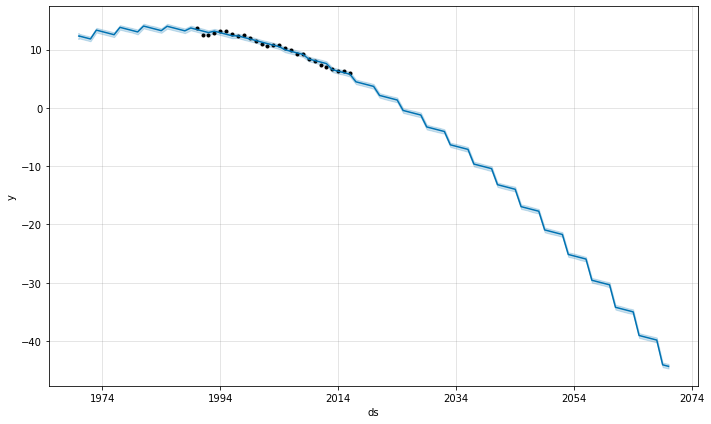

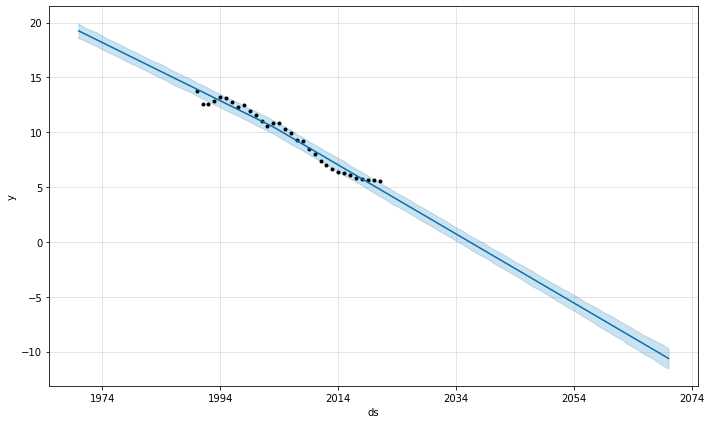

In [ ]:
generate_results_m(aus_data_m, "AUS")

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 20.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/b6v00vw_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/azu75klk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79491', 'data', 'file=/tmp/tmpb7lz_7lg/b6v00vw_.json', 'init=/tmp/tmpb7lz_7lg/azu75klk.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model6rfhkto1/prophet_model-20221130022513.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:25:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmds

|   iter    |  target   | yearly... |
-------------------------------------


02:25:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/iwa0_v16.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/6pb3km1q.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=69116', 'data', 'file=/tmp/tmpb7lz_7lg/iwa0_v16.json', 'init=/tmp/tmpb7lz_7lg/6pb3km1q.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelhc1ik9h5/prophet_model-20221130022514.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:25:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:25:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/voctj7u8.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.7774   | -0.3319   |


02:25:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/p350j6xh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/qbtg4x68.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=33425', 'data', 'file=/tmp/tmpb7lz_7lg/p350j6xh.json', 'init=/tmp/tmpb7lz_7lg/qbtg4x68.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelmbty2fop/prophet_model-20221130022525.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:25:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:25:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/a3vl44a_.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.841    | 0.8813    |


INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/qk2lg_5w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/g9x3n65g.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=3972', 'data', 'file=/tmp/tmpb7lz_7lg/qk2lg_5w.json', 'init=/tmp/tmpb7lz_7lg/g9x3n65g.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model0x634024/prophet_model-20221130022537.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:25:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:25:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/dd_sl99y.json
DEBUG:cmdstanpy:input tempfile: 

| 3         | -0.7237   | -2.0      |


02:25:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/o8752qvk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/99l8zuf0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=75925', 'data', 'file=/tmp/tmpb7lz_7lg/o8752qvk.json', 'init=/tmp/tmpb7lz_7lg/99l8zuf0.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelhh7zh5u8/prophet_model-20221130022550.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:25:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:25:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/t5lvec0x.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.769    | -0.7907   |


02:26:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/mabcgy7y.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/m5e649_t.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=91324', 'data', 'file=/tmp/tmpb7lz_7lg/mabcgy7y.json', 'init=/tmp/tmpb7lz_7lg/m5e649_t.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelybq7v71u/prophet_model-20221130022602.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:26:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:26:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/mq8tuqq2.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.7295   | -1.413    |


02:26:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/it276szi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/xtwktlhu.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=9501', 'data', 'file=/tmp/tmpb7lz_7lg/it276szi.json', 'init=/tmp/tmpb7lz_7lg/xtwktlhu.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model4bugfrkq/prophet_model-20221130022614.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:26:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:26:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/8bzywcpn.json
DEBUG:cmdstanpy:input tempfile: 

| 6         | -0.7294   | -1.631    |


02:26:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/tcnio6fv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/m9m9_btt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=64894', 'data', 'file=/tmp/tmpb7lz_7lg/tcnio6fv.json', 'init=/tmp/tmpb7lz_7lg/m9m9_btt.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelxd7da0om/prophet_model-20221130022625.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:26:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:26:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/nns5hkif.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.7362   | -1.255    |


02:26:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/zf5_xifz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/xq5s6k2u.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79447', 'data', 'file=/tmp/tmpb7lz_7lg/zf5_xifz.json', 'init=/tmp/tmpb7lz_7lg/xq5s6k2u.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model9n2wrg_f/prophet_model-20221130022637.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:26:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:26:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/lo2fdnfj.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.7672   | -0.6178   |


02:26:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/_hzvx_n9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/b2iy9h6y.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=95477', 'data', 'file=/tmp/tmpb7lz_7lg/_hzvx_n9.json', 'init=/tmp/tmpb7lz_7lg/b2iy9h6y.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelbcasf70_/prophet_model-20221130022649.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:26:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:26:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/vlcq8rfc.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -0.7758   | -0.4129   |


02:27:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/u710qtv3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/xgy10nf0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39854', 'data', 'file=/tmp/tmpb7lz_7lg/u710qtv3.json', 'init=/tmp/tmpb7lz_7lg/xgy10nf0.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model_ib22kee/prophet_model-20221130022701.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:27:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:27:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/7fk9dcfg.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -0.808    | 0.1553    |


02:27:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/jmj6uc06.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/cx_g4vx0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=82052', 'data', 'file=/tmp/tmpb7lz_7lg/jmj6uc06.json', 'init=/tmp/tmpb7lz_7lg/cx_g4vx0.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelyczmlqfe/prophet_model-20221130022715.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:27:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:27:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/4yets26f.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -1.013    | 2.0       |


02:27:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/iuvvgjlw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/m50luc6r.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=52949', 'data', 'file=/tmp/tmpb7lz_7lg/iuvvgjlw.json', 'init=/tmp/tmpb7lz_7lg/m50luc6r.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeljz81yprk/prophet_model-20221130022727.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:27:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:27:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ol37crs7.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.7228   | -1.868    |


02:27:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/evu610it.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/6a9fntx0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=96052', 'data', 'file=/tmp/tmpb7lz_7lg/evu610it.json', 'init=/tmp/tmpb7lz_7lg/6a9fntx0.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model1dlfbu80/prophet_model-20221130022738.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:27:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:27:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/yjdp_i8x.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -0.7231   | -1.93     |


02:27:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/jx0na7v8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/1naq7ati.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=33614', 'data', 'file=/tmp/tmpb7lz_7lg/jx0na7v8.json', 'init=/tmp/tmpb7lz_7lg/1naq7ati.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelcgrap0b2/prophet_model-20221130022750.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:27:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:27:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/dl_u7vo8.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -0.7267   | -1.808    |


02:28:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/59lqrf5g.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/3jeo6axj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=50441', 'data', 'file=/tmp/tmpb7lz_7lg/59lqrf5g.json', 'init=/tmp/tmpb7lz_7lg/3jeo6axj.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelwwu5qd4h/prophet_model-20221130022803.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:28:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:28:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/8jrlc7qv.json
DEBUG:cmdstanpy:input tempfile:

|   iter    |  target   | yearly... |
-------------------------------------


02:28:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/d5fuiic5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/tz8oit5l.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=11574', 'data', 'file=/tmp/tmpb7lz_7lg/d5fuiic5.json', 'init=/tmp/tmpb7lz_7lg/tz8oit5l.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelct0l5upc/prophet_model-20221130022816.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:28:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:28:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/b72z0p3c.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.9531   | -0.3319   |


02:28:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/w42c3fkj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/z_bs4e99.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=59509', 'data', 'file=/tmp/tmpb7lz_7lg/w42c3fkj.json', 'init=/tmp/tmpb7lz_7lg/z_bs4e99.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model5mdy607w/prophet_model-20221130022832.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:28:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:28:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/xmqi2s2a.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.9717   | 0.8813    |


02:28:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/nffjqx2h.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/mu_zh1wq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=94526', 'data', 'file=/tmp/tmpb7lz_7lg/nffjqx2h.json', 'init=/tmp/tmpb7lz_7lg/mu_zh1wq.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model1bgqj6fr/prophet_model-20221130022848.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:28:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:28:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/eihb_65k.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -0.918    | -2.0      |


02:29:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/wsmqa7ku.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/_zc51lkd.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84061', 'data', 'file=/tmp/tmpb7lz_7lg/wsmqa7ku.json', 'init=/tmp/tmpb7lz_7lg/_zc51lkd.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeluq51q0ck/prophet_model-20221130022905.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:29:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:29:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/63f8wr7l.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.9473   | -0.7907   |


02:29:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/weorc7xw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/6lx0zfh1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84226', 'data', 'file=/tmp/tmpb7lz_7lg/weorc7xw.json', 'init=/tmp/tmpb7lz_7lg/6lx0zfh1.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelsjonj3y8/prophet_model-20221130022922.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:29:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:29:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/bdev143j.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.9209   | -1.413    |


02:29:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/1gabje1s.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/9qzcxap5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=5301', 'data', 'file=/tmp/tmpb7lz_7lg/1gabje1s.json', 'init=/tmp/tmpb7lz_7lg/9qzcxap5.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model_jon029j/prophet_model-20221130022938.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:29:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:29:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/tleshv51.json
DEBUG:cmdstanpy:input tempfile: 

| 6         | -0.9268   | -1.631    |


02:29:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/4el6ec3l.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/tws7h9pj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7702', 'data', 'file=/tmp/tmpb7lz_7lg/4el6ec3l.json', 'init=/tmp/tmpb7lz_7lg/tws7h9pj.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model_8z3qyp0/prophet_model-20221130022955.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:29:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:29:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/v4d2120t.json
DEBUG:cmdstanpy:input tempfile: 

| 7         | -0.9318   | -1.255    |


02:30:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/msm2b1mi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/xoc4dtvm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=97640', 'data', 'file=/tmp/tmpb7lz_7lg/msm2b1mi.json', 'init=/tmp/tmpb7lz_7lg/xoc4dtvm.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelcuk1h15h/prophet_model-20221130023012.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:30:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:30:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/2hx_147g.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.9484   | -0.6178   |


02:30:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/nrilis37.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/d1olg3ce.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=67332', 'data', 'file=/tmp/tmpb7lz_7lg/nrilis37.json', 'init=/tmp/tmpb7lz_7lg/d1olg3ce.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeliz2zoi6b/prophet_model-20221130023029.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:30:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:30:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/46urhw0i.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -0.9519   | -0.4129   |


02:30:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ytfaggx5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/m5yqq88n.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=28581', 'data', 'file=/tmp/tmpb7lz_7lg/ytfaggx5.json', 'init=/tmp/tmpb7lz_7lg/m5yqq88n.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelwm3jsvvd/prophet_model-20221130023046.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:30:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:30:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/9ogay_lk.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -0.9623   | 0.1553    |


02:31:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ic53d72i.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/golbwnuc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84452', 'data', 'file=/tmp/tmpb7lz_7lg/ic53d72i.json', 'init=/tmp/tmpb7lz_7lg/golbwnuc.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelay5bwli3/prophet_model-20221130023102.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:31:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:31:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/moclx2v_.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -1.106    | 2.0       |


02:31:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/tihl425u.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/qkgwsfnm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=86051', 'data', 'file=/tmp/tmpb7lz_7lg/tihl425u.json', 'init=/tmp/tmpb7lz_7lg/qkgwsfnm.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model2nl_v3o0/prophet_model-20221130023119.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:31:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:31:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/oat9jd9g.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.9164   | -1.912    |


02:31:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/h1735_gv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/1zwe8bdw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=49107', 'data', 'file=/tmp/tmpb7lz_7lg/h1735_gv.json', 'init=/tmp/tmpb7lz_7lg/1zwe8bdw.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelrbk1lqlc/prophet_model-20221130023136.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:31:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:31:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ylaxowdz.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -0.9184   | -1.846    |


INFO:prophet:n_changepoints greater than number of observations. Using 24.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/vzu7mcoq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/c_8rlgyn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=90366', 'data', 'file=/tmp/tmpb7lz_7lg/vzu7mcoq.json', 'init=/tmp/tmpb7lz_7lg/c_8rlgyn.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelbrt8hmfs/prophet_model-20221130023152.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:31:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:31:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/9pglvyeg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/he1h3c0c.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=51188', 'data', 'file=/tmp/tmpb7lz_7lg/9pglvyeg.json', 'init=/tmp/tmpb7lz_7lg/he1h3c0c.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelud_mpfh2/prophet_model-20221130023153.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:31:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:31:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/_0982btg.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -0.9192   | -1.942    |


02:32:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/hxmzxg90.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/gt1fk2wi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84296', 'data', 'file=/tmp/tmpb7lz_7lg/hxmzxg90.json', 'init=/tmp/tmpb7lz_7lg/gt1fk2wi.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model3594afyp/prophet_model-20221130023209.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:32:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:32:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ov547f3_.json
DEBUG:cmdstanpy:input tempfile:

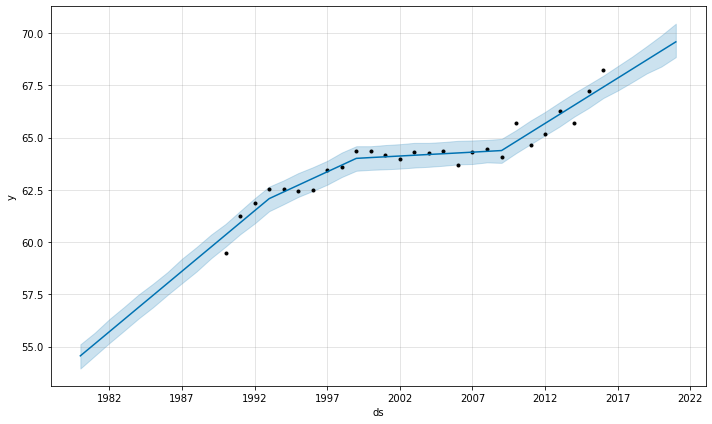

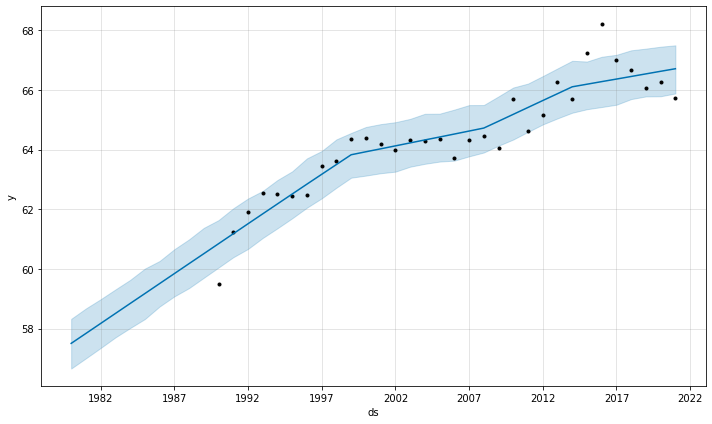

In [ ]:
generate_results_s(aus_data_s, "AUS")

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 20.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/v_i3hyvy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/b3v84x3t.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=64494', 'data', 'file=/tmp/tmppq7tkcfl/v_i3hyvy.json', 'init=/tmp/tmppq7tkcfl/b3v84x3t.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelgi3mhgb4/prophet_model-20221113234214.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:42:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:42:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:c

--------------------Evaluation---------------------
MSE :  0.21485672540715015
MAE :  0.41271432186571033
MAPE :  6.121746091561161
--------------------Evaluation---------------------


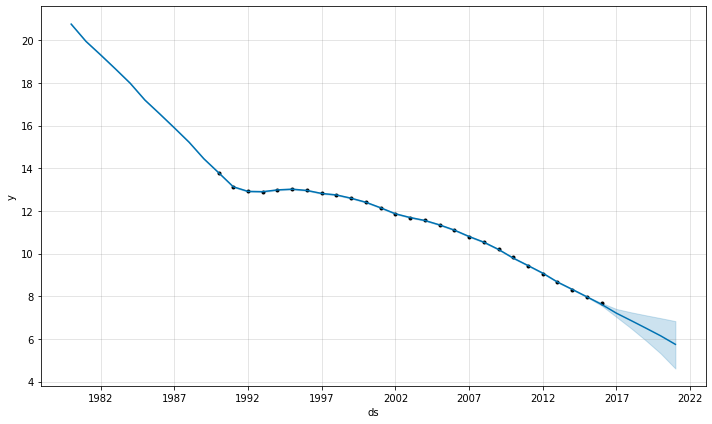

In [ ]:
fit_model_m(aus_data_m)

In [ ]:
optimizer, train_data, test_data = getOpt(aus_data_m)

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 20.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/_y00c59q.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/sccle9p0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79116', 'data', 'file=/tmp/tmppq7tkcfl/_y00c59q.json', 'init=/tmp/tmppq7tkcfl/sccle9p0.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model1_z98ocu/prophet_model-20221113231926.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:19:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmds

|   iter    |  target   | yearly... |
-------------------------------------


23:19:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/t28ql3ja.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/zesaroe1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=95249', 'data', 'file=/tmp/tmppq7tkcfl/t28ql3ja.json', 'init=/tmp/tmppq7tkcfl/zesaroe1.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model2q9jhcwt/prophet_model-20221113231927.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:19:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:19:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/7gv1n801.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.17     | -0.3319   |


23:19:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/jbu1v_bg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/8ci44lgo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=25572', 'data', 'file=/tmp/tmppq7tkcfl/jbu1v_bg.json', 'init=/tmp/tmppq7tkcfl/8ci44lgo.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelb1s4qcxe/prophet_model-20221113231941.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:19:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:19:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/qts1c6dy.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.1357   | 0.8813    |


23:19:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/a_mgzw4g.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/js4p57tv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37425', 'data', 'file=/tmp/tmppq7tkcfl/a_mgzw4g.json', 'init=/tmp/tmppq7tkcfl/js4p57tv.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelhix8d24c/prophet_model-20221113231954.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:19:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:19:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/tcmmd7dz.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -0.1628   | -2.0      |


23:20:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/fz_la32z.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/vvn22pxf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=21932', 'data', 'file=/tmp/tmppq7tkcfl/fz_la32z.json', 'init=/tmp/tmppq7tkcfl/vvn22pxf.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelc3lhia3v/prophet_model-20221113232008.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:20:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:20:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/xzgxiz6y.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.1594   | -0.7907   |


23:20:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/x4jaf2qu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/2wglvi_c.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=58244', 'data', 'file=/tmp/tmppq7tkcfl/x4jaf2qu.json', 'init=/tmp/tmppq7tkcfl/2wglvi_c.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelzfei5tol/prophet_model-20221113232022.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:20:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:20:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/zw97ad_q.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.1641   | -1.413    |


23:20:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/mehc5k6q.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/i_gdvi4q.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=49102', 'data', 'file=/tmp/tmppq7tkcfl/mehc5k6q.json', 'init=/tmp/tmppq7tkcfl/i_gdvi4q.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelts2zr36v/prophet_model-20221113232036.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:20:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:20:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/zfhesiyh.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.1449   | -1.631    |


23:20:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/wii3u3nw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/k_a13j3q.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=93216', 'data', 'file=/tmp/tmppq7tkcfl/wii3u3nw.json', 'init=/tmp/tmppq7tkcfl/k_a13j3q.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelqntcdkmj/prophet_model-20221113232049.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:20:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:20:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/9pv4yyo_.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.1466   | -1.255    |


23:21:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/6x0dfm70.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/a1odl7rt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84437', 'data', 'file=/tmp/tmppq7tkcfl/6x0dfm70.json', 'init=/tmp/tmppq7tkcfl/a1odl7rt.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model0cd2yvyk/prophet_model-20221113232103.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:21:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ld23tfs3.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.1632   | -0.6178   |


23:21:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/xojybrkn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/t2ci3lg6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=56029', 'data', 'file=/tmp/tmppq7tkcfl/xojybrkn.json', 'init=/tmp/tmppq7tkcfl/t2ci3lg6.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelm2n9nq4l/prophet_model-20221113232116.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:21:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/zznevhw6.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -0.1503   | -0.4129   |


23:21:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/y2aqmta8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/3jmj_auk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=33234', 'data', 'file=/tmp/tmppq7tkcfl/y2aqmta8.json', 'init=/tmp/tmppq7tkcfl/3jmj_auk.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeli7qocqob/prophet_model-20221113232130.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:21:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/fz2b9_l2.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -0.1573   | 0.1553    |


23:21:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ju8sypbq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/tgvkp5u9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89576', 'data', 'file=/tmp/tmppq7tkcfl/ju8sypbq.json', 'init=/tmp/tmppq7tkcfl/tgvkp5u9.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modela4bp0_ws/prophet_model-20221113232144.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:21:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/sdlpc9gm.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -0.1284   | 0.8813    |


23:21:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/v3p7970b.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/4zja510k.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=95786', 'data', 'file=/tmp/tmppq7tkcfl/v3p7970b.json', 'init=/tmp/tmppq7tkcfl/4zja510k.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelm3dyucy8/prophet_model-20221113232158.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:21:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:21:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/bwenkgsj.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.1449   | -1.63     |


DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=41739', 'data', 'file=/tmp/tmppq7tkcfl/f14_mvp0.json', 'init=/tmp/tmppq7tkcfl/fcog4jad.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model4t48g8vt/prophet_model-20221113232211.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:22:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:22:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/653qgzdy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/788rfj_f.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=31589', 'data', 'file=/tmp/tmppq7tkcfl/653qgzdy.json', 'init=/tmp/tmppq7tkcfl/788rfj_f.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model_000qjri/prophet_model-20221113232212.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:22:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:22:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/f69oqhte.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -0.1429   | -1.631    |


23:22:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/zmby1dkk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/hqkyydjz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63712', 'data', 'file=/tmp/tmppq7tkcfl/zmby1dkk.json', 'init=/tmp/tmppq7tkcfl/hqkyydjz.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelaeqqaw5c/prophet_model-20221113232227.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:22:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:22:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/qt_cis_r.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -0.1449   | -1.631    |


In [ ]:
test_data

,index,ds,Population_labor_rate,Population_density,Foreign_direct_investment,Air_freight_million_ton_km,Industry_value_added_current_USD,GDP_per_capita_current_USD,Final_consumption,y
27,27,2017,66.606534,2.967956,3.554869,2140.571402,2.964382e+11,52161.456166,8.971664e+11,7.364346
28,28,2018,66.373728,3.012786,3.673061,2122.484328,3.041910e+11,52965.329534,9.252699e+11,7.110167
29,29,2019,66.122487,3.058364,3.534836,2091.874132,3.119283e+11,53270.898494,9.425188e+11,6.870978
30,30,2020,65.862263,3.103422,3.194927,1949.414472,3.161110e+11,53016.650130,9.485070e+11,6.675987
31,31,2021,65.592642,3.103422,3.194927,1949.414472,3.284418e+11,54121.561943,9.770697e+11,6.498632


INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 20.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/enpy7omf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/v9kxkiju.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=83759', 'data', 'file=/tmp/tmppq7tkcfl/enpy7omf.json', 'init=/tmp/tmppq7tkcfl/v9kxkiju.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model4_164wvs/prophet_model-20221113232241.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:22:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmds

  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/yh8h931s.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/9rehcfmb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=50300', 'data', 'file=/tmp/tmppq7tkcfl/yh8h931s.json', 'init=/tmp/tmppq7tkcfl/9rehcfmb.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelelxec5p5/prophet_model-20221113232241.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:22:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:22:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/sl39065k.json
DEBUG:cmdstanpy:input tempfile:

--------------------Evaluation---------------------
MSE :  0.2420219960860026
MAE :  0.4398872326428066
MAPE :  6.521757990906115
--------------------Evaluation---------------------


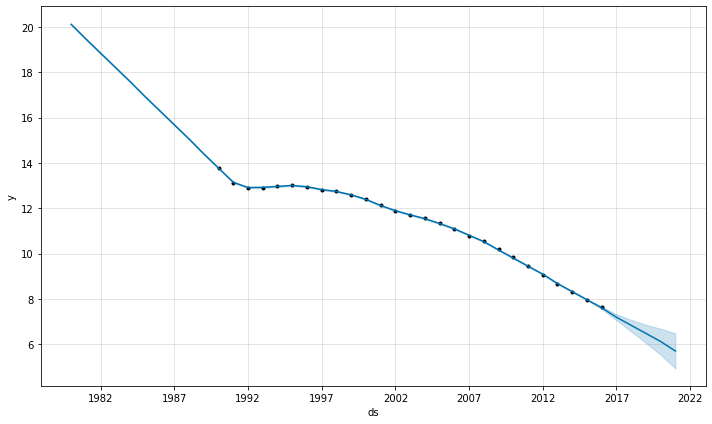

In [ ]:
evaluate_model(optimizer, aus_data_m)

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 20.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/psd4dv55.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/l4j6hf0g.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=26467', 'data', 'file=/tmp/tmppq7tkcfl/psd4dv55.json', 'init=/tmp/tmppq7tkcfl/l4j6hf0g.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelcdfkl_iv/prophet_model-20221114000131.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:01:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:01:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:c

--------------------Evaluation---------------------
MSE :  0.1343541595654732
MAE :  0.3079602044674175
MAPE :  0.46625386414646564
--------------------Evaluation---------------------


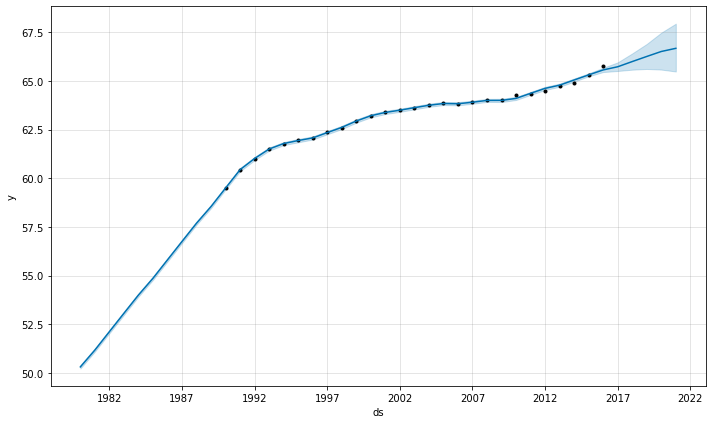

In [ ]:
fit_model_s(aus_data_s)

In [ ]:
optimizer, _, _ = getOpt_s(aus_data_s)

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 20.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/e_nyasy3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/a02ql60g.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=21525', 'data', 'file=/tmp/tmppq7tkcfl/e_nyasy3.json', 'init=/tmp/tmppq7tkcfl/a02ql60g.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelv5dpdiip/prophet_model-20221114000757.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:07:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmds

|   iter    |  target   | yearly... |
-------------------------------------


00:07:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/3frei0b0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/bh9rleq3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=59884', 'data', 'file=/tmp/tmppq7tkcfl/3frei0b0.json', 'init=/tmp/tmppq7tkcfl/bh9rleq3.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeldmvc_qo9/prophet_model-20221114000757.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:07:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:07:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/u4svxzud.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.1661   | -0.3319   |


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ji7f0tjs.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/s73l2sok.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=43696', 'data', 'file=/tmp/tmppq7tkcfl/ji7f0tjs.json', 'init=/tmp/tmppq7tkcfl/s73l2sok.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelb108y718/prophet_model-20221114000810.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:08:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:08:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ycz3leu0.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.1695   | 0.8813    |


00:08:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/d3ydw435.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/8ostfgqd.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=10943', 'data', 'file=/tmp/tmppq7tkcfl/d3ydw435.json', 'init=/tmp/tmppq7tkcfl/8ostfgqd.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelcdo3dacm/prophet_model-20221114000824.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:08:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:08:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/34hoex2k.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -0.1581   | -2.0      |


00:08:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/dfpd5vuc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/jtx0ewqa.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12583', 'data', 'file=/tmp/tmppq7tkcfl/dfpd5vuc.json', 'init=/tmp/tmppq7tkcfl/jtx0ewqa.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modellvoy8n4v/prophet_model-20221114000837.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:08:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:08:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/w46at47k.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.1631   | -0.7907   |


00:08:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/j2uk8pyb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/e0mn45xq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=48674', 'data', 'file=/tmp/tmppq7tkcfl/j2uk8pyb.json', 'init=/tmp/tmppq7tkcfl/e0mn45xq.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelqh0mqjc1/prophet_model-20221114000850.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:08:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:08:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/tcn3gudt.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.1615   | -1.413    |


00:09:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/brzkrbjm.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/g6jg73d3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=15140', 'data', 'file=/tmp/tmppq7tkcfl/brzkrbjm.json', 'init=/tmp/tmppq7tkcfl/g6jg73d3.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelcn5v0d27/prophet_model-20221114000903.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:09:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:09:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/s0i3d1fx.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.1604   | -1.631    |


00:09:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/jnf48eor.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/yuluxaui.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=76534', 'data', 'file=/tmp/tmppq7tkcfl/jnf48eor.json', 'init=/tmp/tmppq7tkcfl/yuluxaui.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model9s33irtw/prophet_model-20221114000916.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:09:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:09:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/2czhsqjj.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.1621   | -1.255    |


00:09:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/t9scj9z5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/tpmnp12c.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=61486', 'data', 'file=/tmp/tmppq7tkcfl/t9scj9z5.json', 'init=/tmp/tmppq7tkcfl/tpmnp12c.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelj5mz0cvm/prophet_model-20221114000929.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:09:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:09:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/hipn8hyq.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.1639   | -0.6178   |


INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/7ehn7lhg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/_tkrsp42.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73779', 'data', 'file=/tmp/tmppq7tkcfl/7ehn7lhg.json', 'init=/tmp/tmppq7tkcfl/_tkrsp42.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelbl9hdmnw/prophet_model-20221114000942.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:09:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:09:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/qiz9lm4l.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -0.1654   | -0.4129   |


INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/nfu2vs1k.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/zpfw33g2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=78764', 'data', 'file=/tmp/tmppq7tkcfl/nfu2vs1k.json', 'init=/tmp/tmppq7tkcfl/zpfw33g2.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelpd64u24m/prophet_model-20221114000956.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:09:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:09:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/wa8cavn1.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -0.1692   | 0.1553    |


00:10:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/5tet2d1j.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/xdobch4z.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=81981', 'data', 'file=/tmp/tmppq7tkcfl/5tet2d1j.json', 'init=/tmp/tmppq7tkcfl/xdobch4z.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelvzwm9553/prophet_model-20221114001009.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:10:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:10:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/9yq1go6n.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -0.1581   | -2.0      |
| 12        | -0.1581   | -2.0      |
| 13        | -0.1581   | -2.0      |
| 14        | -0.1581   | -2.0      |


INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 20.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/f5c4kfqi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/7z5gq6o7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=47937', 'data', 'file=/tmp/tmppq7tkcfl/f5c4kfqi.json', 'init=/tmp/tmppq7tkcfl/7z5gq6o7.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model3_jyutuw/prophet_model-20221114001022.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:10:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmds

  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/cot6gzp4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/iy0zjjp3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=38190', 'data', 'file=/tmp/tmppq7tkcfl/cot6gzp4.json', 'init=/tmp/tmppq7tkcfl/iy0zjjp3.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeldgtga24_/prophet_model-20221114001022.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:10:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:10:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/s6krjba0.json
DEBUG:cmdstanpy:input tempfile:

--------------------Evaluation---------------------
MSE :  0.14335426652764766
MAE :  0.3028558163647347
MAPE :  0.4585123193898625
--------------------Evaluation---------------------


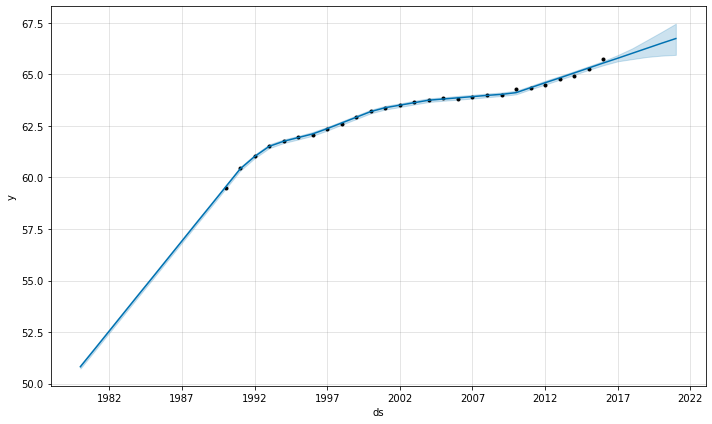

In [ ]:
evaluate_model_s(optimizer, aus_data_s)

## Brazil

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/tlh06chh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/y5fbm20w.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=51312', 'data', 'file=/tmp/tmpb7lz_7lg/tlh06chh.json', 'init=/tmp/tmpb7lz_7lg/y5fbm20w.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelndavte1i/prophet_model-20221130023229.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:32:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing


|   iter    |  target   | yearly... |
-------------------------------------


02:32:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/bthxjcv7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/tncchvth.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=58152', 'data', 'file=/tmp/tmpb7lz_7lg/bthxjcv7.json', 'init=/tmp/tmpb7lz_7lg/tncchvth.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model8tiw42d0/prophet_model-20221130023229.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:32:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:32:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ir9w32qn.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -4.386    | -0.3319   |


02:32:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/5kdfq5ol.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/6jiezh5e.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=96739', 'data', 'file=/tmp/tmpb7lz_7lg/5kdfq5ol.json', 'init=/tmp/tmpb7lz_7lg/6jiezh5e.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model72373lak/prophet_model-20221130023249.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:32:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:32:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/lve57su7.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -4.113    | 0.8813    |


02:33:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/cf3afu3e.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/8z29f8p8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=75713', 'data', 'file=/tmp/tmpb7lz_7lg/cf3afu3e.json', 'init=/tmp/tmpb7lz_7lg/8z29f8p8.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model1aj7yryg/prophet_model-20221130023309.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:33:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:33:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/fqtjqkbk.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -4.392    | -2.0      |


02:33:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/se3wj9kd.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/kkm4jnyg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=16524', 'data', 'file=/tmp/tmpb7lz_7lg/se3wj9kd.json', 'init=/tmp/tmpb7lz_7lg/kkm4jnyg.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model_wrlqf7m/prophet_model-20221130023329.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:33:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:33:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/umv5k6nv.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -4.39     | -0.7907   |


02:33:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/gnpv9_iy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/vtlaenu6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7407', 'data', 'file=/tmp/tmpb7lz_7lg/gnpv9_iy.json', 'init=/tmp/tmpb7lz_7lg/vtlaenu6.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeldrtz9_yg/prophet_model-20221130023350.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:33:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:33:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/riqryth0.json
DEBUG:cmdstanpy:input tempfile: 

| 5         | -4.385    | -1.413    |


02:34:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/xs8mr047.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/2s4svqaf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=5145', 'data', 'file=/tmp/tmpb7lz_7lg/xs8mr047.json', 'init=/tmp/tmpb7lz_7lg/2s4svqaf.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeltsqbcyia/prophet_model-20221130023410.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:34:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:34:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/7du_0mbx.json
DEBUG:cmdstanpy:input tempfile: 

| 6         | -4.386    | -1.631    |


02:34:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/xs8z2gi6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/4xoxkwvl.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=1361', 'data', 'file=/tmp/tmpb7lz_7lg/xs8z2gi6.json', 'init=/tmp/tmpb7lz_7lg/4xoxkwvl.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelpmfpvr4l/prophet_model-20221130023429.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:34:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:34:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/vwj9d617.json
DEBUG:cmdstanpy:input tempfile: 

| 7         | -4.389    | -1.255    |


02:34:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/w7r32adu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ootmb7s8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=3175', 'data', 'file=/tmp/tmpb7lz_7lg/w7r32adu.json', 'init=/tmp/tmpb7lz_7lg/ootmb7s8.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelsobk811z/prophet_model-20221130023449.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:34:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:34:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/b57090nz.json
DEBUG:cmdstanpy:input tempfile: 

| 8         | -4.39     | -0.6178   |


02:35:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/cxbqcnqz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/vf7exim3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=93914', 'data', 'file=/tmp/tmpb7lz_7lg/cxbqcnqz.json', 'init=/tmp/tmpb7lz_7lg/vf7exim3.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelbtqdeqy5/prophet_model-20221130023509.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:35:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:35:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/imn_3m0o.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -4.388    | -0.4129   |


02:35:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ylwbbraz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/n25fsc3u.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7962', 'data', 'file=/tmp/tmpb7lz_7lg/ylwbbraz.json', 'init=/tmp/tmpb7lz_7lg/n25fsc3u.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model4pm4f5a6/prophet_model-20221130023529.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:35:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:35:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/lskzdk84.json
DEBUG:cmdstanpy:input tempfile: 

| 10        | -4.367    | 0.1553    |


02:35:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/9hpwi2oz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/5qkpnmfs.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=76621', 'data', 'file=/tmp/tmpb7lz_7lg/9hpwi2oz.json', 'init=/tmp/tmpb7lz_7lg/5qkpnmfs.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelgpeac0ks/prophet_model-20221130023550.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:35:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:35:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/_p82jfpq.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -3.956    | 1.414     |


02:36:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/n3hvh3g2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/x22s9rtk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=58111', 'data', 'file=/tmp/tmpb7lz_7lg/n3hvh3g2.json', 'init=/tmp/tmpb7lz_7lg/x22s9rtk.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model183pctt9/prophet_model-20221130023611.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:36:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:36:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ajdlncn7.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -4.278    | 2.0       |


DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ao2qqpg7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/3grd5nr4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=45059', 'data', 'file=/tmp/tmpb7lz_7lg/ao2qqpg7.json', 'init=/tmp/tmpb7lz_7lg/3grd5nr4.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelyxft8k3c/prophet_model-20221130023631.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:36:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:36:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/b6bqy806.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/wp104vbc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=59406', 'data', 'file=/tmp/tmpb7lz_7lg/b6bqy806.json', 'init=/tmp/tmpb7lz_7lg/wp104vbc.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model3u5ar8v0/prophet_model-20221130023631.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:36:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:36:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/nezgocns.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -3.958    | 1.262     |


02:36:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ggm4c39m.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/4zl65vea.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57975', 'data', 'file=/tmp/tmpb7lz_7lg/ggm4c39m.json', 'init=/tmp/tmpb7lz_7lg/4zl65vea.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeld2w0sdhl/prophet_model-20221130023651.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:36:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:36:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/0bxhxi63.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -3.945    | 1.343     |


INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/602bd1wg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/6h4msm26.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=77564', 'data', 'file=/tmp/tmpb7lz_7lg/602bd1wg.json', 'init=/tmp/tmpb7lz_7lg/6h4msm26.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelu8f7ghjb/prophet_model-20221130023713.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:37:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:37:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/lkb45nq6.json
DEBUG:cmdstanpy:input tempfile:

Index(['ds', 'trend', 'yhat_lower', 'yhat_upper', 'trend_lower', 'trend_upper',
       'additive_terms', 'additive_terms_lower', 'additive_terms_upper',
       'yearly', 'yearly_lower', 'yearly_upper', 'multiplicative_terms',
       'multiplicative_terms_lower', 'multiplicative_terms_upper', 'yhat'],
      dtype='object')
|   iter    |  target   | yearly... |
-------------------------------------


02:37:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/qcpe_xg6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/_pn0chv3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=28696', 'data', 'file=/tmp/tmpb7lz_7lg/qcpe_xg6.json', 'init=/tmp/tmpb7lz_7lg/_pn0chv3.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model6sfqesv7/prophet_model-20221130023734.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:37:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:37:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/q2vv5xwz.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -4.403    | -0.3319   |


02:37:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/r_fsgrub.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/nbj8rq7c.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=18179', 'data', 'file=/tmp/tmpb7lz_7lg/r_fsgrub.json', 'init=/tmp/tmpb7lz_7lg/nbj8rq7c.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelouh_63iu/prophet_model-20221130023759.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:37:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:37:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/dno84atb.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -3.803    | 0.8813    |


02:38:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/v04ifxv9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/051p5hi8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7459', 'data', 'file=/tmp/tmpb7lz_7lg/v04ifxv9.json', 'init=/tmp/tmpb7lz_7lg/051p5hi8.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelt711a9tu/prophet_model-20221130023823.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:38:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:38:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/p0b5h6an.json
DEBUG:cmdstanpy:input tempfile: 

| 3         | -4.376    | -2.0      |


02:38:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/a73m_mw2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/zxrxxl8q.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73237', 'data', 'file=/tmp/tmpb7lz_7lg/a73m_mw2.json', 'init=/tmp/tmpb7lz_7lg/zxrxxl8q.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model3enqty1h/prophet_model-20221130023848.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:38:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:38:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/wfhy9480.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -4.392    | -0.7907   |


02:39:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/mz7bc4tm.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/y5ievy5v.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=27377', 'data', 'file=/tmp/tmpb7lz_7lg/mz7bc4tm.json', 'init=/tmp/tmpb7lz_7lg/y5ievy5v.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelu47ro87s/prophet_model-20221130023914.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:39:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:39:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/osibh2pd.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -4.371    | -1.413    |


02:39:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/rar4ukl6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/9b1x2tye.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=29558', 'data', 'file=/tmp/tmpb7lz_7lg/rar4ukl6.json', 'init=/tmp/tmpb7lz_7lg/9b1x2tye.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelht_6tg9b/prophet_model-20221130023939.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:39:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:39:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/tfzks6il.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -4.378    | -1.631    |


02:40:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/04uxgjm6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/6d83mgg3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70244', 'data', 'file=/tmp/tmpb7lz_7lg/04uxgjm6.json', 'init=/tmp/tmpb7lz_7lg/6d83mgg3.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelyuvbx8bp/prophet_model-20221130024004.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:40:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:40:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/caqddob_.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -4.374    | -1.255    |


02:40:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/gj9rtzt6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/br2kv2as.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=21464', 'data', 'file=/tmp/tmpb7lz_7lg/gj9rtzt6.json', 'init=/tmp/tmpb7lz_7lg/br2kv2as.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelr_tqr5x1/prophet_model-20221130024030.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:40:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:40:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/_58e0im0.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -4.339    | -0.6178   |


02:40:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/27mvfe22.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/mm1n8mag.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=47059', 'data', 'file=/tmp/tmpb7lz_7lg/27mvfe22.json', 'init=/tmp/tmpb7lz_7lg/mm1n8mag.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model908ji_wy/prophet_model-20221130024055.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:40:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:40:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/0wgg037q.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -4.334    | -0.4129   |


02:41:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/91m14q0r.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/rw19k4xf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=41913', 'data', 'file=/tmp/tmpb7lz_7lg/91m14q0r.json', 'init=/tmp/tmpb7lz_7lg/rw19k4xf.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelycj_e_o3/prophet_model-20221130024120.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:41:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:41:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ltoc7k2_.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -4.305    | 0.1553    |


02:41:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/0bth9cyp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/5m1pcjox.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=35466', 'data', 'file=/tmp/tmpb7lz_7lg/0bth9cyp.json', 'init=/tmp/tmpb7lz_7lg/5m1pcjox.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelykzomxgf/prophet_model-20221130024146.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:41:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:41:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/j4otmlcs.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -3.687    | 1.118     |


02:42:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/arzmvzxh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/2fyxykkt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=48184', 'data', 'file=/tmp/tmpb7lz_7lg/arzmvzxh.json', 'init=/tmp/tmpb7lz_7lg/2fyxykkt.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelipmmgzdf/prophet_model-20221130024211.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:42:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:42:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/u2sxum7w.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -3.676    | 1.527     |


02:42:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/6j29xtqw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/kj6zuyk2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53785', 'data', 'file=/tmp/tmpb7lz_7lg/6j29xtqw.json', 'init=/tmp/tmpb7lz_7lg/kj6zuyk2.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelgu4_1roc/prophet_model-20221130024238.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:42:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:42:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/1m2qryeo.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -3.968    | 2.0       |


02:43:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/pqktxgj7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/vajpgq_t.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=15353', 'data', 'file=/tmp/tmpb7lz_7lg/pqktxgj7.json', 'init=/tmp/tmpb7lz_7lg/vajpgq_t.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelvzuu00lo/prophet_model-20221130024302.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:43:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:43:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/hde0siet.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -3.968    | 2.0       |


02:43:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ysyt5r6g.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/07r5oha8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=5982', 'data', 'file=/tmp/tmpb7lz_7lg/ysyt5r6g.json', 'init=/tmp/tmpb7lz_7lg/07r5oha8.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model_tqkeg1f/prophet_model-20221130024328.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:43:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:43:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/76vtjl3e.json
DEBUG:cmdstanpy:input tempfile: 

Index(['ds', 'trend', 'yhat_lower', 'yhat_upper', 'trend_lower', 'trend_upper',
       'additive_terms', 'additive_terms_lower', 'additive_terms_upper',
       'yearly', 'yearly_lower', 'yearly_upper', 'multiplicative_terms',
       'multiplicative_terms_lower', 'multiplicative_terms_upper', 'yhat'],
      dtype='object')


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:70: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:78: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/vdkd7zoz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/muwbi0br.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=93733', 'data', 'file=/tmp/tmpb7lz_7lg/vdkd7zoz.json', 'init=/tmp/tmpb7lz_7lg/muwbi0br.json', 'o

|   iter    |  target   | yearly... |
-------------------------------------


02:43:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/_jkmtuwo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/uhcltx77.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=21212', 'data', 'file=/tmp/tmpb7lz_7lg/_jkmtuwo.json', 'init=/tmp/tmpb7lz_7lg/uhcltx77.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelpfw9dnot/prophet_model-20221130024355.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:43:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:43:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/tmfdrdv5.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -7.802    | -0.3319   |


02:44:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/xburvmua.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/9ug_k3sa.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=1466', 'data', 'file=/tmp/tmpb7lz_7lg/xburvmua.json', 'init=/tmp/tmpb7lz_7lg/9ug_k3sa.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model4piu591f/prophet_model-20221130024416.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:44:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:44:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/y5ykldd4.json
DEBUG:cmdstanpy:input tempfile: 

| 2         | -7.263    | 0.8813    |


02:44:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ad80epxa.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/28jhnfyq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=62622', 'data', 'file=/tmp/tmpb7lz_7lg/ad80epxa.json', 'init=/tmp/tmpb7lz_7lg/28jhnfyq.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelj5uotcgm/prophet_model-20221130024437.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:44:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:44:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/wuyrfrwm.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -7.811    | -2.0      |


02:44:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ptmnkbvz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/9u4s6h0y.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=72858', 'data', 'file=/tmp/tmpb7lz_7lg/ptmnkbvz.json', 'init=/tmp/tmpb7lz_7lg/9u4s6h0y.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelkytaw1im/prophet_model-20221130024458.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:44:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:44:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/393t2bov.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -7.813    | -0.7907   |


02:45:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/oznigciw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/k6anc3cl.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=93019', 'data', 'file=/tmp/tmpb7lz_7lg/oznigciw.json', 'init=/tmp/tmpb7lz_7lg/k6anc3cl.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelx3xtkke8/prophet_model-20221130024520.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:45:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:45:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/pjcl78ur.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -7.811    | -1.413    |


02:45:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/kparz5tx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ggmyb3ts.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=25145', 'data', 'file=/tmp/tmpb7lz_7lg/kparz5tx.json', 'init=/tmp/tmpb7lz_7lg/ggmyb3ts.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model1tycm23w/prophet_model-20221130024541.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:45:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:45:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/on2nxku6.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -7.808    | -1.631    |


02:46:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/lp5d42vc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ogtx40nc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=44783', 'data', 'file=/tmp/tmpb7lz_7lg/lp5d42vc.json', 'init=/tmp/tmpb7lz_7lg/ogtx40nc.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeli20v_5fg/prophet_model-20221130024604.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:46:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:46:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/8p__w__q.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -7.803    | -1.255    |


02:46:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/wt8cpd_6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/6wvwhfvk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=56971', 'data', 'file=/tmp/tmpb7lz_7lg/wt8cpd_6.json', 'init=/tmp/tmpb7lz_7lg/6wvwhfvk.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model_2ismftl/prophet_model-20221130024625.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:46:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:46:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/mpvbota4.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -7.802    | -0.6178   |


02:46:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/vum6m6rf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/7g6u0j6k.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=30930', 'data', 'file=/tmp/tmpb7lz_7lg/vum6m6rf.json', 'init=/tmp/tmpb7lz_7lg/7g6u0j6k.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelbmk7jfu9/prophet_model-20221130024646.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:46:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:46:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/hlp5dwfh.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -7.81     | -0.4129   |


02:47:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/m2ijgxve.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/j8hse_06.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=64728', 'data', 'file=/tmp/tmpb7lz_7lg/m2ijgxve.json', 'init=/tmp/tmpb7lz_7lg/j8hse_06.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelq_ik5gy6/prophet_model-20221130024709.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:47:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:47:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/n2k9cv4j.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -7.751    | 0.1553    |


DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37421', 'data', 'file=/tmp/tmpb7lz_7lg/g5ndsoun.json', 'init=/tmp/tmpb7lz_7lg/80885or3.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model7xynl192/prophet_model-20221130024730.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:47:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:47:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/sx65aik0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/kqspqjqw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73838', 'data', 'file=/tmp/tmpb7lz_7lg/sx65aik0.json', 'init=/tmp/tmpb7lz_7lg/kqspqjqw.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelr876g39k/prophet_model-20221130024730.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:47:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:47:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/7u0eu_f7.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -7.072    | 1.308     |


02:47:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/zm0l0kqm.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/8d20psmn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=92524', 'data', 'file=/tmp/tmpb7lz_7lg/zm0l0kqm.json', 'init=/tmp/tmpb7lz_7lg/8d20psmn.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelmrfsyfub/prophet_model-20221130024752.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:47:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:47:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/zfqumhcl.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -7.388    | 2.0       |


02:48:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/pfvc1_9q.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/jz2sjhki.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99750', 'data', 'file=/tmp/tmpb7lz_7lg/pfvc1_9q.json', 'init=/tmp/tmpb7lz_7lg/jz2sjhki.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelex11s16d/prophet_model-20221130024813.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:48:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:48:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/l_z0gfuj.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -7.111    | 1.497     |


02:48:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/d5sa9ma7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/xfnbn_3g.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=58091', 'data', 'file=/tmp/tmpb7lz_7lg/d5sa9ma7.json', 'init=/tmp/tmpb7lz_7lg/xfnbn_3g.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modela2wzmgiw/prophet_model-20221130024835.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:48:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:48:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/yrfz8lke.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -7.091    | 1.22      |


02:48:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/wwq605x7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/8u6iq2ak.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=69559', 'data', 'file=/tmp/tmpb7lz_7lg/wwq605x7.json', 'init=/tmp/tmpb7lz_7lg/8u6iq2ak.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelhpop2iln/prophet_model-20221130024856.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:48:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:48:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/371ebrt_.json
DEBUG:cmdstanpy:input tempfile:

|   iter    |  target   | yearly... |
-------------------------------------


02:49:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/psymjz6w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/xvxrewks.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=30671', 'data', 'file=/tmp/tmpb7lz_7lg/psymjz6w.json', 'init=/tmp/tmpb7lz_7lg/xvxrewks.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelb_3n1zqv/prophet_model-20221130024919.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:49:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:49:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/xg1x8x2s.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -7.226    | -0.3319   |


02:49:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/mjlv4f7o.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/mglvfybr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99013', 'data', 'file=/tmp/tmpb7lz_7lg/mjlv4f7o.json', 'init=/tmp/tmpb7lz_7lg/mglvfybr.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelmpsqc3fr/prophet_model-20221130024945.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:49:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:49:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/wlm0l9zm.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -6.788    | 0.8813    |


02:50:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/6g7o5y1z.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/hx9naacv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=16717', 'data', 'file=/tmp/tmpb7lz_7lg/6g7o5y1z.json', 'init=/tmp/tmpb7lz_7lg/hx9naacv.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelw5587l7_/prophet_model-20221130025011.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:50:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:50:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/azti414x.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -7.281    | -2.0      |


02:50:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/_eg1bpg8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/si0zgxk1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=33179', 'data', 'file=/tmp/tmpb7lz_7lg/_eg1bpg8.json', 'init=/tmp/tmpb7lz_7lg/si0zgxk1.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelt95e2kgk/prophet_model-20221130025038.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:50:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:50:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/acce6wyx.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -7.238    | -0.7907   |


02:51:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/085czvv7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/mf499ceb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=76840', 'data', 'file=/tmp/tmpb7lz_7lg/085czvv7.json', 'init=/tmp/tmpb7lz_7lg/mf499ceb.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelc1it08ro/prophet_model-20221130025104.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:51:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:51:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/xxsv7hxg.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -7.283    | -1.413    |


02:51:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/c_xzf3_h.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/hg976fvw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89825', 'data', 'file=/tmp/tmpb7lz_7lg/c_xzf3_h.json', 'init=/tmp/tmpb7lz_7lg/hg976fvw.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model03c87epf/prophet_model-20221130025130.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:51:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:51:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/qw2ci3se.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -7.28     | -1.631    |


02:51:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/uiwe_lij.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/v9u_fi9k.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=35857', 'data', 'file=/tmp/tmpb7lz_7lg/uiwe_lij.json', 'init=/tmp/tmpb7lz_7lg/v9u_fi9k.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modell1mt81fb/prophet_model-20221130025157.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:51:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:51:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/kimwwrzo.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -7.233    | -1.255    |


02:52:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/6sry3dzy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/bubjfwjj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=50464', 'data', 'file=/tmp/tmpb7lz_7lg/6sry3dzy.json', 'init=/tmp/tmpb7lz_7lg/bubjfwjj.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modely74co5rj/prophet_model-20221130025224.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:52:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:52:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/fe6p613q.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -7.217    | -0.6178   |


02:52:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/jv4vzmm7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/t_2y8q1r.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=64444', 'data', 'file=/tmp/tmpb7lz_7lg/jv4vzmm7.json', 'init=/tmp/tmpb7lz_7lg/t_2y8q1r.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model8misw0x1/prophet_model-20221130025251.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:52:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:52:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/y0ztl30c.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -7.275    | -0.4129   |


02:53:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ytpfw4ho.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/zh0lcumw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=10249', 'data', 'file=/tmp/tmpb7lz_7lg/ytpfw4ho.json', 'init=/tmp/tmpb7lz_7lg/zh0lcumw.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelwtlyoigg/prophet_model-20221130025318.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:53:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:53:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/mu7k2qrs.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -7.153    | 0.1553    |


INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/1qnfjua5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/255dsf09.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=38596', 'data', 'file=/tmp/tmpb7lz_7lg/1qnfjua5.json', 'init=/tmp/tmpb7lz_7lg/255dsf09.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelpc_rh1oz/prophet_model-20221130025346.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:53:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:53:46 - cmdstanpy - INFO - Chain [1] do

  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/2su7htw9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/x50c9xgv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=92794', 'data', 'file=/tmp/tmpb7lz_7lg/2su7htw9.json', 'init=/tmp/tmpb7lz_7lg/x50c9xgv.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeltxd86ffx/prophet_model-20221130025346.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:53:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:53:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/a3lxd87_.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -6.771    | 1.067     |


02:54:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/7cgl_0hj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/l5yu5bl1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=97928', 'data', 'file=/tmp/tmpb7lz_7lg/7cgl_0hj.json', 'init=/tmp/tmpb7lz_7lg/l5yu5bl1.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model2sv_7ft9/prophet_model-20221130025413.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:54:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:54:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/w7tucbtu.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -6.79     | 1.419     |


DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36171', 'data', 'file=/tmp/tmpb7lz_7lg/k9whrkh8.json', 'init=/tmp/tmpb7lz_7lg/yip7hibd.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model_u_vtv7u/prophet_model-20221130025439.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:54:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:54:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/uylbiasb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/7wzgzpgk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=78448', 'data', 'file=/tmp/tmpb7lz_7lg/uylbiasb.json', 'init=/tmp/tmpb7lz_7lg/7wzgzpgk.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model6ufzpdzv/prophet_model-20221130025440.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:54:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:54:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/4oej6dou.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -6.997    | 1.859     |


02:55:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ouf1w52j.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/3tp7wdo5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70781', 'data', 'file=/tmp/tmpb7lz_7lg/ouf1w52j.json', 'init=/tmp/tmpb7lz_7lg/3tp7wdo5.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelsop4hx7n/prophet_model-20221130025506.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:55:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:55:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/3fx147xl.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -6.788    | 0.8813    |


02:55:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/asjct25i.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/qm_1ec2x.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7748', 'data', 'file=/tmp/tmpb7lz_7lg/asjct25i.json', 'init=/tmp/tmpb7lz_7lg/qm_1ec2x.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelajoi8d3i/prophet_model-20221130025533.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:55:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:55:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/011prh05.json
DEBUG:cmdstanpy:input tempfile: 

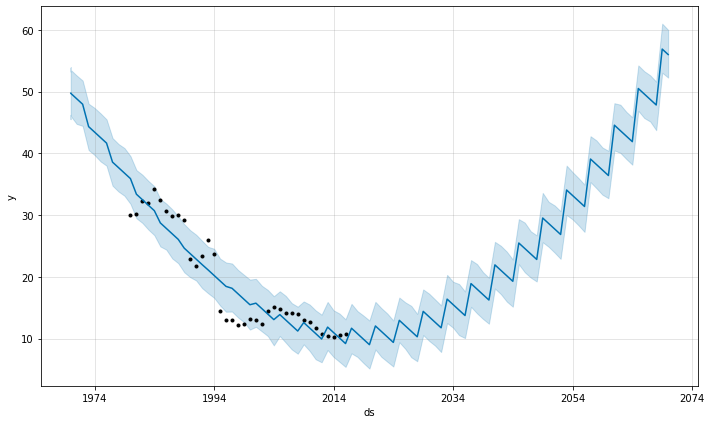

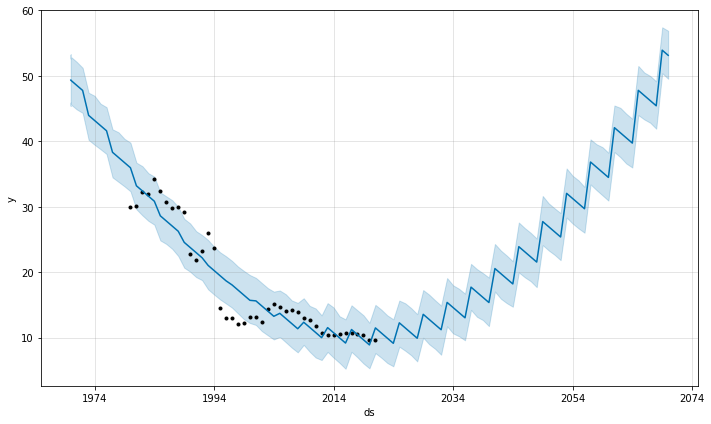

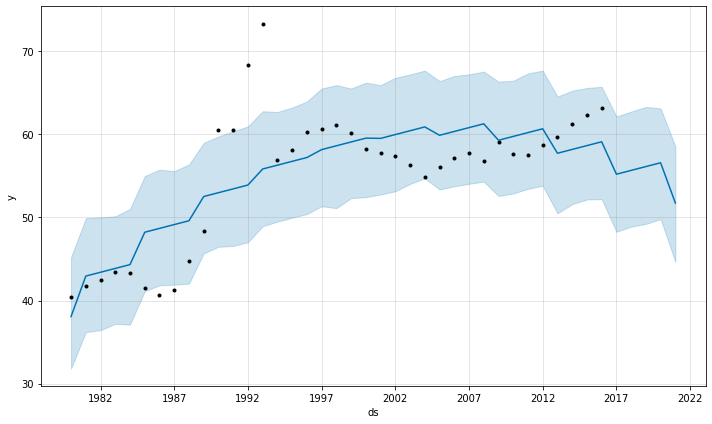

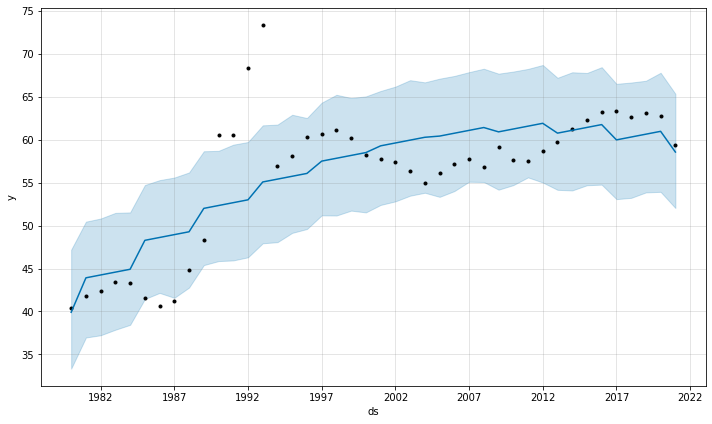

In [ ]:
generate_results_m(bra_data_m, "BRA")
generate_results_s(bra_data_s, "BRA")

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/ne5x63zg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/92zh964k.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=75026', 'data', 'file=/tmp/tmpjad4h45l/ne5x63zg.json', 'init=/tmp/tmpjad4h45l/92zh964k.json', 'output', 'file=/tmp/tmpjad4h45l/prophet_modelyg7fs899/prophet_model-20221022001109.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:11:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:11:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


--------------------Evaluation---------------------
MSE :  12.941316614647576
MAE :  3.5424687569059268
MAPE :  31.416848603484407
--------------------Evaluation---------------------


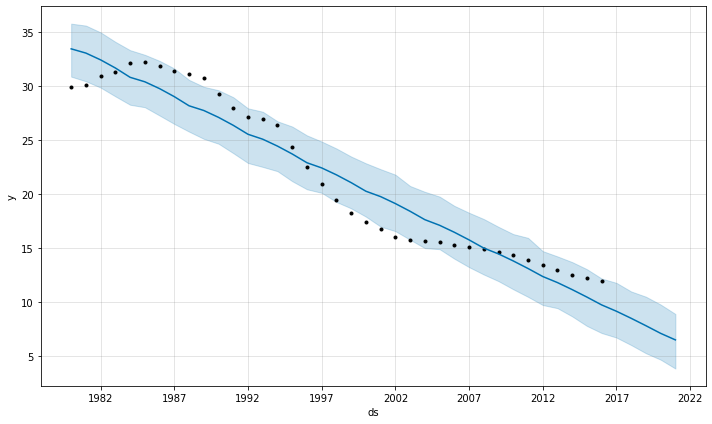

In [ ]:
fit_model_m(bra_data_m)

In [ ]:
optimizer, _, _ = getOpt(bra_data_m)

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/_jn72wpf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/3f5kd5xo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=55499', 'data', 'file=/tmp/tmppq7tkcfl/_jn72wpf.json', 'init=/tmp/tmppq7tkcfl/3f5kd5xo.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelvxlbp3xx/prophet_model-20221113232756.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:27:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing


|   iter    |  target   | yearly... |
-------------------------------------


23:27:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/bkhg1e0x.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/z4ytio0i.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=30384', 'data', 'file=/tmp/tmppq7tkcfl/bkhg1e0x.json', 'init=/tmp/tmppq7tkcfl/z4ytio0i.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model0cbf0cwc/prophet_model-20221113232756.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:27:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:27:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/c751pmdz.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -2.02     | -0.3319   |


23:28:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/h7kmwzi2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/6jdk0uhr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37015', 'data', 'file=/tmp/tmppq7tkcfl/h7kmwzi2.json', 'init=/tmp/tmppq7tkcfl/6jdk0uhr.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelhzg2_mx0/prophet_model-20221113232819.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:28:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:28:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/45s3ec40.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -2.035    | 0.8813    |


23:28:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ynfvr0zy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ckf5m35m.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=43505', 'data', 'file=/tmp/tmppq7tkcfl/ynfvr0zy.json', 'init=/tmp/tmppq7tkcfl/ckf5m35m.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model30mkrdme/prophet_model-20221113232840.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:28:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:28:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/6h29zjoa.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -2.233    | -2.0      |


23:29:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/42bpdbf2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/1h8mkb0b.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=55904', 'data', 'file=/tmp/tmppq7tkcfl/42bpdbf2.json', 'init=/tmp/tmppq7tkcfl/1h8mkb0b.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelr7ak8sfi/prophet_model-20221113232905.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:29:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:29:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/hppq832r.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -2.008    | -0.7907   |


23:29:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/5b_otewa.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/7bbzjo16.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=29513', 'data', 'file=/tmp/tmppq7tkcfl/5b_otewa.json', 'init=/tmp/tmppq7tkcfl/7bbzjo16.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model0sw26f9l/prophet_model-20221113232927.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:29:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:29:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/43xizkf3.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -1.998    | -1.413    |


23:29:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/wxc0134z.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ckyjr5xa.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=24925', 'data', 'file=/tmp/tmppq7tkcfl/wxc0134z.json', 'init=/tmp/tmppq7tkcfl/ckyjr5xa.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelq2kz1vap/prophet_model-20221113232950.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:29:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:29:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ohmi4cbu.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -1.878    | -1.631    |


23:30:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/hppbgjew.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/uuoggjxd.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53686', 'data', 'file=/tmp/tmppq7tkcfl/hppbgjew.json', 'init=/tmp/tmppq7tkcfl/uuoggjxd.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelaiw0i807/prophet_model-20221113233012.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:30:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:30:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/nlqv1tx3.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -2.141    | -1.255    |


23:30:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/9xpbiupx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/jemsmt5o.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=83014', 'data', 'file=/tmp/tmppq7tkcfl/9xpbiupx.json', 'init=/tmp/tmppq7tkcfl/jemsmt5o.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelk3mv57ay/prophet_model-20221113233035.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:30:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:30:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/bzob9swv.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -2.011    | -0.6178   |


23:30:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/k27iwj6r.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/zx84gu82.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=77430', 'data', 'file=/tmp/tmppq7tkcfl/k27iwj6r.json', 'init=/tmp/tmppq7tkcfl/zx84gu82.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelml8t3b1a/prophet_model-20221113233057.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:30:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:30:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/u1w_3o2q.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -1.963    | -0.4129   |


23:31:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/migve0dd.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/zx0jny2p.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60104', 'data', 'file=/tmp/tmppq7tkcfl/migve0dd.json', 'init=/tmp/tmppq7tkcfl/zx0jny2p.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelsfv4x7ht/prophet_model-20221113233120.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:31:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:31:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/vx9oy70u.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -2.055    | 0.1553    |


23:31:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/4v73ywa9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/scri2yfu.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=56697', 'data', 'file=/tmp/tmppq7tkcfl/4v73ywa9.json', 'init=/tmp/tmppq7tkcfl/scri2yfu.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelt6ui2adn/prophet_model-20221113233143.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:31:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:31:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/aqz2nxhg.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -1.963    | -1.546    |


23:32:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/gi24pu_t.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/izg98qcl.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79348', 'data', 'file=/tmp/tmppq7tkcfl/gi24pu_t.json', 'init=/tmp/tmppq7tkcfl/izg98qcl.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model93q7grx2/prophet_model-20221113233205.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:32:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:32:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/p5o1hdaw.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -1.88     | -1.639    |


23:32:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/_643qdoi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/1pgfnc8x.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=82616', 'data', 'file=/tmp/tmppq7tkcfl/_643qdoi.json', 'init=/tmp/tmppq7tkcfl/1pgfnc8x.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelg8ps33v9/prophet_model-20221113233229.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:32:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:32:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ucd02wcj.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -2.613    | 1.999     |


23:32:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/h2ki08wj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/65dzkse_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=62123', 'data', 'file=/tmp/tmppq7tkcfl/h2ki08wj.json', 'init=/tmp/tmppq7tkcfl/65dzkse_.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelzkz0iwtl/prophet_model-20221113233251.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:32:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:32:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/w28w6y2c.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -2.368    | 1.267     |


INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/o03u3ovb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/y5jc1xny.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=9219', 'data', 'file=/tmp/tmppq7tkcfl/o03u3ovb.json', 'init=/tmp/tmppq7tkcfl/y5jc1xny.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelukqkegcg/prophet_model-20221113233314.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:33:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:33:15 - cmdstanpy - INFO - Chain [1] don

  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/5sf_zscm.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/0o8a2anl.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=27281', 'data', 'file=/tmp/tmppq7tkcfl/5sf_zscm.json', 'init=/tmp/tmppq7tkcfl/0o8a2anl.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelw2dglhb3/prophet_model-20221113233315.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:33:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:33:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/3uq_bg6q.json
DEBUG:cmdstanpy:input tempfile:

--------------------Evaluation---------------------
MSE :  12.846666885924094
MAE :  3.5314616619129966
MAPE :  31.316439968426597
--------------------Evaluation---------------------


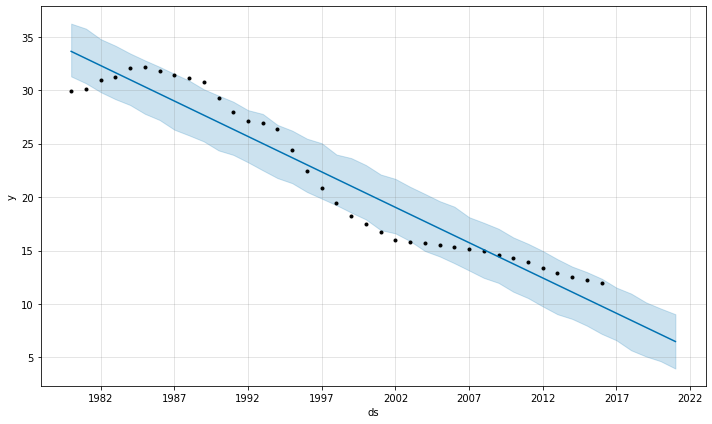

In [ ]:
evaluate_model(optimizer, bra_data_m)

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/qpl_3jcj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/ln1k6s_l.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=31212', 'data', 'file=/tmp/tmpjad4h45l/qpl_3jcj.json', 'init=/tmp/tmpjad4h45l/ln1k6s_l.json', 'output', 'file=/tmp/tmpjad4h45l/prophet_modeluenot5fg/prophet_model-20221022001136.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:11:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:11:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


--------------------Evaluation---------------------
MSE :  0.6568157900753235
MAE :  0.7877017650847904
MAPE :  1.293232724700562
--------------------Evaluation---------------------


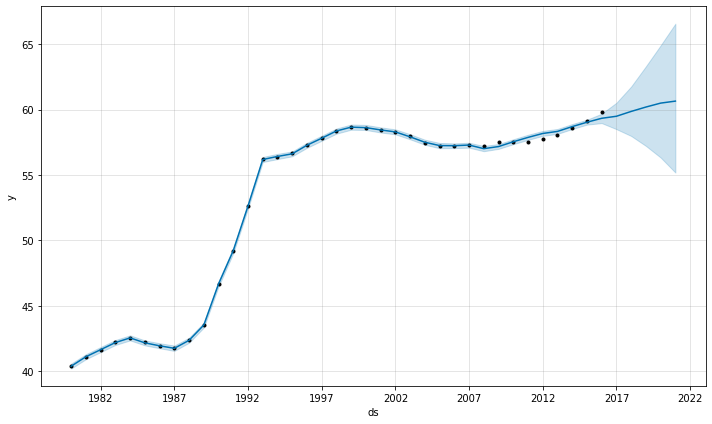

In [ ]:
fit_model_s(bra_data_s)

In [ ]:
optimizer, _, _ = getOpt_s(bra_data_s)

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/kwy2zskd.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/g_815ss3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=54136', 'data', 'file=/tmp/tmppq7tkcfl/kwy2zskd.json', 'init=/tmp/tmppq7tkcfl/g_815ss3.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model8vr3dphk/prophet_model-20221114001037.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:10:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing


|   iter    |  target   | yearly... |
-------------------------------------


00:10:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/u83op20m.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/j7vofu_3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=58368', 'data', 'file=/tmp/tmppq7tkcfl/u83op20m.json', 'init=/tmp/tmppq7tkcfl/j7vofu_3.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelemgp_blx/prophet_model-20221114001037.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:10:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:10:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/e9nktsxk.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -3.297    | -0.3319   |


00:10:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/4v_k_2uu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/frxdbfmi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=1169', 'data', 'file=/tmp/tmppq7tkcfl/4v_k_2uu.json', 'init=/tmp/tmppq7tkcfl/frxdbfmi.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelfa6bsgd2/prophet_model-20221114001058.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:10:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:10:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/hikvwhet.json
DEBUG:cmdstanpy:input tempfile: 

| 2         | -3.169    | 0.8813    |


00:11:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/sdbnnmgz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/rylonhxg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53374', 'data', 'file=/tmp/tmppq7tkcfl/sdbnnmgz.json', 'init=/tmp/tmppq7tkcfl/rylonhxg.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model0g_ve_ci/prophet_model-20221114001121.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:11:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:11:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/gnyfkpe_.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -3.468    | -2.0      |


00:11:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/724hcykf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/5uqakoa_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=41974', 'data', 'file=/tmp/tmppq7tkcfl/724hcykf.json', 'init=/tmp/tmppq7tkcfl/5uqakoa_.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model_dluwmt2/prophet_model-20221114001143.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:11:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:11:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/j0pv3i3f.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -3.035    | -0.7907   |


00:12:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/v2ul69y3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/00n_g9fz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=31613', 'data', 'file=/tmp/tmppq7tkcfl/v2ul69y3.json', 'init=/tmp/tmppq7tkcfl/00n_g9fz.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeli1eb6aet/prophet_model-20221114001206.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:12:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:12:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/l68k8qdo.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -3.025    | -1.413    |


00:12:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/fhnbep7x.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/w34o2_d5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=92890', 'data', 'file=/tmp/tmppq7tkcfl/fhnbep7x.json', 'init=/tmp/tmppq7tkcfl/w34o2_d5.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelco626x56/prophet_model-20221114001228.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:12:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:12:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/7dfydmse.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -3.311    | -1.631    |


00:12:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/moxp2f8u.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/nrtbzsxl.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=50502', 'data', 'file=/tmp/tmppq7tkcfl/moxp2f8u.json', 'init=/tmp/tmppq7tkcfl/nrtbzsxl.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model9d_fbzlq/prophet_model-20221114001251.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:12:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:12:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ezfym1j5.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -3.089    | -1.255    |


00:13:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/51umvvpu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/1szje9p1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79619', 'data', 'file=/tmp/tmppq7tkcfl/51umvvpu.json', 'init=/tmp/tmppq7tkcfl/1szje9p1.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model6k0eczrs/prophet_model-20221114001313.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:13:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:13:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/7sjf2amg.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -3.351    | -0.6178   |


00:13:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/unv9iic5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/hry2m_3c.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=9891', 'data', 'file=/tmp/tmppq7tkcfl/unv9iic5.json', 'init=/tmp/tmppq7tkcfl/hry2m_3c.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelxesawgcc/prophet_model-20221114001336.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:13:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:13:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/w395avjw.json
DEBUG:cmdstanpy:input tempfile: 

| 9         | -3.041    | -0.4129   |


00:13:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/3nrxzlid.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/02r3k4ic.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=80301', 'data', 'file=/tmp/tmppq7tkcfl/3nrxzlid.json', 'init=/tmp/tmppq7tkcfl/02r3k4ic.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model8e6s6x4m/prophet_model-20221114001358.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:13:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:13:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/o6jn2jtl.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -3.326    | 0.1553    |


00:14:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/y8x7r_hi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/mmvi4vsq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57900', 'data', 'file=/tmp/tmppq7tkcfl/y8x7r_hi.json', 'init=/tmp/tmppq7tkcfl/mmvi4vsq.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelr14nk3w3/prophet_model-20221114001422.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:14:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:14:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/9dydhnje.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -3.025    | -1.413    |


DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=55114', 'data', 'file=/tmp/tmppq7tkcfl/yiroztqs.json', 'init=/tmp/tmppq7tkcfl/pe6bge5b.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeleg7cc2mm/prophet_model-20221114001445.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:14:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:14:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/rx9lpahj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/xx75ae0k.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=87192', 'data', 'file=/tmp/tmppq7tkcfl/rx9lpahj.json', 'init=/tmp/tmppq7tkcfl/xx75ae0k.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model3h3uzjr_/prophet_model-20221114001445.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:14:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:14:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/z7wdqc0w.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -3.01     | -1.368    |


INFO:cmdstanpy:Chain [1] start processing
00:15:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/pvvt268i.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/58012cug.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=18345', 'data', 'file=/tmp/tmppq7tkcfl/pvvt268i.json', 'init=/tmp/tmppq7tkcfl/58012cug.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelcjkyd4yx/prophet_model-20221114001509.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:15:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:15:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/qhyb4d2k.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -3.034    | -0.8735   |


DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/rdt7a2eg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/kv718cm_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=51785', 'data', 'file=/tmp/tmppq7tkcfl/rdt7a2eg.json', 'init=/tmp/tmppq7tkcfl/kv718cm_.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelb162qotz/prophet_model-20221114001531.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:15:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:15:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/opi2w1ef.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/0i0_8yli.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=29498', 'data', 'file=/tmp/tmppq7tkcfl/opi2w1ef.json', 'init=/tmp/tmppq7tkcfl/0i0_8yli.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeltpuij0iq/prophet_model-20221114001531.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:15:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:15:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/b8v8uq8n.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -3.276    | -0.9908   |


INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/mdt57ryn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/jybcb5px.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=20106', 'data', 'file=/tmp/tmppq7tkcfl/mdt57ryn.json', 'init=/tmp/tmppq7tkcfl/jybcb5px.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelvgve5mrp/prophet_model-20221114001555.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:15:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:15:55 - cmdstanpy - INFO - Chain [1] do

  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/xs4fu48u.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/dloveogs.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=86010', 'data', 'file=/tmp/tmppq7tkcfl/xs4fu48u.json', 'init=/tmp/tmppq7tkcfl/dloveogs.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelz3lx1w35/prophet_model-20221114001555.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:15:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:15:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/t9gpisez.json
DEBUG:cmdstanpy:input tempfile:

--------------------Evaluation---------------------
MSE :  3.7443086786687116
MAE :  1.9168316888064567
MAPE :  3.1438994370661986
--------------------Evaluation---------------------


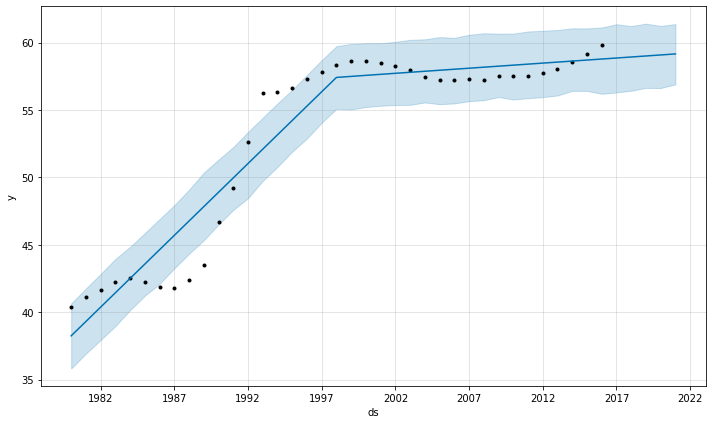

In [ ]:
evaluate_model_s(optimizer, bra_data_s)

## Canada

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 15.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/kysowm3f.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/7li11y9y.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=23033', 'data', 'file=/tmp/tmpb7lz_7lg/kysowm3f.json', 'init=/tmp/tmpb7lz_7lg/7li11y9y.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelon7uw2d8/prophet_model-20221130025603.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:56:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmds

|   iter    |  target   | yearly... |
-------------------------------------


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/mxdhgfrr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/f96qr792.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=44197', 'data', 'file=/tmp/tmpb7lz_7lg/mxdhgfrr.json', 'init=/tmp/tmpb7lz_7lg/f96qr792.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelkancxrze/prophet_model-20221130025603.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:56:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:56:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/udv17kb2.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -1.241    | -0.3319   |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/wbo6680u.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/uobmq8ck.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63370', 'data', 'file=/tmp/tmpb7lz_7lg/wbo6680u.json', 'init=/tmp/tmpb7lz_7lg/uobmq8ck.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelqaw213_1/prophet_model-20221130025610.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:56:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:56:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/vfbyp1im.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -1.235    | 0.8813    |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/soyg083n.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/na2ndcqr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=90416', 'data', 'file=/tmp/tmpb7lz_7lg/soyg083n.json', 'init=/tmp/tmpb7lz_7lg/na2ndcqr.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelfu8nbvti/prophet_model-20221130025616.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:56:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:56:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/m2uv0igt.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -1.216    | -2.0      |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/hsq26kzr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/xbe2422x.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=48782', 'data', 'file=/tmp/tmpb7lz_7lg/hsq26kzr.json', 'init=/tmp/tmpb7lz_7lg/xbe2422x.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model12n8zqb_/prophet_model-20221130025623.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:56:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:56:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/9fzivvfe.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -1.215    | -0.7907   |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/4_qhm84s.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/kpw25ltx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39512', 'data', 'file=/tmp/tmpb7lz_7lg/4_qhm84s.json', 'init=/tmp/tmpb7lz_7lg/kpw25ltx.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelcrtgxa25/prophet_model-20221130025629.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:56:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:56:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/nbwp7kto.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -1.228    | -1.413    |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/y269yexe.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/iwkqll39.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53360', 'data', 'file=/tmp/tmpb7lz_7lg/y269yexe.json', 'init=/tmp/tmpb7lz_7lg/iwkqll39.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelet2lqpzc/prophet_model-20221130025636.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:56:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:56:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/8xhduahi.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -1.215    | -1.631    |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/5q01mmr0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/u357ffxh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=97688', 'data', 'file=/tmp/tmpb7lz_7lg/5q01mmr0.json', 'init=/tmp/tmpb7lz_7lg/u357ffxh.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model5h_4bmv3/prophet_model-20221130025642.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:56:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:56:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/mnvcpesu.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -1.225    | -1.255    |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/xcmhnha_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/01bej_qc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=96415', 'data', 'file=/tmp/tmpb7lz_7lg/xcmhnha_.json', 'init=/tmp/tmpb7lz_7lg/01bej_qc.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelhruqjzop/prophet_model-20221130025649.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:56:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:56:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/gjqrsuae.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -1.215    | -0.6178   |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/47wrsnx6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/5ejysutw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=25175', 'data', 'file=/tmp/tmpb7lz_7lg/47wrsnx6.json', 'init=/tmp/tmpb7lz_7lg/5ejysutw.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeld1caqwkv/prophet_model-20221130025655.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:56:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:56:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/9d369erm.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -1.212    | -0.4129   |


INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/wlk61bnc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/nuxiooeo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=93066', 'data', 'file=/tmp/tmpb7lz_7lg/wlk61bnc.json', 'init=/tmp/tmpb7lz_7lg/nuxiooeo.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelpswsavg1/prophet_model-20221130025702.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:57:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:57:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/n0f6oyp6.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -1.216    | 0.1553    |


INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/t08h80bh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/la3p9eub.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79095', 'data', 'file=/tmp/tmpb7lz_7lg/t08h80bh.json', 'init=/tmp/tmpb7lz_7lg/la3p9eub.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model2bli6psj/prophet_model-20221130025709.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:57:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:57:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/0vs00_iz.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -1.216    | 0.1552    |


02:57:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/zcg5ihe3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/payd9_6s.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7446', 'data', 'file=/tmp/tmpb7lz_7lg/zcg5ihe3.json', 'init=/tmp/tmpb7lz_7lg/payd9_6s.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelniowtdrx/prophet_model-20221130025716.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:57:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:57:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/c115ssls.json
DEBUG:cmdstanpy:input tempfile: 

| 12        | -1.217    | 0.1633    |


02:57:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:57:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/wdcezh5a.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/gu1kn2li.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=19936', 'data', 'file=/tmp/tmpb7lz_7lg/wdcezh5a.json', 'init=/tmp/tmpb7lz_7lg/gu1kn2li.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model2hf59c4l/prophet_model-20221130025723.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:57:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:57:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/vk72svlg.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -1.213    | -0.4202   |


DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=35249', 'data', 'file=/tmp/tmpb7lz_7lg/9rh1j63f.json', 'init=/tmp/tmpb7lz_7lg/7y0n0o6t.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelpsuwxu9t/prophet_model-20221130025729.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:57:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:57:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/qo950va7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/bnnd6a1w.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=49698', 'data', 'file=/tmp/tmpb7lz_7lg/qo950va7.json', 'init=/tmp/tmpb7lz_7lg/bnnd6a1w.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelpeyzmvls/prophet_model-20221130025729.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:57:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:57:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/xu_gsc0s.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -1.213    | -0.4039   |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/_62j6ce0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/97_dvxut.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=20503', 'data', 'file=/tmp/tmpb7lz_7lg/_62j6ce0.json', 'init=/tmp/tmpb7lz_7lg/97_dvxut.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model0vak8pc1/prophet_model-20221130025736.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:57:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:57:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/2vwts8kq.json
DEBUG:cmdstanpy:input tempfile:

Index(['ds', 'trend', 'yhat_lower', 'yhat_upper', 'trend_lower', 'trend_upper',
       'additive_terms', 'additive_terms_lower', 'additive_terms_upper',
       'yearly', 'yearly_lower', 'yearly_upper', 'multiplicative_terms',
       'multiplicative_terms_lower', 'multiplicative_terms_upper', 'yhat'],
      dtype='object')
|   iter    |  target   | yearly... |
-------------------------------------


INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/kre_0css.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/4r2v8xnq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=95475', 'data', 'file=/tmp/tmpb7lz_7lg/kre_0css.json', 'init=/tmp/tmpb7lz_7lg/4r2v8xnq.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modele4hp8api/prophet_model-20221130025743.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:57:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:57:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/hi16w3zu.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -1.257    | -0.3319   |


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/sna39wzl.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/fyq9sg38.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=82013', 'data', 'file=/tmp/tmpb7lz_7lg/sna39wzl.json', 'init=/tmp/tmpb7lz_7lg/fyq9sg38.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelnqwwe4b5/prophet_model-20221130025753.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:57:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:57:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/_rum50o4.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -1.239    | 0.8813    |


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/yy521lxa.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/3a3zto7g.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=59917', 'data', 'file=/tmp/tmpb7lz_7lg/yy521lxa.json', 'init=/tmp/tmpb7lz_7lg/3a3zto7g.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelh70dv2dm/prophet_model-20221130025804.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:58:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:58:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/yso55n0o.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -1.23     | -2.0      |


INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/16kp0y99.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/p8shwu30.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=81782', 'data', 'file=/tmp/tmpb7lz_7lg/16kp0y99.json', 'init=/tmp/tmpb7lz_7lg/p8shwu30.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelsga80q9w/prophet_model-20221130025814.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:58:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:58:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/viad0l2f.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -1.232    | -0.7907   |


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/mbsfy7a9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/0w63xs7l.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=17307', 'data', 'file=/tmp/tmpb7lz_7lg/mbsfy7a9.json', 'init=/tmp/tmpb7lz_7lg/0w63xs7l.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelwgx7w7m_/prophet_model-20221130025824.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:58:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:58:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/py94_fd_.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -1.238    | -1.413    |


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/blgwuybr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/z6bru_hg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=71177', 'data', 'file=/tmp/tmpb7lz_7lg/blgwuybr.json', 'init=/tmp/tmpb7lz_7lg/z6bru_hg.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model3ba0rs7z/prophet_model-20221130025835.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:58:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:58:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ktagnwxr.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -1.23     | -1.631    |


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/d68vniyx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/by181mu8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=80997', 'data', 'file=/tmp/tmpb7lz_7lg/d68vniyx.json', 'init=/tmp/tmpb7lz_7lg/by181mu8.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelo92j8wq2/prophet_model-20221130025845.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:58:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:58:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/cylbth7e.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -1.236    | -1.255    |


INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/vytceiy4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/22fss7qc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=47330', 'data', 'file=/tmp/tmpb7lz_7lg/vytceiy4.json', 'init=/tmp/tmpb7lz_7lg/22fss7qc.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model2zypzlq_/prophet_model-20221130025855.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:58:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:58:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/dj51izwv.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -1.234    | -0.6178   |


02:59:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/czsusj7f.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/j2vplx1t.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=906', 'data', 'file=/tmp/tmpb7lz_7lg/czsusj7f.json', 'init=/tmp/tmpb7lz_7lg/j2vplx1t.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelwe_j_4li/prophet_model-20221130025907.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:59:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:59:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/g38_c1rw.json
DEBUG:cmdstanpy:input tempfile: /

| 9         | -1.231    | -0.4129   |


INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/nj668zr_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/7daug0bg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=38251', 'data', 'file=/tmp/tmpb7lz_7lg/nj668zr_.json', 'init=/tmp/tmpb7lz_7lg/7daug0bg.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelvh30aivb/prophet_model-20221130025917.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:59:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:59:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/d6b5v_3p.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -1.263    | 0.1553    |


02:59:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/96q8ayqm.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/msggsjsf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=65904', 'data', 'file=/tmp/tmpb7lz_7lg/96q8ayqm.json', 'init=/tmp/tmpb7lz_7lg/msggsjsf.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelgrjto152/prophet_model-20221130025928.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:59:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:59:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/yngajdqx.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -1.245    | -1.413    |


02:59:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/2pqc9s76.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/10p2qcuc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=19598', 'data', 'file=/tmp/tmpb7lz_7lg/2pqc9s76.json', 'init=/tmp/tmpb7lz_7lg/10p2qcuc.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model_2exwn2d/prophet_model-20221130025938.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:59:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:59:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/thzdgtft.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -1.234    | -0.6177   |


02:59:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/r7whodnb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/22w8hhp2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37525', 'data', 'file=/tmp/tmpb7lz_7lg/r7whodnb.json', 'init=/tmp/tmpb7lz_7lg/22w8hhp2.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelvdyac0uz/prophet_model-20221130025949.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:59:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:59:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/87ovg2ls.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -1.23     | -1.631    |


INFO:cmdstanpy:Chain [1] start processing
02:59:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/_6by6nu9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/61ubsaz2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=54335', 'data', 'file=/tmp/tmpb7lz_7lg/_6by6nu9.json', 'init=/tmp/tmpb7lz_7lg/61ubsaz2.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modela6k764st/prophet_model-20221130025959.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
02:59:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:59:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/1910u017.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -1.245    | -1.413    |


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/b004g6e3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/cb4v1xii.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=2774', 'data', 'file=/tmp/tmpb7lz_7lg/b004g6e3.json', 'init=/tmp/tmpb7lz_7lg/cb4v1xii.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelphy82pg6/prophet_model-20221130030010.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:00:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:00:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/nuwar23r.json
DEBUG:cmdstanpy:input tempfile: 

Index(['ds', 'trend', 'yhat_lower', 'yhat_upper', 'trend_lower', 'trend_upper',
       'additive_terms', 'additive_terms_lower', 'additive_terms_upper',
       'yearly', 'yearly_lower', 'yearly_upper', 'multiplicative_terms',
       'multiplicative_terms_lower', 'multiplicative_terms_upper', 'yhat'],
      dtype='object')


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:70: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:78: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 15.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/jspu66wr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/sptjz4ba.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=798', 'data', 'file=/

|   iter    |  target   | yearly... |
-------------------------------------


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/972gm6w7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/slsctfqs.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=26099', 'data', 'file=/tmp/tmpb7lz_7lg/972gm6w7.json', 'init=/tmp/tmpb7lz_7lg/slsctfqs.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model2bldmqd1/prophet_model-20221130030022.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:00:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:00:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/d_w123ph.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -1.766    | -0.3319   |


INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/3dgzxnhr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/tl04sxs6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=75362', 'data', 'file=/tmp/tmpb7lz_7lg/3dgzxnhr.json', 'init=/tmp/tmpb7lz_7lg/tl04sxs6.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelaskqi7b_/prophet_model-20221130030030.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:00:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:00:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/p_1_j76j.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -1.92     | 0.8813    |


03:00:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/vyd5pgp4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/_kdr3ttm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=25123', 'data', 'file=/tmp/tmpb7lz_7lg/vyd5pgp4.json', 'init=/tmp/tmpb7lz_7lg/_kdr3ttm.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelb68ez2ns/prophet_model-20221130030037.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:00:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:00:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/6i1teaz4.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -1.644    | -2.0      |


INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/hisn8s0u.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ikmf88q5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=78124', 'data', 'file=/tmp/tmpb7lz_7lg/hisn8s0u.json', 'init=/tmp/tmpb7lz_7lg/ikmf88q5.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model8m1un5xg/prophet_model-20221130030044.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:00:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:00:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/nqlqwplg.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -1.67     | -0.7907   |


03:00:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/lweg5kzk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/yifrycfi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57000', 'data', 'file=/tmp/tmpb7lz_7lg/lweg5kzk.json', 'init=/tmp/tmpb7lz_7lg/yifrycfi.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelsgz5oj2q/prophet_model-20221130030051.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:00:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:00:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/y6xo_9me.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -1.651    | -1.413    |


INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/_74x903q.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/qd5hpn3n.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12438', 'data', 'file=/tmp/tmpb7lz_7lg/_74x903q.json', 'init=/tmp/tmpb7lz_7lg/qd5hpn3n.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelncd5eg3q/prophet_model-20221130030058.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:00:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:00:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/guhofi5f.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -1.65     | -1.631    |


INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/nc5cy6w5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ze2fb3iv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39137', 'data', 'file=/tmp/tmpb7lz_7lg/nc5cy6w5.json', 'init=/tmp/tmpb7lz_7lg/ze2fb3iv.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modellfd2_g54/prophet_model-20221130030105.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:01:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:01:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/fzfpzac1.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -1.652    | -1.255    |


03:01:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/1v1niudz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/i48mln27.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=67791', 'data', 'file=/tmp/tmpb7lz_7lg/1v1niudz.json', 'init=/tmp/tmpb7lz_7lg/i48mln27.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model4yn5g3pb/prophet_model-20221130030112.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:01:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:01:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/dmfyhd47.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -1.694    | -0.6178   |


INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/mweey6t3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/b9w4acv3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70615', 'data', 'file=/tmp/tmpb7lz_7lg/mweey6t3.json', 'init=/tmp/tmpb7lz_7lg/b9w4acv3.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelwetu4ut9/prophet_model-20221130030119.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:01:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:01:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/y0ka2_di.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -1.754    | -0.4129   |


03:01:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/vd_arvfn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/lnzup6x4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99758', 'data', 'file=/tmp/tmpb7lz_7lg/vd_arvfn.json', 'init=/tmp/tmpb7lz_7lg/lnzup6x4.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelnkl87e6q/prophet_model-20221130030126.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:01:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:01:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ner139oh.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -1.808    | 0.1553    |


03:01:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/qofsykq8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/2_ng2qo5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79713', 'data', 'file=/tmp/tmpb7lz_7lg/qofsykq8.json', 'init=/tmp/tmpb7lz_7lg/2_ng2qo5.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model6bya7zx7/prophet_model-20221130030133.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:01:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:01:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/1gfg1gpr.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -2.453    | 2.0       |


03:01:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/uwvafk4i.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/wwzkpwaa.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=5331', 'data', 'file=/tmp/tmpb7lz_7lg/uwvafk4i.json', 'init=/tmp/tmpb7lz_7lg/wwzkpwaa.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelj5rd006h/prophet_model-20221130030140.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:01:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:01:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/c4j15cse.json
DEBUG:cmdstanpy:input tempfile: 

| 12        | -1.653    | -1.854    |


03:01:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/tah998c2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/zjudpv43.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=86332', 'data', 'file=/tmp/tmpb7lz_7lg/tah998c2.json', 'init=/tmp/tmpb7lz_7lg/zjudpv43.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelipq_cvgv/prophet_model-20221130030147.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:01:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:01:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/4z_92odp.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -1.655    | -1.061    |


03:01:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/3d_bplbk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/9njfijci.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=92719', 'data', 'file=/tmp/tmpb7lz_7lg/3d_bplbk.json', 'init=/tmp/tmpb7lz_7lg/9njfijci.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelc_1k3dv6/prophet_model-20221130030154.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:01:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:01:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/0ow703g3.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -1.644    | -2.0      |


03:02:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/s9wxk64e.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/6b42o5y8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=83877', 'data', 'file=/tmp/tmpb7lz_7lg/s9wxk64e.json', 'init=/tmp/tmpb7lz_7lg/6b42o5y8.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelzvepw7xs/prophet_model-20221130030201.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:02:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:02:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/9io7x58i.json
DEBUG:cmdstanpy:input tempfile:

|   iter    |  target   | yearly... |
-------------------------------------


03:02:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/3_x7ji09.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/0ltp7zin.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=58237', 'data', 'file=/tmp/tmpb7lz_7lg/3_x7ji09.json', 'init=/tmp/tmpb7lz_7lg/0ltp7zin.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modellf631a6w/prophet_model-20221130030209.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:02:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:02:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/u3fdqaso.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -1.451    | -0.3319   |


03:02:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/hr7jj7fp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/u2_wcmeb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57769', 'data', 'file=/tmp/tmpb7lz_7lg/hr7jj7fp.json', 'init=/tmp/tmpb7lz_7lg/u2_wcmeb.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelp0phjltp/prophet_model-20221130030220.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:02:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:02:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ws3up8n7.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -1.57     | 0.8813    |


03:02:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/3ctiwdbd.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/5xbworzy.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=91055', 'data', 'file=/tmp/tmpb7lz_7lg/3ctiwdbd.json', 'init=/tmp/tmpb7lz_7lg/5xbworzy.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelsq3lfkgl/prophet_model-20221130030232.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:02:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:02:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/f8u46xma.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -1.343    | -2.0      |


03:02:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/38g1mqk8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/2garpguh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=59511', 'data', 'file=/tmp/tmpb7lz_7lg/38g1mqk8.json', 'init=/tmp/tmpb7lz_7lg/2garpguh.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelhtwvc59z/prophet_model-20221130030243.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:02:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:02:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ea2xcpy6.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -1.365    | -0.7907   |


03:02:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/xb3h36fi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ez60xeit.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=74875', 'data', 'file=/tmp/tmpb7lz_7lg/xb3h36fi.json', 'init=/tmp/tmpb7lz_7lg/ez60xeit.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelf_8uavi4/prophet_model-20221130030254.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:02:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:02:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/g3cd96k3.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -1.35     | -1.413    |


03:03:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/hwy4wmf0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ggai4cvp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=72623', 'data', 'file=/tmp/tmpb7lz_7lg/hwy4wmf0.json', 'init=/tmp/tmpb7lz_7lg/ggai4cvp.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modele7f605vn/prophet_model-20221130030305.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:03:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:03:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/n78h46me.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -1.347    | -1.631    |


03:03:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/0iph7sg1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/a0geghia.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=94655', 'data', 'file=/tmp/tmpb7lz_7lg/0iph7sg1.json', 'init=/tmp/tmpb7lz_7lg/a0geghia.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeloglx0i_d/prophet_model-20221130030316.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:03:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:03:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/r6s889sw.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -1.349    | -1.255    |


03:03:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ztm34dt0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/d8qom3nn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=72578', 'data', 'file=/tmp/tmpb7lz_7lg/ztm34dt0.json', 'init=/tmp/tmpb7lz_7lg/d8qom3nn.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model4rvewluc/prophet_model-20221130030327.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:03:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:03:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/l83vniug.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -1.388    | -0.6178   |


03:03:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/oo_2g_04.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/mbp0ftc0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=22722', 'data', 'file=/tmp/tmpb7lz_7lg/oo_2g_04.json', 'init=/tmp/tmpb7lz_7lg/mbp0ftc0.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelkdu_88fg/prophet_model-20221130030339.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:03:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:03:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/wrmlih6k.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -1.44     | -0.4129   |


03:03:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/1wr46oeu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/uwqmn87m.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39329', 'data', 'file=/tmp/tmpb7lz_7lg/1wr46oeu.json', 'init=/tmp/tmpb7lz_7lg/uwqmn87m.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model3glqa1bj/prophet_model-20221130030351.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:03:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:03:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/k_kb_eys.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -1.487    | 0.1553    |


03:04:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/aqjoaox9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/a1232_qk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=15822', 'data', 'file=/tmp/tmpb7lz_7lg/aqjoaox9.json', 'init=/tmp/tmpb7lz_7lg/a1232_qk.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelnbt_xfln/prophet_model-20221130030402.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:04:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:04:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/rdgw_twf.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -2.003    | 2.0       |


03:04:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/cot2z1t4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/i38y6ihf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=19817', 'data', 'file=/tmp/tmpb7lz_7lg/cot2z1t4.json', 'init=/tmp/tmpb7lz_7lg/i38y6ihf.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model2875ldx4/prophet_model-20221130030413.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:04:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:04:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/3k4yt7qv.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -1.351    | -1.849    |


03:04:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/kite67zp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/43vfpbck.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=94251', 'data', 'file=/tmp/tmpb7lz_7lg/kite67zp.json', 'init=/tmp/tmpb7lz_7lg/43vfpbck.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelz1yyg897/prophet_model-20221130030424.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:04:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:04:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/kz9bsc3d.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -1.353    | -1.063    |


03:04:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/cyo6h9qo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/oeeupgk0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=27911', 'data', 'file=/tmp/tmpb7lz_7lg/cyo6h9qo.json', 'init=/tmp/tmpb7lz_7lg/oeeupgk0.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelkime44oq/prophet_model-20221130030436.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:04:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:04:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/4j46lfrr.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -1.343    | -2.0      |


03:04:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/proxbrvi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/qdwxt_gt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99824', 'data', 'file=/tmp/tmpb7lz_7lg/proxbrvi.json', 'init=/tmp/tmpb7lz_7lg/qdwxt_gt.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelk41ssvhw/prophet_model-20221130030447.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:04:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:04:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/c9k0kfrn.json
DEBUG:cmdstanpy:input tempfile:

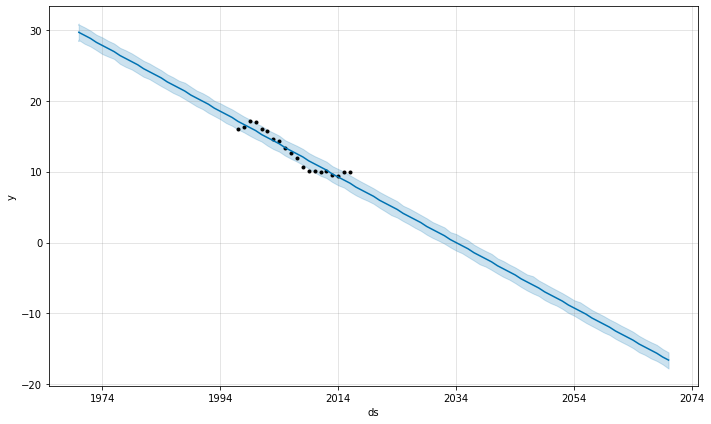

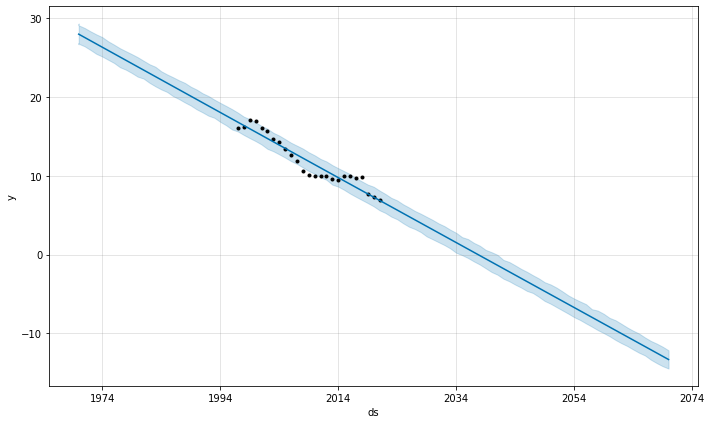

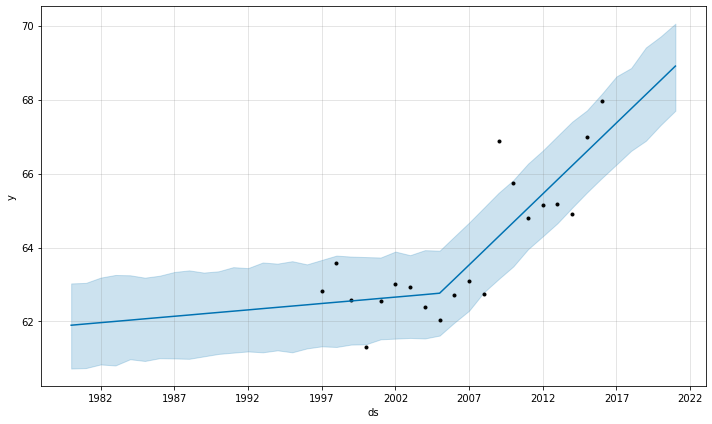

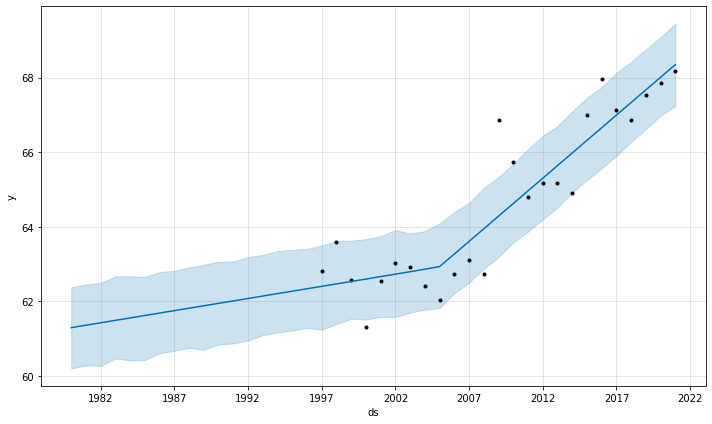

In [ ]:
generate_results_m(can_data_m, "CAN")
generate_results_s(can_data_s, "CAN")

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 15.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/xmlmnc_w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/1ltj55xn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7766', 'data', 'file=/tmp/tmpjad4h45l/xmlmnc_w.json', 'init=/tmp/tmpjad4h45l/1ltj55xn.json', 'output', 'file=/tmp/tmpjad4h45l/prophet_model_0v0i2ua/prophet_model-20221022001155.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:11:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:11:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cm

--------------------Evaluation---------------------
MSE :  0.07749174451932389
MAE :  0.26419816905810833
MAPE :  2.530847103273546
--------------------Evaluation---------------------


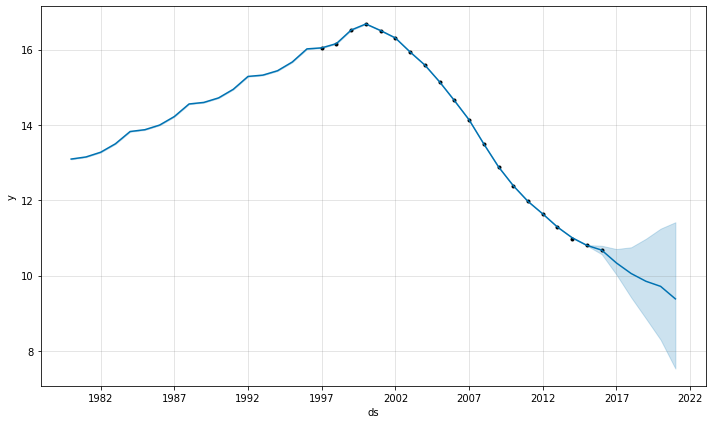

In [ ]:
fit_model_m(can_data_m)

In [ ]:
optimizer, _, _ = getOpt(can_data_m)

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 15.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/qlxs7mz7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/n1ssr_ni.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=96155', 'data', 'file=/tmp/tmppq7tkcfl/qlxs7mz7.json', 'init=/tmp/tmppq7tkcfl/n1ssr_ni.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model9ytbsx5t/prophet_model-20221113233857.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:38:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmds

|   iter    |  target   | yearly... |
-------------------------------------


23:38:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ysdml1iv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/5cbzlpzw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=19773', 'data', 'file=/tmp/tmppq7tkcfl/ysdml1iv.json', 'init=/tmp/tmppq7tkcfl/5cbzlpzw.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelv0pi9lze/prophet_model-20221113233858.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:38:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:38:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/_nbuf7im.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.1865   | -0.3319   |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/638rqh3t.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/nxlupt91.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=58758', 'data', 'file=/tmp/tmppq7tkcfl/638rqh3t.json', 'init=/tmp/tmppq7tkcfl/nxlupt91.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modell0flrlhk/prophet_model-20221113233905.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:39:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:39:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/puf_bzjz.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.2155   | 0.8813    |


INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/7z5m02f2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/7uc1ehn7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=29665', 'data', 'file=/tmp/tmppq7tkcfl/7z5m02f2.json', 'init=/tmp/tmppq7tkcfl/7uc1ehn7.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model8cibb1pv/prophet_model-20221113233912.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:39:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:39:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/h79iuyph.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -0.1975   | -2.0      |


INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/k7zclhtz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/juoewzr1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=92021', 'data', 'file=/tmp/tmppq7tkcfl/k7zclhtz.json', 'init=/tmp/tmppq7tkcfl/juoewzr1.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model1xorx1rf/prophet_model-20221113233919.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:39:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:39:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/h8vxg134.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.1849   | -0.7907   |


INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/7hhxijs2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/w9nll_7z.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=11511', 'data', 'file=/tmp/tmppq7tkcfl/7hhxijs2.json', 'init=/tmp/tmppq7tkcfl/w9nll_7z.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model7s3gcxs9/prophet_model-20221113233927.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:39:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:39:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/jlglozhf.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.1857   | -1.413    |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/_4jwldx6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/qpvmc7w4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60973', 'data', 'file=/tmp/tmppq7tkcfl/_4jwldx6.json', 'init=/tmp/tmppq7tkcfl/qpvmc7w4.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelv5x0w34c/prophet_model-20221113233933.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:39:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:39:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/youenaqo.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.1944   | -1.631    |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/9t2_sey8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/tpr_fqjw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=3465', 'data', 'file=/tmp/tmppq7tkcfl/9t2_sey8.json', 'init=/tmp/tmppq7tkcfl/tpr_fqjw.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelq6q84027/prophet_model-20221113233942.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:39:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:39:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/7xvbexc0.json
DEBUG:cmdstanpy:input tempfile: 

| 7         | -0.1817   | -1.255    |


INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/3oxidq0s.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/7nv57h_x.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=21506', 'data', 'file=/tmp/tmppq7tkcfl/3oxidq0s.json', 'init=/tmp/tmppq7tkcfl/7nv57h_x.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model9s0sgghm/prophet_model-20221113233949.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:39:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:39:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/7z2x4gv3.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.1852   | -0.6178   |


23:39:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/errrll47.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/yfv48bws.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=21741', 'data', 'file=/tmp/tmppq7tkcfl/errrll47.json', 'init=/tmp/tmppq7tkcfl/yfv48bws.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelr6ge6fvh/prophet_model-20221113233956.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:39:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:39:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/brc7n3ll.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -0.1867   | -0.4129   |


23:40:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/9svkj2r_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/p4rq41y1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=52353', 'data', 'file=/tmp/tmppq7tkcfl/9svkj2r_.json', 'init=/tmp/tmppq7tkcfl/p4rq41y1.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model8dqvrqk9/prophet_model-20221113234004.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:40:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:40:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/4ssp0z9o.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -0.1912   | 0.1553    |


23:40:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/g2qp95kq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/7z6g8l9_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=80341', 'data', 'file=/tmp/tmppq7tkcfl/g2qp95kq.json', 'init=/tmp/tmppq7tkcfl/7z6g8l9_.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelknz16hma/prophet_model-20221113234011.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:40:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:40:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/v3mlywvm.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -0.2301   | 2.0       |


INFO:prophet:n_changepoints greater than number of observations. Using 15.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/lra7mwq6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/fhypnhb4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=56752', 'data', 'file=/tmp/tmppq7tkcfl/lra7mwq6.json', 'init=/tmp/tmppq7tkcfl/fhypnhb4.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelmxug9tk4/prophet_model-20221113234018.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:40:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:40:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/8bn5gjua.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/k2n45m7u.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=86160', 'data', 'file=/tmp/tmppq7tkcfl/8bn5gjua.json', 'init=/tmp/tmppq7tkcfl/k2n45m7u.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelwfn80f34/prophet_model-20221113234018.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:40:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:40:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/q955ndaj.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.1813   | -1.096    |


INFO:cmdstanpy:Chain [1] start processing
23:40:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/i9x8dca5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/vor05as3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=72084', 'data', 'file=/tmp/tmppq7tkcfl/i9x8dca5.json', 'init=/tmp/tmppq7tkcfl/vor05as3.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model292j_bpd/prophet_model-20221113234027.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:40:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:40:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/k_0rbjpk.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -0.1809   | -1.166    |


23:40:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:40:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ugkto_0b.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/3_a_od8y.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=22748', 'data', 'file=/tmp/tmppq7tkcfl/ugkto_0b.json', 'init=/tmp/tmppq7tkcfl/3_a_od8y.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeli9qhvgs_/prophet_model-20221113234034.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:40:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:40:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/obsspylo.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -0.1804   | -1.156    |


INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 15.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/sr8cvo6v.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/rg9yqcvk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=95739', 'data', 'file=/tmp/tmppq7tkcfl/sr8cvo6v.json', 'init=/tmp/tmppq7tkcfl/rg9yqcvk.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelntl80mqh/prophet_model-20221113234042.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:40:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmds

  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/7h5wvx0n.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/245eimm2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84572', 'data', 'file=/tmp/tmppq7tkcfl/7h5wvx0n.json', 'init=/tmp/tmppq7tkcfl/245eimm2.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeltkqiy0xr/prophet_model-20221113234042.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:40:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:40:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/wtygrjzs.json
DEBUG:cmdstanpy:input tempfile:

--------------------Evaluation---------------------
MSE :  0.07653756751668
MAE :  0.2695657680034751
MAPE :  2.5809614102468195
--------------------Evaluation---------------------


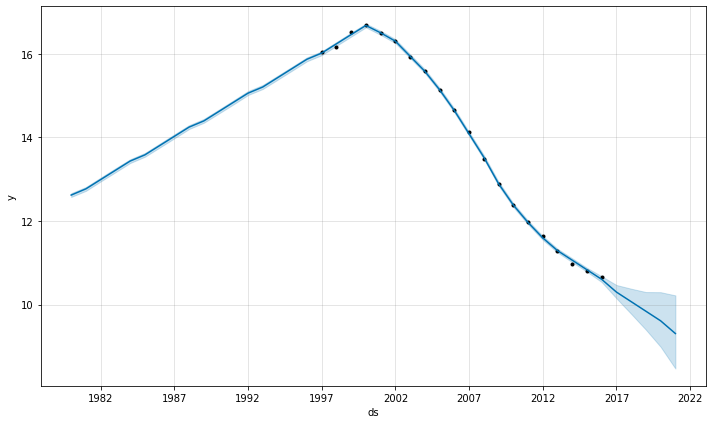

In [ ]:
evaluate_model(optimizer, can_data_m)

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 15.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/y7k9h0tm.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/6qhn59s3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=67527', 'data', 'file=/tmp/tmpjad4h45l/y7k9h0tm.json', 'init=/tmp/tmpjad4h45l/6qhn59s3.json', 'output', 'file=/tmp/tmpjad4h45l/prophet_modelr39z9711/prophet_model-20221022001411.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:14:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:14:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:c

--------------------Evaluation---------------------
MSE :  0.024473988410377588
MAE :  0.1540506824778589
MAPE :  0.23421459366189623
--------------------Evaluation---------------------


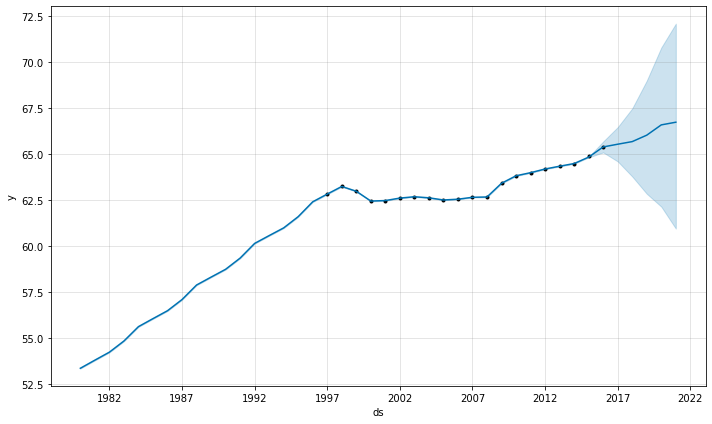

In [ ]:
fit_model_s(can_data_s)

In [ ]:
optimizer, _, _ = getOpt_s(can_data_s)

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 15.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/38lidh2y.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/jxx0nt8t.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=51683', 'data', 'file=/tmp/tmppq7tkcfl/38lidh2y.json', 'init=/tmp/tmppq7tkcfl/jxx0nt8t.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelutprnhuo/prophet_model-20221114001618.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:16:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmds

|   iter    |  target   | yearly... |
-------------------------------------


00:16:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/fv31l4kt.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/gv5vz9g9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=24583', 'data', 'file=/tmp/tmppq7tkcfl/fv31l4kt.json', 'init=/tmp/tmppq7tkcfl/gv5vz9g9.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model8zzl0v7p/prophet_model-20221114001618.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:16:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:16:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/cakpjlyr.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.386    | -0.3319   |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/931kca5r.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/eb1ovuuy.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=4059', 'data', 'file=/tmp/tmppq7tkcfl/931kca5r.json', 'init=/tmp/tmppq7tkcfl/eb1ovuuy.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeliyhuhzo4/prophet_model-20221114001626.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:16:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:16:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/n2r2r3ep.json
DEBUG:cmdstanpy:input tempfile: 

| 2         | -0.4636   | 0.8813    |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/egmzn_rg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/l6kbrfid.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=8035', 'data', 'file=/tmp/tmppq7tkcfl/egmzn_rg.json', 'init=/tmp/tmppq7tkcfl/l6kbrfid.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelnh7i8k0s/prophet_model-20221114001633.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:16:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:16:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/6usjmaup.json
DEBUG:cmdstanpy:input tempfile: 

| 3         | -0.3556   | -2.0      |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/f8lozzp1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/y9x8qk8x.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=58330', 'data', 'file=/tmp/tmppq7tkcfl/f8lozzp1.json', 'init=/tmp/tmppq7tkcfl/y9x8qk8x.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modellwmghkd2/prophet_model-20221114001640.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:16:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:16:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ugopsb77.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.3839   | -0.7907   |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/6jpqmqef.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/b3awoq1v.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=58989', 'data', 'file=/tmp/tmppq7tkcfl/6jpqmqef.json', 'init=/tmp/tmppq7tkcfl/b3awoq1v.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelrgi2xs4o/prophet_model-20221114001647.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:16:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:16:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/l4ch83fw.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.3615   | -1.413    |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/56lhla5u.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/wq4tdg03.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=49879', 'data', 'file=/tmp/tmppq7tkcfl/56lhla5u.json', 'init=/tmp/tmppq7tkcfl/wq4tdg03.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelga7z2tg1/prophet_model-20221114001654.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:16:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:16:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/vt357swt.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.3555   | -1.631    |


00:17:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/dbvixbs8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/1ilta53t.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=68580', 'data', 'file=/tmp/tmppq7tkcfl/dbvixbs8.json', 'init=/tmp/tmppq7tkcfl/1ilta53t.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelwhef28kr/prophet_model-20221114001702.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:17:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:17:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/zj2c18an.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.3797   | -1.255    |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/vw7_rh_4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/lxjb6xkh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=93308', 'data', 'file=/tmp/tmppq7tkcfl/vw7_rh_4.json', 'init=/tmp/tmppq7tkcfl/lxjb6xkh.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model9hg4s4ti/prophet_model-20221114001709.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:17:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:17:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/duwfwisl.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.3845   | -0.6178   |


INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/7v701_y2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/3x1olupu.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=572', 'data', 'file=/tmp/tmppq7tkcfl/7v701_y2.json', 'init=/tmp/tmppq7tkcfl/3x1olupu.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model7rwz9g5j/prophet_model-20221114001717.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:17:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:17:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/5ug5dj9y.json
DEBUG:cmdstanpy:input tempfile: /

| 9         | -0.3855   | -0.4129   |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/4uuz6jt0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/025af9hf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=6228', 'data', 'file=/tmp/tmppq7tkcfl/4uuz6jt0.json', 'init=/tmp/tmppq7tkcfl/025af9hf.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeli9hf_1a6/prophet_model-20221114001724.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:17:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:17:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/jl1qxxt_.json
DEBUG:cmdstanpy:input tempfile: 

| 10        | -0.4043   | 0.1553    |


00:17:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/irpwhb24.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/urrwvupz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=14643', 'data', 'file=/tmp/tmppq7tkcfl/irpwhb24.json', 'init=/tmp/tmppq7tkcfl/urrwvupz.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelik0y05ah/prophet_model-20221114001731.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:17:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:17:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ae8654ex.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -0.4948   | 2.0       |


00:17:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/sd0_sd6g.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/tii69di3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=94284', 'data', 'file=/tmp/tmppq7tkcfl/sd0_sd6g.json', 'init=/tmp/tmppq7tkcfl/tii69di3.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelfgysz58o/prophet_model-20221114001739.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:17:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:17:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/upih9hhw.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.3548   | -1.844    |


DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=44950', 'data', 'file=/tmp/tmppq7tkcfl/6ab2gok0.json', 'init=/tmp/tmppq7tkcfl/hdevyywn.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modellkjc8usi/prophet_model-20221114001747.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:17:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:17:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/_b6yc3fb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/4zxwuzrg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=49675', 'data', 'file=/tmp/tmppq7tkcfl/_b6yc3fb.json', 'init=/tmp/tmppq7tkcfl/4zxwuzrg.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelnx_63mwf/prophet_model-20221114001747.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:17:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:17:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/k0iqox3r.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -0.3547   | -1.748    |


00:17:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/70c84d3p.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/3un_rf4l.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=47396', 'data', 'file=/tmp/tmppq7tkcfl/70c84d3p.json', 'init=/tmp/tmppq7tkcfl/3un_rf4l.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model58mfem1w/prophet_model-20221114001755.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:17:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:17:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/a174gwsh.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -0.3552   | -1.924    |


INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 15.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ijh9pudi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/1sxb8r4b.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=72666', 'data', 'file=/tmp/tmppq7tkcfl/ijh9pudi.json', 'init=/tmp/tmppq7tkcfl/1sxb8r4b.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelvsready6/prophet_model-20221114001802.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:18:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmds

  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/8d2p0ywv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/b16_i420.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7879', 'data', 'file=/tmp/tmppq7tkcfl/8d2p0ywv.json', 'init=/tmp/tmppq7tkcfl/b16_i420.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelj4v0ti9l/prophet_model-20221114001802.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:18:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:18:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/xsjqcfoc.json
DEBUG:cmdstanpy:input tempfile: 

--------------------Evaluation---------------------
MSE :  0.02498002428535248
MAE :  0.15166384197541305
MAPE :  0.23074775876751868
--------------------Evaluation---------------------


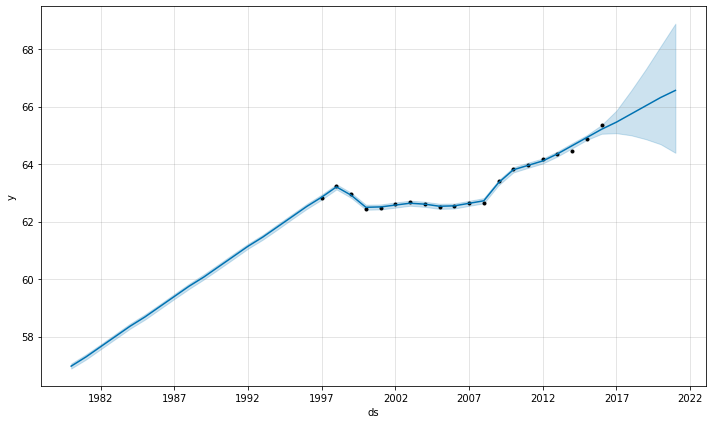

In [ ]:
evaluate_model_s(optimizer, can_data_s)

## China

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 9.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/qa0h_ork.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/b7q22vqs.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7167', 'data', 'file=/tmp/tmpb7lz_7lg/qa0h_ork.json', 'init=/tmp/tmpb7lz_7lg/b7q22vqs.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelulnejlxb/prophet_model-20221130044233.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:42:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdsta

|   iter    |  target   | yearly... |
-------------------------------------


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/uqrl0yd4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/w3kyjtq1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=88804', 'data', 'file=/tmp/tmpb7lz_7lg/uqrl0yd4.json', 'init=/tmp/tmpb7lz_7lg/w3kyjtq1.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelhoaoj_m6/prophet_model-20221130044233.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:42:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:42:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/zj5xqqz2.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.7996   | -0.3319   |


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/niaagu0f.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/xxymojb4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=81819', 'data', 'file=/tmp/tmpb7lz_7lg/niaagu0f.json', 'init=/tmp/tmpb7lz_7lg/xxymojb4.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelhajyaq3c/prophet_model-20221130044234.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:42:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:42:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ho4sq2kv.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.8409   | 0.8813    |


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/xss7dgm3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/euywi0xr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=95829', 'data', 'file=/tmp/tmpb7lz_7lg/xss7dgm3.json', 'init=/tmp/tmpb7lz_7lg/euywi0xr.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelzjdegx25/prophet_model-20221130044236.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:42:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:42:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/iynq6h8n.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -0.8401   | -2.0      |


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/x27njm9q.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/foy_a0tp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73138', 'data', 'file=/tmp/tmpb7lz_7lg/x27njm9q.json', 'init=/tmp/tmpb7lz_7lg/foy_a0tp.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelx3kbpls5/prophet_model-20221130044237.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:42:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:42:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/zzh8jvck.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.7671   | -0.7907   |


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/dar91kq4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ygqktetj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=62817', 'data', 'file=/tmp/tmpb7lz_7lg/dar91kq4.json', 'init=/tmp/tmpb7lz_7lg/ygqktetj.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model8_inbe_v/prophet_model-20221130044239.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:42:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:42:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/pmswie79.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.8265   | -1.413    |


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/o15rwzin.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/sx_wdidz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=46326', 'data', 'file=/tmp/tmpb7lz_7lg/o15rwzin.json', 'init=/tmp/tmpb7lz_7lg/sx_wdidz.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modellulxrq28/prophet_model-20221130044241.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:42:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:42:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/eum1ce4o.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.8277   | -1.631    |


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/5xeu3ttu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/kynj4xyr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=91669', 'data', 'file=/tmp/tmpb7lz_7lg/5xeu3ttu.json', 'init=/tmp/tmpb7lz_7lg/kynj4xyr.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeldoiwqlq5/prophet_model-20221130044243.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:42:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:42:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/oy6sb1jb.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.832    | -1.255    |


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/q7dltcg7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ntt5d4r9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=95152', 'data', 'file=/tmp/tmpb7lz_7lg/q7dltcg7.json', 'init=/tmp/tmpb7lz_7lg/ntt5d4r9.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelojbs48jb/prophet_model-20221130044244.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:42:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:42:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/olkip2ia.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.7841   | -0.6178   |


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/wnl6vyjm.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ajajg6j4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=14710', 'data', 'file=/tmp/tmpb7lz_7lg/wnl6vyjm.json', 'init=/tmp/tmpb7lz_7lg/ajajg6j4.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelk6n6wju3/prophet_model-20221130044246.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:42:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:42:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/4ctz4hwd.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -0.7972   | -0.4129   |


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/c988un93.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/7u2j_yph.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=98572', 'data', 'file=/tmp/tmpb7lz_7lg/c988un93.json', 'init=/tmp/tmpb7lz_7lg/7u2j_yph.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modellebxtv69/prophet_model-20221130044248.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:42:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:42:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/0veoq_om.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -0.8105   | 0.1553    |


04:42:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 2 forecasts with cutoffs between 2014-01-01 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/p9z40v9k.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/y_6048_v.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99705', 'data', 'file=/tmp/tmpb7lz_7lg/p9z40v9k.json', 'init=/tmp/tmpb7lz_7lg/y_6048_v.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model0fnuu5zk/prophet_model-20221130044249.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:42:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:42:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/vnzpfgte.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -0.9228   | 2.0       |


04:42:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 2 forecasts with cutoffs between 2014-01-01 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/0hnluc_p.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/jyk56ej9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=19201', 'data', 'file=/tmp/tmpb7lz_7lg/0hnluc_p.json', 'init=/tmp/tmpb7lz_7lg/jyk56ej9.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model7d1bh8vc/prophet_model-20221130044251.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:42:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:42:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/1brokbla.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.7517   | -0.8998   |


04:42:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 2 forecasts with cutoffs between 2014-01-01 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/e7ookgn8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/qcvwsp5d.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99663', 'data', 'file=/tmp/tmpb7lz_7lg/e7ookgn8.json', 'init=/tmp/tmpb7lz_7lg/qcvwsp5d.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelb2yv1x2l/prophet_model-20221130044253.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:42:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:42:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/bm258cek.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -0.8964   | 1.345     |


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/fdoa1vy9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/acvtonvv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=40795', 'data', 'file=/tmp/tmpb7lz_7lg/fdoa1vy9.json', 'init=/tmp/tmpb7lz_7lg/acvtonvv.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelm5hb31en/prophet_model-20221130044255.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:42:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:42:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/wsdx4ymi.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -0.7841   | -0.6178   |


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/rs10hiai.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/wqlknmaw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=3329', 'data', 'file=/tmp/tmpb7lz_7lg/rs10hiai.json', 'init=/tmp/tmpb7lz_7lg/wqlknmaw.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelvxqw9tt7/prophet_model-20221130044256.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:42:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:42:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/k7fvvmgj.json
DEBUG:cmdstanpy:input tempfile: 

Index(['ds', 'trend', 'yhat_lower', 'yhat_upper', 'trend_lower', 'trend_upper',
       'additive_terms', 'additive_terms_lower', 'additive_terms_upper',
       'yearly', 'yearly_lower', 'yearly_upper', 'multiplicative_terms',
       'multiplicative_terms_lower', 'multiplicative_terms_upper', 'yhat'],
      dtype='object')
|   iter    |  target   | yearly... |
-------------------------------------


  0%|          | 0/7 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/dqh67kkk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/153eu28s.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=76670', 'data', 'file=/tmp/tmpb7lz_7lg/dqh67kkk.json', 'init=/tmp/tmpb7lz_7lg/153eu28s.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model6q_gbyi9/prophet_model-20221130044259.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:42:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:42:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/snp0cvnl.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.9227   | -0.3319   |


INFO:prophet:Making 7 forecasts with cutoffs between 2014-01-03 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/7 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/qo2igoee.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/q3jrnxpl.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=20733', 'data', 'file=/tmp/tmpb7lz_7lg/qo2igoee.json', 'init=/tmp/tmpb7lz_7lg/q3jrnxpl.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model0gfdvot9/prophet_model-20221130044304.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:43:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:43:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/gti0pav2.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -1.002    | 0.8813    |


04:43:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 7 forecasts with cutoffs between 2014-01-03 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/7 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/cxwvzek_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/3bjpjf7o.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=17623', 'data', 'file=/tmp/tmpb7lz_7lg/cxwvzek_.json', 'init=/tmp/tmpb7lz_7lg/3bjpjf7o.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelnphzcsm6/prophet_model-20221130044310.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:43:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:43:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/fspb5bqs.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -0.9112   | -2.0      |


  0%|          | 0/7 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/vg0p45_j.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/z_fm1yce.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=9401', 'data', 'file=/tmp/tmpb7lz_7lg/vg0p45_j.json', 'init=/tmp/tmpb7lz_7lg/z_fm1yce.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model7u90hs3y/prophet_model-20221130044315.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:43:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:43:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/pib4uwbg.json
DEBUG:cmdstanpy:input tempfile: 

| 4         | -0.8951   | -0.7907   |


  0%|          | 0/7 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/tk2_fufg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/nab7nz8g.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36213', 'data', 'file=/tmp/tmpb7lz_7lg/tk2_fufg.json', 'init=/tmp/tmpb7lz_7lg/nab7nz8g.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelbw4zz4gn/prophet_model-20221130044321.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:43:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:43:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/7jzggldn.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.9114   | -1.413    |


04:43:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 7 forecasts with cutoffs between 2014-01-03 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/7 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/dmod7z41.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/eisizslo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=56119', 'data', 'file=/tmp/tmpb7lz_7lg/dmod7z41.json', 'init=/tmp/tmpb7lz_7lg/eisizslo.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelzgngcoo9/prophet_model-20221130044326.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:43:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:43:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/6b3874w0.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.911    | -1.631    |


  0%|          | 0/7 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/691tesii.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/csg4w49v.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57095', 'data', 'file=/tmp/tmpb7lz_7lg/691tesii.json', 'init=/tmp/tmpb7lz_7lg/csg4w49v.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelrtt3lc2e/prophet_model-20221130044333.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:43:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:43:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/d16kr6l6.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.9125   | -1.255    |


  0%|          | 0/7 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/hq5_uqzy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/7ju6ts06.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=47086', 'data', 'file=/tmp/tmpb7lz_7lg/hq5_uqzy.json', 'init=/tmp/tmpb7lz_7lg/7ju6ts06.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model1bnq7jns/prophet_model-20221130044338.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:43:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:43:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ql6wkgm0.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.8904   | -0.6178   |


  0%|          | 0/7 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/4k04oz_x.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/jncllqaf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=4504', 'data', 'file=/tmp/tmpb7lz_7lg/4k04oz_x.json', 'init=/tmp/tmpb7lz_7lg/jncllqaf.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeloq3f4_o_/prophet_model-20221130044343.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:43:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:43:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/k60cn6q4.json
DEBUG:cmdstanpy:input tempfile: 

| 9         | -0.9106   | -0.4129   |


INFO:prophet:Making 7 forecasts with cutoffs between 2014-01-03 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/7 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/jqfv40tv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/uhvff7bx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=1401', 'data', 'file=/tmp/tmpb7lz_7lg/jqfv40tv.json', 'init=/tmp/tmpb7lz_7lg/uhvff7bx.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelhh0y1ck3/prophet_model-20221130044349.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:43:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:43:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/owj5t0ep.json
DEBUG:cmdstanpy:input tempfile: 

| 10        | -0.9372   | 0.1553    |


04:43:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 7 forecasts with cutoffs between 2014-01-03 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/7 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/98ojdz_z.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/h1ai_qkm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=43789', 'data', 'file=/tmp/tmpb7lz_7lg/98ojdz_z.json', 'init=/tmp/tmpb7lz_7lg/h1ai_qkm.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model_aqw9ls3/prophet_model-20221130044354.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:43:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:43:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/h8ftpa1k.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -1.164    | 2.0       |


04:44:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 7 forecasts with cutoffs between 2014-01-03 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/7 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/5_476u9y.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/7q7p9gvz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89815', 'data', 'file=/tmp/tmpb7lz_7lg/5_476u9y.json', 'init=/tmp/tmpb7lz_7lg/7q7p9gvz.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelnp0rjhwg/prophet_model-20221130044400.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:44:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:44:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/vumzevxn.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.8889   | -0.6775   |


04:44:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 7 forecasts with cutoffs between 2014-01-03 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/7 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/6jtp5_us.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/_o6xc2mu.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=54923', 'data', 'file=/tmp/tmpb7lz_7lg/6jtp5_us.json', 'init=/tmp/tmpb7lz_7lg/_o6xc2mu.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelrzg06a8p/prophet_model-20221130044405.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:44:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:44:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/aawiwucg.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -0.8887   | -0.6721   |


04:44:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 7 forecasts with cutoffs between 2014-01-03 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/7 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/arr6zvmp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/hunpimqa.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=18447', 'data', 'file=/tmp/tmpb7lz_7lg/arr6zvmp.json', 'init=/tmp/tmpb7lz_7lg/hunpimqa.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model3wvtrvc9/prophet_model-20221130044411.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:44:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:44:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/0h8j9j7f.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -0.8888   | -0.6688   |


04:44:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 7 forecasts with cutoffs between 2014-01-03 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/7 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/tv9arwhx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/rffc93q2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=68552', 'data', 'file=/tmp/tmpb7lz_7lg/tv9arwhx.json', 'init=/tmp/tmpb7lz_7lg/rffc93q2.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelr_yp4sv7/prophet_model-20221130044417.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:44:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:44:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/dd_s1p63.json
DEBUG:cmdstanpy:input tempfile:

Index(['ds', 'trend', 'yhat_lower', 'yhat_upper', 'trend_lower', 'trend_upper',
       'additive_terms', 'additive_terms_lower', 'additive_terms_upper',
       'yearly', 'yearly_lower', 'yearly_upper', 'multiplicative_terms',
       'multiplicative_terms_lower', 'multiplicative_terms_upper', 'yhat'],
      dtype='object')
|   iter    |  target   | yearly... |
-------------------------------------


04:44:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/4rg3ima4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ejye_nk6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57866', 'data', 'file=/tmp/tmpb7lz_7lg/4rg3ima4.json', 'init=/tmp/tmpb7lz_7lg/ejye_nk6.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model7ef1odiq/prophet_model-20221130044424.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:44:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:44:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/2je1unm4.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -2.058    | -0.3319   |


04:44:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/7jv3wqcs.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/gmblmznt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=58307', 'data', 'file=/tmp/tmpb7lz_7lg/7jv3wqcs.json', 'init=/tmp/tmpb7lz_7lg/gmblmznt.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelh_6k4cte/prophet_model-20221130044445.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:44:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:44:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/kvs5l6cr.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -2.132    | 0.8813    |


04:45:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/y1ttcps3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/qg7mqnov.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=34947', 'data', 'file=/tmp/tmpb7lz_7lg/y1ttcps3.json', 'init=/tmp/tmpb7lz_7lg/qg7mqnov.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelx1nrsg3g/prophet_model-20221130044505.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:45:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:45:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/bknkp248.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -1.965    | -2.0      |


04:45:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/llbk4p9d.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/a21x47k9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=16949', 'data', 'file=/tmp/tmpb7lz_7lg/llbk4p9d.json', 'init=/tmp/tmpb7lz_7lg/a21x47k9.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model_8s403e6/prophet_model-20221130044526.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:45:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:45:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/qv7y9mu4.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -2.038    | -0.7907   |


04:45:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ewuibsh5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/9n8zjf9o.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=66561', 'data', 'file=/tmp/tmpb7lz_7lg/ewuibsh5.json', 'init=/tmp/tmpb7lz_7lg/9n8zjf9o.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelf1jf06cr/prophet_model-20221130044546.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:45:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:45:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/5bintpht.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -2.056    | -1.413    |


04:46:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/vqv3zkoi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/1f92iz85.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=85715', 'data', 'file=/tmp/tmpb7lz_7lg/vqv3zkoi.json', 'init=/tmp/tmpb7lz_7lg/1f92iz85.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model_hzyls0c/prophet_model-20221130044607.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:46:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:46:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/y4__gapv.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -1.994    | -1.631    |


04:46:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/rbfub6v_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/0nr1fexo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70434', 'data', 'file=/tmp/tmpb7lz_7lg/rbfub6v_.json', 'init=/tmp/tmpb7lz_7lg/0nr1fexo.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelv3oia7n3/prophet_model-20221130044628.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:46:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:46:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ael9pa10.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -2.046    | -1.255    |


04:46:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/bc1nfjx_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/_ap0kevx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=2356', 'data', 'file=/tmp/tmpb7lz_7lg/bc1nfjx_.json', 'init=/tmp/tmpb7lz_7lg/_ap0kevx.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeltzp9axjh/prophet_model-20221130044648.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:46:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:46:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/7uxrbfvd.json
DEBUG:cmdstanpy:input tempfile: 

| 8         | -2.044    | -0.6178   |


04:47:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/p6jc1pfc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/uu1q8ld2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=55433', 'data', 'file=/tmp/tmpb7lz_7lg/p6jc1pfc.json', 'init=/tmp/tmpb7lz_7lg/uu1q8ld2.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model1jdxvamb/prophet_model-20221130044709.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:47:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:47:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/64k9544b.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -2.059    | -0.4129   |


04:47:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/l6fl0kqy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/mkaaqmu1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=86192', 'data', 'file=/tmp/tmpb7lz_7lg/l6fl0kqy.json', 'init=/tmp/tmpb7lz_7lg/mkaaqmu1.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelldqg75ul/prophet_model-20221130044730.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:47:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:47:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/4c1hqd_k.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -2.08     | 0.1553    |


04:47:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/nt1z8e3n.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/2xtwyrxg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=41269', 'data', 'file=/tmp/tmpb7lz_7lg/nt1z8e3n.json', 'init=/tmp/tmpb7lz_7lg/2xtwyrxg.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelsg0cr5qc/prophet_model-20221130044752.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:47:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:47:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/tleuyexi.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -1.967    | -1.839    |


04:48:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/4z1m352h.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/su2jq36g.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=38100', 'data', 'file=/tmp/tmpb7lz_7lg/4z1m352h.json', 'init=/tmp/tmpb7lz_7lg/su2jq36g.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeldkoablfp/prophet_model-20221130044813.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:48:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:48:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/srf3c7sq.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -2.078    | 2.0       |


04:48:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/h7k72bom.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/oou36l92.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=26522', 'data', 'file=/tmp/tmpb7lz_7lg/h7k72bom.json', 'init=/tmp/tmpb7lz_7lg/oou36l92.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelfml09xb7/prophet_model-20221130044834.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:48:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:48:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/6oa5jkbz.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -1.969    | -1.929    |


04:48:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/dj4sbz94.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ifwtq4oq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=25300', 'data', 'file=/tmp/tmpb7lz_7lg/dj4sbz94.json', 'init=/tmp/tmpb7lz_7lg/ifwtq4oq.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelu0a4i4v6/prophet_model-20221130044855.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:48:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:48:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/xec9te6w.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -1.991    | -1.631    |


04:49:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/qxwn0cy7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/7znppeb6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=10833', 'data', 'file=/tmp/tmpb7lz_7lg/qxwn0cy7.json', 'init=/tmp/tmpb7lz_7lg/7znppeb6.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeltzu3aumx/prophet_model-20221130044916.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:49:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:49:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ufki65fd.json
DEBUG:cmdstanpy:input tempfile:

|   iter    |  target   | yearly... |
-------------------------------------


04:49:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/pozq46ao.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/yql5onjm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=1210', 'data', 'file=/tmp/tmpb7lz_7lg/pozq46ao.json', 'init=/tmp/tmpb7lz_7lg/yql5onjm.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelaxywxv5w/prophet_model-20221130044938.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:49:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:49:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/k8k8daeq.json
DEBUG:cmdstanpy:input tempfile: 

| 1         | -2.032    | -0.3319   |


04:50:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/207ormlr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/9is4b09k.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=16546', 'data', 'file=/tmp/tmpb7lz_7lg/207ormlr.json', 'init=/tmp/tmpb7lz_7lg/9is4b09k.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeli52dua3u/prophet_model-20221130045003.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:50:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:50:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/z4had92b.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -2.157    | 0.8813    |


04:50:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/1iqynifi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/9_kf1cnm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=75945', 'data', 'file=/tmp/tmpb7lz_7lg/1iqynifi.json', 'init=/tmp/tmpb7lz_7lg/9_kf1cnm.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelt_75ke3b/prophet_model-20221130045030.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:50:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:50:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/kiqw8sgj.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -1.946    | -2.0      |


04:50:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/62_cw2ae.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/grsaquh0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=31820', 'data', 'file=/tmp/tmpb7lz_7lg/62_cw2ae.json', 'init=/tmp/tmpb7lz_7lg/grsaquh0.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeldf5mo8t_/prophet_model-20221130045056.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:50:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:50:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/33n0gxng.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -2.005    | -0.7907   |


04:51:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/fms1yg1c.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/tr151wje.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=80165', 'data', 'file=/tmp/tmpb7lz_7lg/fms1yg1c.json', 'init=/tmp/tmpb7lz_7lg/tr151wje.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model0dlox44t/prophet_model-20221130045122.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:51:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:51:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/_5zo3da9.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -2.016    | -1.413    |


04:51:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/r1v6afvf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/xn3jdf6l.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=71229', 'data', 'file=/tmp/tmpb7lz_7lg/r1v6afvf.json', 'init=/tmp/tmpb7lz_7lg/xn3jdf6l.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelmkyx0n_j/prophet_model-20221130045148.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:51:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:51:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/dx3c81n9.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -1.973    | -1.631    |


04:52:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/wdi762fx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/4p3hq_gz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=78378', 'data', 'file=/tmp/tmpb7lz_7lg/wdi762fx.json', 'init=/tmp/tmpb7lz_7lg/4p3hq_gz.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelzlrh2r5o/prophet_model-20221130045214.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:52:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:52:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/6sw3hm1q.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -2.025    | -1.255    |


04:52:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/_206fb_l.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/lmke99jk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36196', 'data', 'file=/tmp/tmpb7lz_7lg/_206fb_l.json', 'init=/tmp/tmpb7lz_7lg/lmke99jk.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelkz3p2h7q/prophet_model-20221130045239.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:52:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:52:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/5rdts4wz.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -2.015    | -0.6178   |


04:53:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/xk1jq2a_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/eipshjvb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=68169', 'data', 'file=/tmp/tmpb7lz_7lg/xk1jq2a_.json', 'init=/tmp/tmpb7lz_7lg/eipshjvb.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelg__89spr/prophet_model-20221130045305.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:53:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:53:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/1b37ivkc.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -2.026    | -0.4129   |


04:53:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/m98vci8h.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/tfjy6dle.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=35533', 'data', 'file=/tmp/tmpb7lz_7lg/m98vci8h.json', 'init=/tmp/tmpb7lz_7lg/tfjy6dle.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelzedc3izk/prophet_model-20221130045331.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:53:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:53:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/pl02morq.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -2.066    | 0.1553    |


04:53:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/hi45yj_x.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/hsm_luii.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=23422', 'data', 'file=/tmp/tmpb7lz_7lg/hi45yj_x.json', 'init=/tmp/tmpb7lz_7lg/hsm_luii.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model94dn4_v5/prophet_model-20221130045358.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:53:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:53:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/4aqyuch_.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -2.06     | 2.0       |


04:54:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/rfw1tzfw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/e0b3tlwk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=19614', 'data', 'file=/tmp/tmpb7lz_7lg/rfw1tzfw.json', 'init=/tmp/tmpb7lz_7lg/e0b3tlwk.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_models_hfr22j/prophet_model-20221130045425.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:54:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:54:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/vmy5u7qj.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -1.948    | -1.864    |


04:54:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/uuql8e75.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/5alf852v.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=43617', 'data', 'file=/tmp/tmpb7lz_7lg/uuql8e75.json', 'init=/tmp/tmpb7lz_7lg/5alf852v.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model40bhj0_s/prophet_model-20221130045453.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:54:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:54:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/t8xulmu1.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -1.947    | -1.983    |


04:55:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/8dxk9z21.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/djhy2cr0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12587', 'data', 'file=/tmp/tmpb7lz_7lg/8dxk9z21.json', 'init=/tmp/tmpb7lz_7lg/djhy2cr0.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeladk34ixn/prophet_model-20221130045519.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:55:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:55:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/mvy8j8sd.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -1.946    | -2.0      |


04:55:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/5e582pwq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/xf5pssky.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=58982', 'data', 'file=/tmp/tmpb7lz_7lg/5e582pwq.json', 'init=/tmp/tmpb7lz_7lg/xf5pssky.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model26tbdyjz/prophet_model-20221130045545.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:55:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:55:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/_22heqgx.json
DEBUG:cmdstanpy:input tempfile:

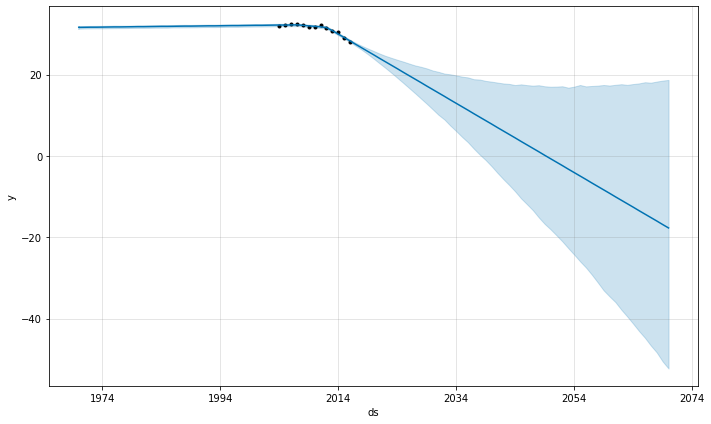

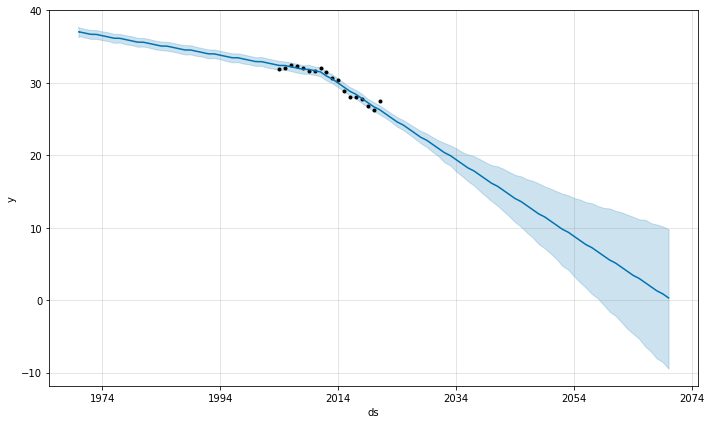

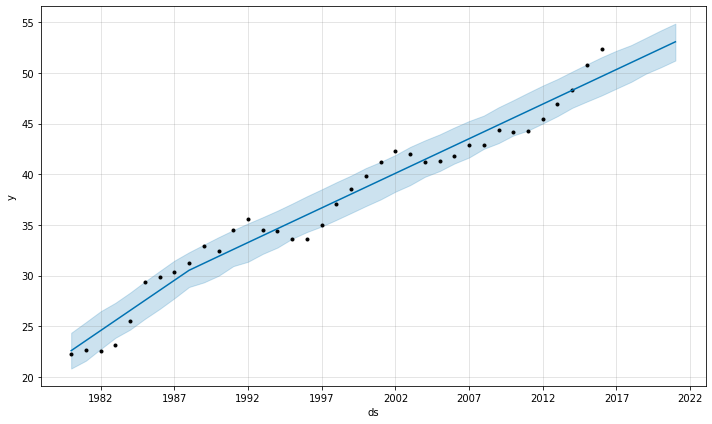

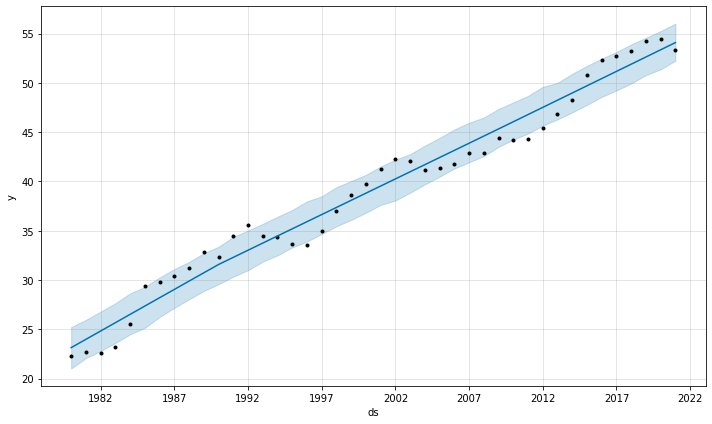

In [92]:
generate_results_m(chn_data_m, "CHN")
generate_results_s(chn_data_s, "CHN")

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 9.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/4j7cshl5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/img7g1s8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63901', 'data', 'file=/tmp/tmpjad4h45l/4j7cshl5.json', 'init=/tmp/tmpjad4h45l/img7g1s8.json', 'output', 'file=/tmp/tmpjad4h45l/prophet_modelqtmmwte0/prophet_model-20221022001437.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:14:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:14:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cm

--------------------Evaluation---------------------
MSE :  0.022481336286776073
MAE :  0.12671030488005214
MAPE :  0.4343821396244114
--------------------Evaluation---------------------


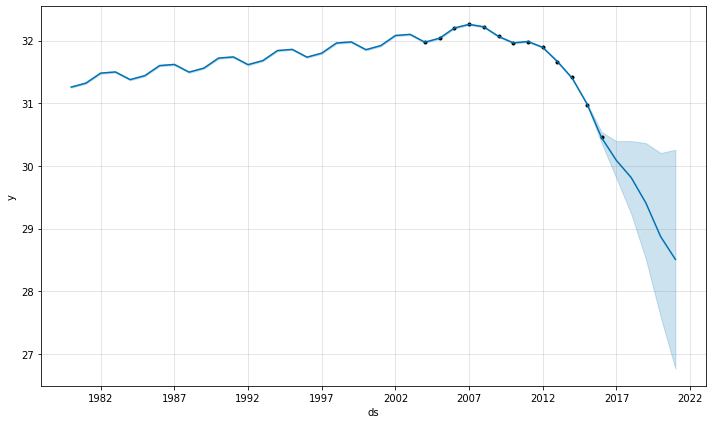

In [ ]:
  `fit_model_m(chn_data_m)

In [ ]:
optimizer,_ ,_ = getOpt(chn_data_m)

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 9.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/bx6nm6w7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/xdxv89r2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=1956', 'data', 'file=/tmp/tmppq7tkcfl/bx6nm6w7.json', 'init=/tmp/tmppq7tkcfl/xdxv89r2.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model7rjwnlxw/prophet_model-20221113234119.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:41:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdsta

|   iter    |  target   | yearly... |
-------------------------------------


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/sh1iizvl.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/igvx89d0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=8163', 'data', 'file=/tmp/tmppq7tkcfl/sh1iizvl.json', 'init=/tmp/tmppq7tkcfl/igvx89d0.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelzshwk1_r/prophet_model-20221113234120.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:41:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:41:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/0wgtr8wh.json
DEBUG:cmdstanpy:input tempfile: 

| 1         | -0.2905   | -0.3319   |


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/oapgdp2m.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/1i7kxfyc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=81948', 'data', 'file=/tmp/tmppq7tkcfl/oapgdp2m.json', 'init=/tmp/tmppq7tkcfl/1i7kxfyc.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model2p89lllt/prophet_model-20221113234121.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:41:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:41:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ixx6xp3z.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.2824   | 0.8813    |


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/6oytafaj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/taug22gk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=49045', 'data', 'file=/tmp/tmppq7tkcfl/6oytafaj.json', 'init=/tmp/tmppq7tkcfl/taug22gk.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model1nac8pxc/prophet_model-20221113234123.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:41:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:41:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/_g_qj9oo.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -0.2893   | -2.0      |


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/cftm3116.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/1p2eut9x.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=14648', 'data', 'file=/tmp/tmppq7tkcfl/cftm3116.json', 'init=/tmp/tmppq7tkcfl/1p2eut9x.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelfmg978px/prophet_model-20221113234125.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:41:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:41:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/5d641j_f.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.2913   | -0.7907   |


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/szjqyagg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/rknql29o.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=86866', 'data', 'file=/tmp/tmppq7tkcfl/szjqyagg.json', 'init=/tmp/tmppq7tkcfl/rknql29o.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model9xuk1q0z/prophet_model-20221113234127.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:41:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:41:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ad8fajsd.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.2964   | -1.413    |


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/q5f6t6qk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/tcslmbet.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=88651', 'data', 'file=/tmp/tmppq7tkcfl/q5f6t6qk.json', 'init=/tmp/tmppq7tkcfl/tcslmbet.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model3lj_uezq/prophet_model-20221113234128.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:41:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:41:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/htg1jvxf.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.2938   | -1.631    |


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/2nb3mjix.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/0u54_myg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=65403', 'data', 'file=/tmp/tmppq7tkcfl/2nb3mjix.json', 'init=/tmp/tmppq7tkcfl/0u54_myg.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelzr_6uccy/prophet_model-20221113234130.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:41:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:41:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/57iyplwa.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.2958   | -1.255    |


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/26ofcarb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/4spfnmwq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=96541', 'data', 'file=/tmp/tmppq7tkcfl/26ofcarb.json', 'init=/tmp/tmppq7tkcfl/4spfnmwq.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model_t9ktzux/prophet_model-20221113234132.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:41:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:41:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/g9hmf6p7.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.2909   | -0.6178   |


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/n0i3h5pa.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/nht1l1bo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99214', 'data', 'file=/tmp/tmppq7tkcfl/n0i3h5pa.json', 'init=/tmp/tmppq7tkcfl/nht1l1bo.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelxb0o9xlm/prophet_model-20221113234133.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:41:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:41:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/kdtzvdh9.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -0.2905   | -0.4129   |


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/azyq87dk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/seyfo0o5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=91853', 'data', 'file=/tmp/tmppq7tkcfl/azyq87dk.json', 'init=/tmp/tmppq7tkcfl/seyfo0o5.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelklpycy1t/prophet_model-20221113234135.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:41:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:41:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/fqulqt6z.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -0.2896   | 0.1553    |


23:41:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 2 forecasts with cutoffs between 2014-01-01 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/oyt4gqgc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/lpfc42z3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=69830', 'data', 'file=/tmp/tmppq7tkcfl/oyt4gqgc.json', 'init=/tmp/tmppq7tkcfl/lpfc42z3.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelb87kh4ub/prophet_model-20221113234137.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:41:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:41:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/pfz4qub4.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -0.2815   | 1.332     |


23:41:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 2 forecasts with cutoffs between 2014-01-01 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/7gtjnvao.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/3kqv0ks_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=34377', 'data', 'file=/tmp/tmppq7tkcfl/7gtjnvao.json', 'init=/tmp/tmppq7tkcfl/3kqv0ks_.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model6dujm_nk/prophet_model-20221113234139.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:41:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:41:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/d7lktaxh.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.2811   | 2.0       |


23:41:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 2 forecasts with cutoffs between 2014-01-01 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/dlc4kmbm.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/20awhuts.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37242', 'data', 'file=/tmp/tmppq7tkcfl/dlc4kmbm.json', 'init=/tmp/tmppq7tkcfl/20awhuts.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model4sqndiow/prophet_model-20221113234141.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:41:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:41:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/vf8ik4ce.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -0.2813   | 1.704     |


23:41:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 2 forecasts with cutoffs between 2014-01-01 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/cxfll1n7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/cf6qvn4w.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=62610', 'data', 'file=/tmp/tmppq7tkcfl/cxfll1n7.json', 'init=/tmp/tmppq7tkcfl/cf6qvn4w.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelshapgvfa/prophet_model-20221113234143.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:41:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:41:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/2v_u0jjw.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -0.2811   | 1.117     |


INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 9.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/rg8txia9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/6k6rxvcb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=33503', 'data', 'file=/tmp/tmppq7tkcfl/rg8txia9.json', 'init=/tmp/tmppq7tkcfl/6k6rxvcb.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelmr4kbq8z/prophet_model-20221113234145.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:41:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdst

  0%|          | 0/2 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/9m_p_v13.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/s7b_dlw6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=9215', 'data', 'file=/tmp/tmppq7tkcfl/9m_p_v13.json', 'init=/tmp/tmppq7tkcfl/s7b_dlw6.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model2g1ch8ra/prophet_model-20221113234145.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:41:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:41:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/zrb5g_m1.json
DEBUG:cmdstanpy:input tempfile: 

--------------------Evaluation---------------------
MSE :  0.016552281133661684
MAE :  0.0989317874108309
MAPE :  0.3422604755932048
--------------------Evaluation---------------------


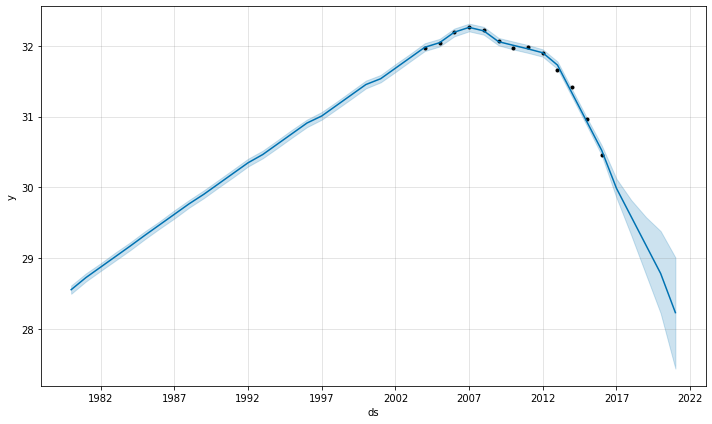

In [ ]:
evaluate_model(optimizer, chn_data_m)

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/cqyilr42.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/l41_nsj1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=43386', 'data', 'file=/tmp/tmpjad4h45l/cqyilr42.json', 'init=/tmp/tmpjad4h45l/l41_nsj1.json', 'output', 'file=/tmp/tmpjad4h45l/prophet_modelt81onsg8/prophet_model-20221022001459.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:14:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:15:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


--------------------Evaluation---------------------
MSE :  1.922365173046331
MAE :  1.3725373015585318
MAPE :  2.7887979196880543
--------------------Evaluation---------------------


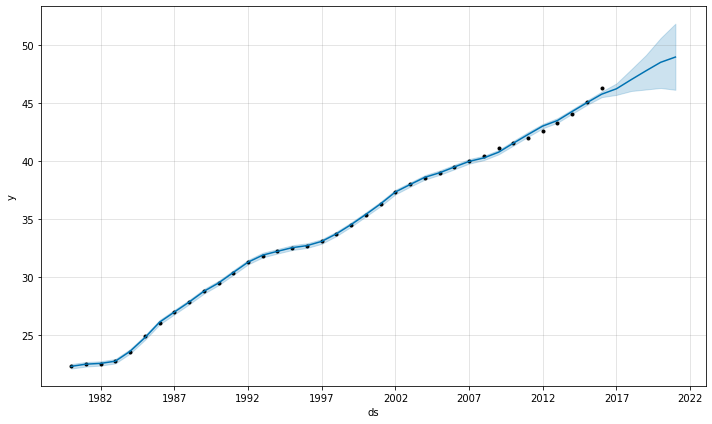

In [ ]:
fit_model_s(chn_data_s)

In [ ]:
optimizer, _, _ = getOpt_s(chn_data_s)

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


|   iter    |  target   | yearly... |
-------------------------------------


DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/x_i_dbik.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/p1tk952q.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=3213', 'data', 'file=/tmp/tmppq7tkcfl/x_i_dbik.json', 'init=/tmp/tmppq7tkcfl/p1tk952q.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model3oua64cl/prophet_model-20221114001810.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:18:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:18:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/zuseehnj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/zj_srmh2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=40410', 'data', 'file=/tmp/tmppq7tkcfl/zuseehnj.json', 'init=/tmp/tmppq7tkcfl/zj_srmh2.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelahqzc80c/prophet_model-20221114001810.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:18:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:18:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/4hshxz3u.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.5228   | -0.3319   |


00:18:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ai1kelt2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/1peuuhsv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=78030', 'data', 'file=/tmp/tmppq7tkcfl/ai1kelt2.json', 'init=/tmp/tmppq7tkcfl/1peuuhsv.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelh8qdg8x0/prophet_model-20221114001833.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:18:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:18:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/zmie6lze.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.5292   | 0.8813    |


00:18:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/e88k_dyi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/5v6olikp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=13193', 'data', 'file=/tmp/tmppq7tkcfl/e88k_dyi.json', 'init=/tmp/tmppq7tkcfl/5v6olikp.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeljwsjz7zd/prophet_model-20221114001855.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:18:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:18:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/tp2lfc13.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -0.5143   | -2.0      |


00:19:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/eo7sjt0l.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/cww0fnq3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=85514', 'data', 'file=/tmp/tmppq7tkcfl/eo7sjt0l.json', 'init=/tmp/tmppq7tkcfl/cww0fnq3.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelo4z_ldvk/prophet_model-20221114001919.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:19:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:19:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/66type2d.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.5076   | -0.7907   |


00:19:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/vh_wzuun.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ohj_uzyo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=35222', 'data', 'file=/tmp/tmppq7tkcfl/vh_wzuun.json', 'init=/tmp/tmppq7tkcfl/ohj_uzyo.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelbstxkwki/prophet_model-20221114001942.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:19:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:19:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/rp0rczs9.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.5218   | -1.413    |


00:20:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/03lt03wu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/i7dge0o5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70407', 'data', 'file=/tmp/tmppq7tkcfl/03lt03wu.json', 'init=/tmp/tmppq7tkcfl/i7dge0o5.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeld6939xc3/prophet_model-20221114002006.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:20:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:20:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/khpe5euf.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.4992   | -1.631    |


00:20:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/jys87ptb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/c3nmetdr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=10347', 'data', 'file=/tmp/tmppq7tkcfl/jys87ptb.json', 'init=/tmp/tmppq7tkcfl/c3nmetdr.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelbyecthwa/prophet_model-20221114002029.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:20:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:20:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/zpy_afbz.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.5232   | -1.255    |


00:20:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/1defnkht.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/0b_fqg30.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=15396', 'data', 'file=/tmp/tmppq7tkcfl/1defnkht.json', 'init=/tmp/tmppq7tkcfl/0b_fqg30.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model4w_gd9uo/prophet_model-20221114002053.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:20:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:20:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ibwun5ga.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.5375   | -0.6178   |


00:21:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/m1nbr0vd.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/23kxkl03.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=65493', 'data', 'file=/tmp/tmppq7tkcfl/m1nbr0vd.json', 'init=/tmp/tmppq7tkcfl/23kxkl03.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeltne7s4e8/prophet_model-20221114002115.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:21:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:21:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/obtpml_2.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -0.5184   | -0.4129   |


00:21:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/_7r22lp8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/flrw39w_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=66855', 'data', 'file=/tmp/tmppq7tkcfl/_7r22lp8.json', 'init=/tmp/tmppq7tkcfl/flrw39w_.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model0jb0v0hz/prophet_model-20221114002139.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:21:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:21:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/peevdrb6.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -0.5332   | 0.1553    |


00:22:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/faun4jxo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/m1f_k2sq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=332', 'data', 'file=/tmp/tmppq7tkcfl/faun4jxo.json', 'init=/tmp/tmppq7tkcfl/m1f_k2sq.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelk24ahhd7/prophet_model-20221114002202.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:22:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:22:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/z78gwufp.json
DEBUG:cmdstanpy:input tempfile: /

| 11        | -0.5144   | -2.0      |


DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=74495', 'data', 'file=/tmp/tmppq7tkcfl/e7o0hffr.json', 'init=/tmp/tmppq7tkcfl/kijcb6a0.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model49homepn/prophet_model-20221114002226.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:22:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:22:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/cqiwahrs.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/cmligl46.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=10727', 'data', 'file=/tmp/tmppq7tkcfl/cqiwahrs.json', 'init=/tmp/tmppq7tkcfl/cmligl46.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelw0n6we_q/prophet_model-20221114002227.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:22:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:22:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/d9edtea6.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.5054   | -1.638    |


DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/e0lcyd_h.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=58048', 'data', 'file=/tmp/tmppq7tkcfl/0l37jt9y.json', 'init=/tmp/tmppq7tkcfl/e0lcyd_h.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelxwv5spmc/prophet_model-20221114002249.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:22:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:22:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/m2gqb7zs.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/n9kbyt_t.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=8254', 'data', 'file=/tmp/tmppq7tkcfl/m2gqb7zs.json', 'init=/tmp/tmppq7tkcfl/n9kbyt_t.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model0r4d4wms/prophet_model-20221114002250.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:22:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:22:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/kcn0pq7u.json
DEBUG:cmdstanpy:input tempfile: 

| 13        | -0.5309   | -1.619    |


DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/o7dmew6v.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/zr2mwmyg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60481', 'data', 'file=/tmp/tmppq7tkcfl/o7dmew6v.json', 'init=/tmp/tmppq7tkcfl/zr2mwmyg.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelfyl8keba/prophet_model-20221114002314.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:23:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:23:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/pj1up6gg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/oxy9fpe2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=5773', 'data', 'file=/tmp/tmppq7tkcfl/pj1up6gg.json', 'init=/tmp/tmppq7tkcfl/oxy9fpe2.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model9wdok2zn/prophet_model-20221114002314.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:23:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:23:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/5dslp37y.json
DEBUG:cmdstanpy:input tempfile: 

| 14        | -0.525    | -0.7823   |


INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ggptzt1y.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/j2suuqfc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=97929', 'data', 'file=/tmp/tmppq7tkcfl/ggptzt1y.json', 'init=/tmp/tmppq7tkcfl/j2suuqfc.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelp_5g3rdo/prophet_model-20221114002337.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:23:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:23:37 - cmdstanpy - INFO - Chain [1] do

  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/st9adahq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/rj8742yn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=33577', 'data', 'file=/tmp/tmppq7tkcfl/st9adahq.json', 'init=/tmp/tmppq7tkcfl/rj8742yn.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model1hykwa63/prophet_model-20221114002337.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:23:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:23:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/wgnnfy8h.json
DEBUG:cmdstanpy:input tempfile:

--------------------Evaluation---------------------
MSE :  3.0880286740140557
MAE :  1.7258667196927362
MAPE :  3.503102647155612
--------------------Evaluation---------------------


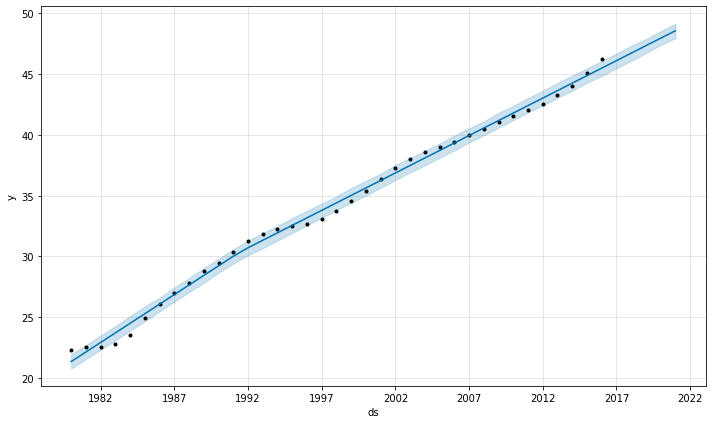

In [ ]:
evaluate_model_s(optimizer, chn_data_s)

## The United Kingdom

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 20.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/jl93j6wk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ihg3ms49.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=15133', 'data', 'file=/tmp/tmpu84toiig/jl93j6wk.json', 'init=/tmp/tmpu84toiig/ihg3ms49.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model3df_er4n/prophet_model-20221130153122.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:31:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmds

|   iter    |  target   | yearly... |
-------------------------------------


15:31:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/gzyapmus.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/r0x8aj70.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=91068', 'data', 'file=/tmp/tmpu84toiig/gzyapmus.json', 'init=/tmp/tmpu84toiig/r0x8aj70.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelz024l9nc/prophet_model-20221130153122.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:31:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:31:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ui9ew1qk.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.7166   | -0.3319   |


15:31:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/zrsk5gjv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/lvb40lv1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=49596', 'data', 'file=/tmp/tmpu84toiig/zrsk5gjv.json', 'init=/tmp/tmpu84toiig/lvb40lv1.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelrp49i7m_/prophet_model-20221130153135.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:31:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:31:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/d4ulcgi2.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.8239   | 0.8813    |


15:31:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/9qh4hh9i.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/3qa9ed02.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=3242', 'data', 'file=/tmp/tmpu84toiig/9qh4hh9i.json', 'init=/tmp/tmpu84toiig/3qa9ed02.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model7z6etms9/prophet_model-20221130153152.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:31:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:31:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/7homp2et.json
DEBUG:cmdstanpy:input tempfile: 

| 3         | -0.7351   | -2.0      |


INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/o5tcqe_b.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/701s2_f8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=76068', 'data', 'file=/tmp/tmpu84toiig/o5tcqe_b.json', 'init=/tmp/tmpu84toiig/701s2_f8.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model8o18fy_a/prophet_model-20221130153204.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:32:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:32:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/_692xot9.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.7113   | -0.7907   |


15:32:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/jme1gfm9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/hl74obvz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=22033', 'data', 'file=/tmp/tmpu84toiig/jme1gfm9.json', 'init=/tmp/tmpu84toiig/hl74obvz.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelifxu3x5o/prophet_model-20221130153216.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:32:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:32:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ud7fvtn_.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.7077   | -1.413    |


15:32:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/82sx14fu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/tkli3lse.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=95100', 'data', 'file=/tmp/tmpu84toiig/82sx14fu.json', 'init=/tmp/tmpu84toiig/tkli3lse.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model75vfd64e/prophet_model-20221130153228.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:32:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:32:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/0im4iztl.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.7051   | -1.631    |


15:32:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/jyv63qte.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/t0xhrngp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=43190', 'data', 'file=/tmp/tmpu84toiig/jyv63qte.json', 'init=/tmp/tmpu84toiig/t0xhrngp.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model2o_2l0bq/prophet_model-20221130153240.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:32:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:32:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/lauhk4m3.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.7184   | -1.255    |


INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/cpft818k.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/zx3fcjrs.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=72276', 'data', 'file=/tmp/tmpu84toiig/cpft818k.json', 'init=/tmp/tmpu84toiig/zx3fcjrs.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modeljwzdj35q/prophet_model-20221130153252.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:32:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:32:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/fqz9l297.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.7404   | -0.6178   |


15:33:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/9bx8l1lo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/vtidrlyc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=41205', 'data', 'file=/tmp/tmpu84toiig/9bx8l1lo.json', 'init=/tmp/tmpu84toiig/vtidrlyc.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelw6rtbvl7/prophet_model-20221130153305.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:33:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:33:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ylt1kxs0.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -0.7259   | -0.4129   |


INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/6gwei8vu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/d1zp060n.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=56544', 'data', 'file=/tmp/tmpu84toiig/6gwei8vu.json', 'init=/tmp/tmpu84toiig/d1zp060n.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modeleyebdzab/prophet_model-20221130153317.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:33:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:33:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/g3kw3nf9.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -0.7465   | 0.1553    |


15:33:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/gxs_u_02.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/83j1hty_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=47502', 'data', 'file=/tmp/tmpu84toiig/gxs_u_02.json', 'init=/tmp/tmpu84toiig/83j1hty_.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model925l6mwu/prophet_model-20221130153329.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:33:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:33:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/t9b47xbp.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -0.8319   | 2.0       |


15:33:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/kuixg09o.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/eg_h4nbx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12593', 'data', 'file=/tmp/tmpu84toiig/kuixg09o.json', 'init=/tmp/tmpu84toiig/eg_h4nbx.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model6cwdl07a/prophet_model-20221130153341.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:33:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:33:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/v8wcncga.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.7115   | -0.9845   |


15:33:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/58w3b6vw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ja_f9oct.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=93572', 'data', 'file=/tmp/tmpu84toiig/58w3b6vw.json', 'init=/tmp/tmpu84toiig/ja_f9oct.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelzvsv5xn3/prophet_model-20221130153354.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:33:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:33:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/07oq600_.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -0.701    | -0.1081   |


15:34:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/zvnhnflt.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/svj8ntuj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=11829', 'data', 'file=/tmp/tmpu84toiig/zvnhnflt.json', 'init=/tmp/tmpu84toiig/svj8ntuj.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelj1hoqh6v/prophet_model-20221130153406.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:34:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:34:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/szstgequ.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -0.7185   | -1.255    |


15:34:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/myyzzf1y.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/owhf17aw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=54057', 'data', 'file=/tmp/tmpu84toiig/myyzzf1y.json', 'init=/tmp/tmpu84toiig/owhf17aw.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model4utg_clh/prophet_model-20221130153418.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:34:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:34:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/xwqat9bl.json
DEBUG:cmdstanpy:input tempfile:

Index(['ds', 'trend', 'yhat_lower', 'yhat_upper', 'trend_lower', 'trend_upper',
       'additive_terms', 'additive_terms_lower', 'additive_terms_upper',
       'yearly', 'yearly_lower', 'yearly_upper', 'multiplicative_terms',
       'multiplicative_terms_lower', 'multiplicative_terms_upper', 'yhat'],
      dtype='object')
|   iter    |  target   | yearly... |
-------------------------------------


15:34:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/xoixycai.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/udjghavw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=44498', 'data', 'file=/tmp/tmpu84toiig/xoixycai.json', 'init=/tmp/tmpu84toiig/udjghavw.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model9vygpvvk/prophet_model-20221130153433.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:34:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:34:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/wpfg7yy3.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.6272   | -0.3319   |


15:34:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/kyawvewt.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/zee9y41c.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=45283', 'data', 'file=/tmp/tmpu84toiig/kyawvewt.json', 'init=/tmp/tmpu84toiig/zee9y41c.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modell0klbqyj/prophet_model-20221130153450.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:34:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:34:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/z0v9lddo.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.721    | 0.8813    |


15:35:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/g8xdylkp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/m50snd1s.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=94611', 'data', 'file=/tmp/tmpu84toiig/g8xdylkp.json', 'init=/tmp/tmpu84toiig/m50snd1s.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelu984khm4/prophet_model-20221130153506.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:35:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:35:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/rxbn30eu.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -0.6431   | -2.0      |


15:35:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/9i_8madh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/q1f2cshp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=72839', 'data', 'file=/tmp/tmpu84toiig/9i_8madh.json', 'init=/tmp/tmpu84toiig/q1f2cshp.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelt8402lc4/prophet_model-20221130153523.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:35:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:35:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/qbhg8opf.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.6224   | -0.7907   |


15:35:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/489bj9vy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/l1jm3mwl.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=98445', 'data', 'file=/tmp/tmpu84toiig/489bj9vy.json', 'init=/tmp/tmpu84toiig/l1jm3mwl.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelakymgpoi/prophet_model-20221130153540.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:35:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:35:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/do4exexm.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.619    | -1.413    |


15:35:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/xfb9ne4y.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/iz41rqaa.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63475', 'data', 'file=/tmp/tmpu84toiig/xfb9ne4y.json', 'init=/tmp/tmpu84toiig/iz41rqaa.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelz1biqfvz/prophet_model-20221130153557.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:35:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:35:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/7ucc_21o.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.6169   | -1.631    |


15:36:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/3tp9exk3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/cug8iga4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=35028', 'data', 'file=/tmp/tmpu84toiig/3tp9exk3.json', 'init=/tmp/tmpu84toiig/cug8iga4.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modell2ze5no5/prophet_model-20221130153614.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:36:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:36:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/h7vmdct5.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.6289   | -1.255    |


15:36:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/m6qsaczn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/cx4nua1c.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=65490', 'data', 'file=/tmp/tmpu84toiig/m6qsaczn.json', 'init=/tmp/tmpu84toiig/cx4nua1c.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model8uf1drt6/prophet_model-20221130153631.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:36:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:36:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/hq4we9qr.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.6477   | -0.6178   |


15:36:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/_b8wkmbs.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/lcpabxq2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=6666', 'data', 'file=/tmp/tmpu84toiig/_b8wkmbs.json', 'init=/tmp/tmpu84toiig/lcpabxq2.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelyazpk5vy/prophet_model-20221130153648.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:36:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:36:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/003kgfp0.json
DEBUG:cmdstanpy:input tempfile: 

| 9         | -0.6353   | -0.4129   |


15:37:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/kjmxeb3r.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/1dptaot3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89266', 'data', 'file=/tmp/tmpu84toiig/kjmxeb3r.json', 'init=/tmp/tmpu84toiig/1dptaot3.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model6pe0fhq1/prophet_model-20221130153705.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:37:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:37:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/8fjmwdzz.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -0.6532   | 0.1553    |


15:37:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/w0hwyy_i.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/uhf62qs5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=52820', 'data', 'file=/tmp/tmpu84toiig/w0hwyy_i.json', 'init=/tmp/tmpu84toiig/uhf62qs5.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelo6k0d2cl/prophet_model-20221130153722.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:37:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:37:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/p4vjoq2p.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -0.7499   | 2.0       |


15:37:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/q90wk115.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/cmnmxatx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=69286', 'data', 'file=/tmp/tmpu84toiig/q90wk115.json', 'init=/tmp/tmpu84toiig/cmnmxatx.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modeljnlrc1io/prophet_model-20221130153739.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:37:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:37:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/cm0rpg8s.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.6226   | -0.9831   |


15:37:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/hvu5al8u.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/fegmuyjt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=18508', 'data', 'file=/tmp/tmpu84toiig/hvu5al8u.json', 'init=/tmp/tmpu84toiig/fegmuyjt.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model_ejhnovz/prophet_model-20221130153757.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:37:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:37:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ntl6_c2t.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -0.6139   | -0.1055   |


15:38:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/3pks38op.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/7pe0xq_b.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=82959', 'data', 'file=/tmp/tmpu84toiig/3pks38op.json', 'init=/tmp/tmpu84toiig/7pe0xq_b.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelfpqfl72w/prophet_model-20221130153814.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:38:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:38:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/tomgzwxx.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -0.6227   | -0.983    |


15:38:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/nx8q0vdm.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/rbgqru7p.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=30053', 'data', 'file=/tmp/tmpu84toiig/nx8q0vdm.json', 'init=/tmp/tmpu84toiig/rbgqru7p.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelklxo7u7x/prophet_model-20221130153832.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:38:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:38:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ka5h8kl7.json
DEBUG:cmdstanpy:input tempfile:

Index(['ds', 'trend', 'yhat_lower', 'yhat_upper', 'trend_lower', 'trend_upper',
       'additive_terms', 'additive_terms_lower', 'additive_terms_upper',
       'yearly', 'yearly_lower', 'yearly_upper', 'multiplicative_terms',
       'multiplicative_terms_lower', 'multiplicative_terms_upper', 'yhat'],
      dtype='object')


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:70: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:78: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 20.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/_f_xn4iu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/x93iq0e8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=23183', 'data', 'file

|   iter    |  target   | yearly... |
-------------------------------------


15:38:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/slk7hsbn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/u1so7a1p.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=15898', 'data', 'file=/tmp/tmpu84toiig/slk7hsbn.json', 'init=/tmp/tmpu84toiig/u1so7a1p.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelfxt4cntw/prophet_model-20221130153851.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:38:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:38:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/50tht3te.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -1.332    | -0.3319   |


15:39:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/2up6_7zh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/pt6muodf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=54682', 'data', 'file=/tmp/tmpu84toiig/2up6_7zh.json', 'init=/tmp/tmpu84toiig/pt6muodf.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelhld_245f/prophet_model-20221130153904.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:39:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:39:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/51ufjjew.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -1.324    | 0.8813    |


15:39:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/0ji9gl_a.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/y0lpb1cc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=2740', 'data', 'file=/tmp/tmpu84toiig/0ji9gl_a.json', 'init=/tmp/tmpu84toiig/y0lpb1cc.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modello1r0dyc/prophet_model-20221130153917.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:39:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:39:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/vcbcjiqg.json
DEBUG:cmdstanpy:input tempfile: 

| 3         | -1.362    | -2.0      |


15:39:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/_uul3am9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/9kn3k6xs.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=11308', 'data', 'file=/tmp/tmpu84toiig/_uul3am9.json', 'init=/tmp/tmpu84toiig/9kn3k6xs.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelkonrsfex/prophet_model-20221130153930.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:39:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:39:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/dosyvlv5.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -1.349    | -0.7907   |


15:39:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ezee60ti.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/u684og5y.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37561', 'data', 'file=/tmp/tmpu84toiig/ezee60ti.json', 'init=/tmp/tmpu84toiig/u684og5y.json', 'output', 'file=/tmp/tmpu84toiig/prophet_models8i02int/prophet_model-20221130153943.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:39:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:39:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/nsgi7xej.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -1.367    | -1.413    |


15:39:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/5591b6hm.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/8ypn8hxz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=50932', 'data', 'file=/tmp/tmpu84toiig/5591b6hm.json', 'init=/tmp/tmpu84toiig/8ypn8hxz.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model9lyiij4m/prophet_model-20221130153957.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:39:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:39:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/us9sdc1a.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -1.364    | -1.631    |


15:40:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/g1b_lrbd.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/yuzn4xjo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=90578', 'data', 'file=/tmp/tmpu84toiig/g1b_lrbd.json', 'init=/tmp/tmpu84toiig/yuzn4xjo.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelvd5y3qe8/prophet_model-20221130154011.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:40:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:40:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/mw6w8wn2.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -1.356    | -1.255    |


15:40:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/7gxvk452.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/__pnx62h.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=28374', 'data', 'file=/tmp/tmpu84toiig/7gxvk452.json', 'init=/tmp/tmpu84toiig/__pnx62h.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelrd8kkvb7/prophet_model-20221130154025.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:40:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:40:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/4gmf_0aq.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -1.357    | -0.6178   |


15:40:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/gyi5utpj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/0ehv_3s3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=81806', 'data', 'file=/tmp/tmpu84toiig/gyi5utpj.json', 'init=/tmp/tmpu84toiig/0ehv_3s3.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model7q818b18/prophet_model-20221130154038.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:40:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:40:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/r880a6gt.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -1.332    | -0.4129   |


15:40:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/25o_36s1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/f7dv6u_y.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=27622', 'data', 'file=/tmp/tmpu84toiig/25o_36s1.json', 'init=/tmp/tmpu84toiig/f7dv6u_y.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelix93oe53/prophet_model-20221130154052.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:40:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:40:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/73bwmdfi.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -1.317    | 0.1553    |


15:41:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/w7e94gdz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/3htxapnr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=72940', 'data', 'file=/tmp/tmpu84toiig/w7e94gdz.json', 'init=/tmp/tmpu84toiig/3htxapnr.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelxi6mcr1w/prophet_model-20221130154105.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:41:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:41:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/hu9i_3wj.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -1.303    | 0.4256    |


15:41:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/twg2vn1k.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/imoyhsqd.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=69411', 'data', 'file=/tmp/tmpu84toiig/twg2vn1k.json', 'init=/tmp/tmpu84toiig/imoyhsqd.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model2va8b2nz/prophet_model-20221130154119.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:41:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:41:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/li6thqbf.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -1.315    | 0.6127    |


DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/umjtcbc6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/bdkmqi85.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=34610', 'data', 'file=/tmp/tmpu84toiig/umjtcbc6.json', 'init=/tmp/tmpu84toiig/bdkmqi85.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelgw0ph53_/prophet_model-20221130154132.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:41:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:41:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/2bzzu_nr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ekmtz37u.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=69724', 'data', 'file=/tmp/tmpu84toiig/2bzzu_nr.json', 'init=/tmp/tmpu84toiig/ekmtz37u.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelgn9rnreu/prophet_model-20221130154132.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:41:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:41:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ziwjctkq.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -1.452    | 1.375     |


15:41:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/l57lzycv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/vb4kr8gc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=76610', 'data', 'file=/tmp/tmpu84toiig/l57lzycv.json', 'init=/tmp/tmpu84toiig/vb4kr8gc.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelep63tb1h/prophet_model-20221130154146.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:41:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:41:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/nlwepz8v.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -1.316    | 0.6127    |


15:41:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/etlopy23.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/mc9gjs99.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=5225', 'data', 'file=/tmp/tmpu84toiig/etlopy23.json', 'init=/tmp/tmpu84toiig/mc9gjs99.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modell_xh2bg0/prophet_model-20221130154159.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:41:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:41:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/gmwlp4fg.json
DEBUG:cmdstanpy:input tempfile: 

|   iter    |  target   | yearly... |
-------------------------------------


15:42:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/j7kjm5_r.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/no5uf7c5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=33196', 'data', 'file=/tmp/tmpu84toiig/j7kjm5_r.json', 'init=/tmp/tmpu84toiig/no5uf7c5.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelt5709n8v/prophet_model-20221130154213.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:42:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:42:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/uu4t9cmx.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -1.243    | -0.3319   |


15:42:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/r8n2eapt.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/_9fgjtzx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=88587', 'data', 'file=/tmp/tmpu84toiig/r8n2eapt.json', 'init=/tmp/tmpu84toiig/_9fgjtzx.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model0ip8sneb/prophet_model-20221130154232.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:42:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:42:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/m4b5a22r.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -1.217    | 0.8813    |


15:42:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/igfrp5xk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/nn86_4of.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=76781', 'data', 'file=/tmp/tmpu84toiig/igfrp5xk.json', 'init=/tmp/tmpu84toiig/nn86_4of.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelqyvpk8cf/prophet_model-20221130154249.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:42:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:42:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/26tp62ye.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -1.233    | -2.0      |


15:43:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/5_1at1om.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/surwct78.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=26236', 'data', 'file=/tmp/tmpu84toiig/5_1at1om.json', 'init=/tmp/tmpu84toiig/surwct78.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelrppupp8l/prophet_model-20221130154307.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:43:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:43:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/v0oslre3.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -1.25     | -0.7907   |


15:43:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/_076jilo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/o8le9o2n.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=42381', 'data', 'file=/tmp/tmpu84toiig/_076jilo.json', 'init=/tmp/tmpu84toiig/o8le9o2n.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model8z3759ho/prophet_model-20221130154325.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:43:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:43:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/bg92_3zt.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -1.254    | -1.413    |


15:43:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/it6x2zsn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/wh2uzstq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=34941', 'data', 'file=/tmp/tmpu84toiig/it6x2zsn.json', 'init=/tmp/tmpu84toiig/wh2uzstq.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modeleuvk3n47/prophet_model-20221130154342.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:43:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:43:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/6a50r7v3.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -1.246    | -1.631    |


15:44:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/01kdi5h8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/kssavc4c.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=43012', 'data', 'file=/tmp/tmpu84toiig/01kdi5h8.json', 'init=/tmp/tmpu84toiig/kssavc4c.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model2iaecqse/prophet_model-20221130154400.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:44:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:44:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/omtvpezq.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -1.234    | -1.255    |


15:44:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/4t6847tn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/xoftz3ie.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=95784', 'data', 'file=/tmp/tmpu84toiig/4t6847tn.json', 'init=/tmp/tmpu84toiig/xoftz3ie.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelidsa_ddi/prophet_model-20221130154419.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:44:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:44:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/49x2afbn.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -1.251    | -0.6178   |


15:44:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/7mjfhsbb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/xtlok0r0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=35835', 'data', 'file=/tmp/tmpu84toiig/7mjfhsbb.json', 'init=/tmp/tmpu84toiig/xtlok0r0.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelgtcn18kk/prophet_model-20221130154437.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:44:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:44:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/soguno2e.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -1.245    | -0.4129   |


15:44:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/e53lhpdr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/9nh3jjg8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=52422', 'data', 'file=/tmp/tmpu84toiig/e53lhpdr.json', 'init=/tmp/tmpu84toiig/9nh3jjg8.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelcrgl8akg/prophet_model-20221130154455.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:44:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:44:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/076t4rdh.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -1.237    | 0.1553    |


DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=30143', 'data', 'file=/tmp/tmpu84toiig/rrhfbqtu.json', 'init=/tmp/tmpu84toiig/detwln24.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modeldcbvm4mr/prophet_model-20221130154513.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:45:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:45:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/19zhz2qb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/_eymvav_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73325', 'data', 'file=/tmp/tmpu84toiig/19zhz2qb.json', 'init=/tmp/tmpu84toiig/_eymvav_.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelvs5u2c79/prophet_model-20221130154513.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:45:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:45:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/um8whfi3.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -1.214    | 0.7591    |


DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12096', 'data', 'file=/tmp/tmpu84toiig/4mo45__u.json', 'init=/tmp/tmpu84toiig/_y_nlx0b.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelk_nzcbml/prophet_model-20221130154531.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:45:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:45:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/hhbaxyyr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/_ldya3ri.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=26804', 'data', 'file=/tmp/tmpu84toiig/hhbaxyyr.json', 'init=/tmp/tmpu84toiig/_ldya3ri.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelx93sm0mf/prophet_model-20221130154531.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:45:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:45:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/7di7dwbz.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -1.217    | 0.5482    |


INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 24.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/_j_aidlb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/4o_bpwk5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=8383', 'data', 'file=/tmp/tmpu84toiig/_j_aidlb.json', 'init=/tmp/tmpu84toiig/4o_bpwk5.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelwqjyw2wr/prophet_model-20221130154549.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:45:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdst

  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/r_eyscji.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/6tzdw6pz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=14987', 'data', 'file=/tmp/tmpu84toiig/r_eyscji.json', 'init=/tmp/tmpu84toiig/6tzdw6pz.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelvyids9u5/prophet_model-20221130154550.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:45:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:45:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/d3g9n2i5.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -1.256    | 1.242     |


15:46:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/69le4qtq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/9s1pq8gr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=23650', 'data', 'file=/tmp/tmpu84toiig/69le4qtq.json', 'init=/tmp/tmpu84toiig/9s1pq8gr.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model1i_mnrr1/prophet_model-20221130154609.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:46:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:46:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/3u4qb81r.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -1.218    | 0.8813    |


15:46:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 21 forecasts with cutoffs between 2000-01-07 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/21 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/8c6r0r89.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ux0i7q3v.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=18947', 'data', 'file=/tmp/tmpu84toiig/8c6r0r89.json', 'init=/tmp/tmpu84toiig/ux0i7q3v.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelexdvbu1q/prophet_model-20221130154628.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:46:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:46:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/21yqvk5s.json
DEBUG:cmdstanpy:input tempfile:

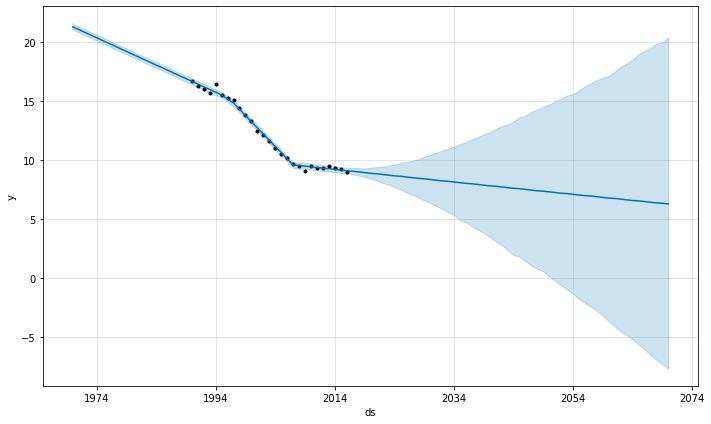

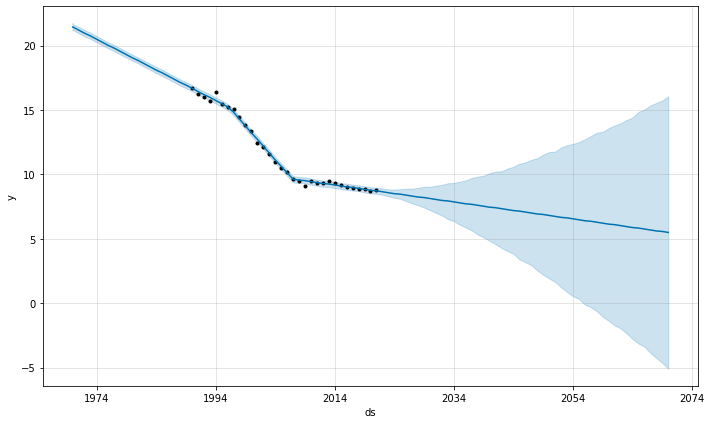

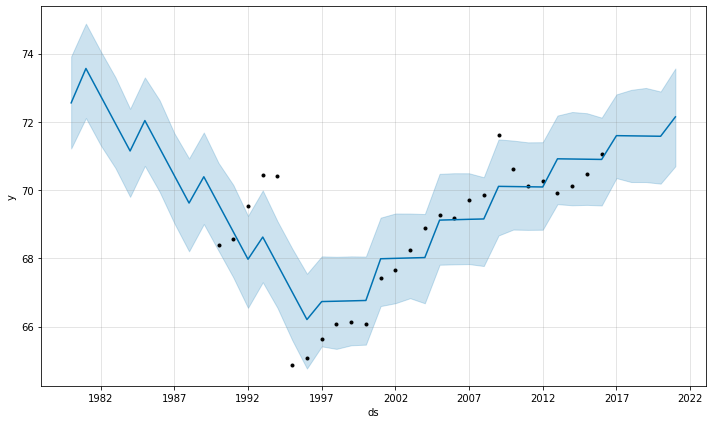

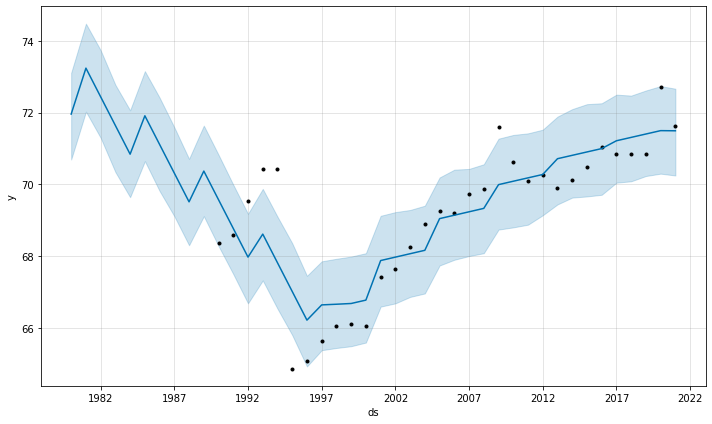

In [25]:
generate_results_m(gbr_data_m, "GBR")
generate_results_s(gbr_data_s, "GBR")

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 20.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/1e3znf2k.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/l04kgdju.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=1796', 'data', 'file=/tmp/tmpjad4h45l/1e3znf2k.json', 'init=/tmp/tmpjad4h45l/l04kgdju.json', 'output', 'file=/tmp/tmpjad4h45l/prophet_modelat28ui7q/prophet_model-20221022001523.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:15:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:15:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cm

--------------------Evaluation---------------------
MSE :  0.029296695049180678
MAE :  0.1515585740340626
MAPE :  1.6221612536168166
--------------------Evaluation---------------------


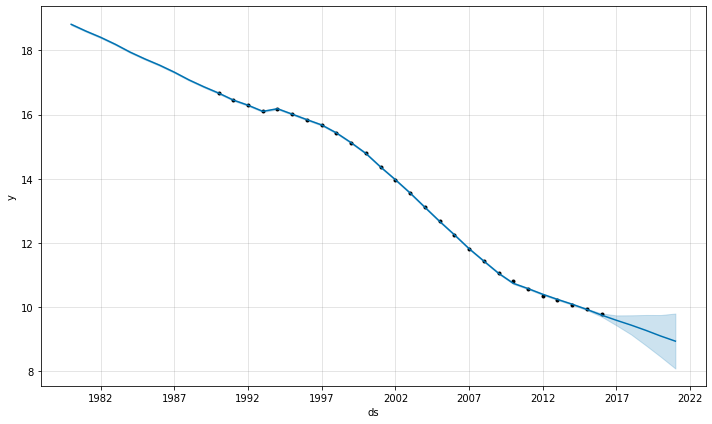

In [ ]:
fit_model_m(gbr_data_m)

In [ ]:
optimizer,_ ,_ = getOpt(gbr_data_m)

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 20.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/bizvmrsm.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/dqoyia33.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=72975', 'data', 'file=/tmp/tmppq7tkcfl/bizvmrsm.json', 'init=/tmp/tmppq7tkcfl/dqoyia33.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model_d2em1xl/prophet_model-20221113234221.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:42:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmds

|   iter    |  target   | yearly... |
-------------------------------------


23:42:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/iu8cqbjq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/hwl_32x6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37861', 'data', 'file=/tmp/tmppq7tkcfl/iu8cqbjq.json', 'init=/tmp/tmppq7tkcfl/hwl_32x6.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model271c305k/prophet_model-20221113234221.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:42:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:42:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/k6u82dsf.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.1498   | -0.3319   |


23:42:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/v7ju19sg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/tbpnsbnn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39256', 'data', 'file=/tmp/tmppq7tkcfl/v7ju19sg.json', 'init=/tmp/tmppq7tkcfl/tbpnsbnn.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelqzwwb_1b/prophet_model-20221113234235.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:42:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:42:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/dtbsi573.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.166    | 0.8813    |


23:42:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/8xrphzct.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/p6_syb40.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60578', 'data', 'file=/tmp/tmppq7tkcfl/8xrphzct.json', 'init=/tmp/tmppq7tkcfl/p6_syb40.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelvox66er3/prophet_model-20221113234248.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:42:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:42:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/oyu6dvo7.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -0.1437   | -2.0      |


23:43:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/uiqphwb9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/k2j88rsf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39187', 'data', 'file=/tmp/tmppq7tkcfl/uiqphwb9.json', 'init=/tmp/tmppq7tkcfl/k2j88rsf.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelosjv5o6f/prophet_model-20221113234301.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:43:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:43:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/hwziuwgj.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.1486   | -0.7907   |


23:43:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/36k2f1cz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/njhi2r7d.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57228', 'data', 'file=/tmp/tmppq7tkcfl/36k2f1cz.json', 'init=/tmp/tmppq7tkcfl/njhi2r7d.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model1c31nxpu/prophet_model-20221113234315.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:43:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:43:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/nhhh8d6f.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.1448   | -1.413    |


23:43:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/gqtwcd7q.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/d8ogn3b8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=16257', 'data', 'file=/tmp/tmppq7tkcfl/gqtwcd7q.json', 'init=/tmp/tmppq7tkcfl/d8ogn3b8.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelq6mdkunp/prophet_model-20221113234328.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:43:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:43:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/t6f6ds8m.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.1446   | -1.631    |


23:43:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/a6z8ukks.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/vekwfauy.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=10749', 'data', 'file=/tmp/tmppq7tkcfl/a6z8ukks.json', 'init=/tmp/tmppq7tkcfl/vekwfauy.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model5gsvseni/prophet_model-20221113234341.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:43:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:43:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/pc3hluxe.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.1463   | -1.255    |


23:43:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/vzy4qi6e.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/4av7z_ry.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84856', 'data', 'file=/tmp/tmppq7tkcfl/vzy4qi6e.json', 'init=/tmp/tmppq7tkcfl/4av7z_ry.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelh9o0n0ib/prophet_model-20221113234354.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:43:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:43:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/hh912usk.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.1494   | -0.6178   |


23:44:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/56q6truo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/qg5nglq1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=1324', 'data', 'file=/tmp/tmppq7tkcfl/56q6truo.json', 'init=/tmp/tmppq7tkcfl/qg5nglq1.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelu9u2nej6/prophet_model-20221113234408.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:44:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:44:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/sjpkzw1q.json
DEBUG:cmdstanpy:input tempfile: 

| 9         | -0.1504   | -0.4129   |


23:44:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/1vcgl1nb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/8qduj4gx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=14445', 'data', 'file=/tmp/tmppq7tkcfl/1vcgl1nb.json', 'init=/tmp/tmppq7tkcfl/8qduj4gx.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model4gzfs86u/prophet_model-20221113234421.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:44:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:44:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/0jwbctcm.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -0.1564   | 0.1553    |


23:44:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/wqto98s3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/x9oug72f.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=95554', 'data', 'file=/tmp/tmppq7tkcfl/wqto98s3.json', 'init=/tmp/tmppq7tkcfl/x9oug72f.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelda1gucbp/prophet_model-20221113234435.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:44:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:44:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/0mpbk6qn.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -0.1698   | 2.0       |


23:44:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/pn9am3rr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/bubjihmo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=51576', 'data', 'file=/tmp/tmppq7tkcfl/pn9am3rr.json', 'init=/tmp/tmppq7tkcfl/bubjihmo.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelx1l8i5l1/prophet_model-20221113234449.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:44:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:44:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/xidij041.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.1439   | -1.864    |


23:45:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/wsfdewzs.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/t5bw6olt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=71335', 'data', 'file=/tmp/tmppq7tkcfl/wsfdewzs.json', 'init=/tmp/tmppq7tkcfl/t5bw6olt.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model9d8x7t6c/prophet_model-20221113234502.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:45:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:45:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/75xx132t.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -0.1445   | -1.946    |


INFO:prophet:n_changepoints greater than number of observations. Using 20.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/mrf3mjxl.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ocrvc5ev.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=76407', 'data', 'file=/tmp/tmppq7tkcfl/mrf3mjxl.json', 'init=/tmp/tmppq7tkcfl/ocrvc5ev.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelcrprbukf/prophet_model-20221113234516.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:45:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:45:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ylq6sd2e.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/7lom8r6o.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=68616', 'data', 'file=/tmp/tmppq7tkcfl/ylq6sd2e.json', 'init=/tmp/tmppq7tkcfl/7lom8r6o.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelp8ccn8_0/prophet_model-20221113234516.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:45:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:45:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/lg30dpao.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -0.1434   | -1.994    |


INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 20.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/6y0ys1n_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/2bvml_k5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=29850', 'data', 'file=/tmp/tmppq7tkcfl/6y0ys1n_.json', 'init=/tmp/tmppq7tkcfl/2bvml_k5.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelolaj54sd/prophet_model-20221113234529.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:45:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmds

  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/v1dgn_zj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/h6gf0vjp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=18019', 'data', 'file=/tmp/tmppq7tkcfl/v1dgn_zj.json', 'init=/tmp/tmppq7tkcfl/h6gf0vjp.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model5xkxocii/prophet_model-20221113234530.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:45:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:45:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/kjt9zyea.json
DEBUG:cmdstanpy:input tempfile:

--------------------Evaluation---------------------
MSE :  0.03169387067991149
MAE :  0.15936047230284806
MAPE :  1.7050459560013653
--------------------Evaluation---------------------


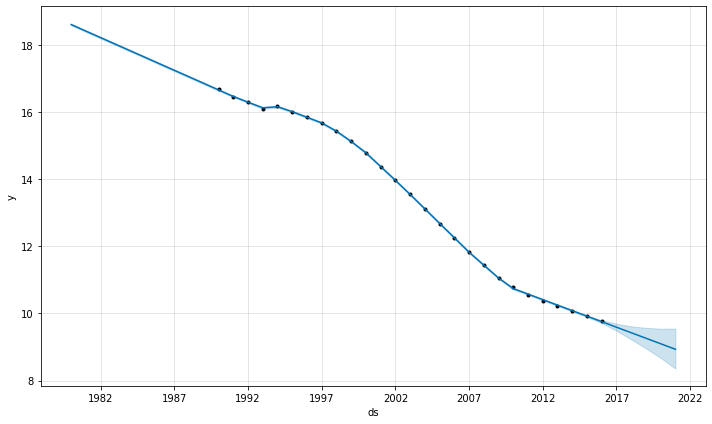

In [ ]:
evaluate_model(optimizer, gbr_data_m)

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 20.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/f2uusqdf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/qmyb2449.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=62125', 'data', 'file=/tmp/tmpjad4h45l/f2uusqdf.json', 'init=/tmp/tmpjad4h45l/qmyb2449.json', 'output', 'file=/tmp/tmpjad4h45l/prophet_modelm9u9aeji/prophet_model-20221022001631.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:16:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:16:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:c

--------------------Evaluation---------------------
MSE :  0.06749737957449702
MAE :  0.22556374409679164
MAPE :  0.3193150846084877
--------------------Evaluation---------------------


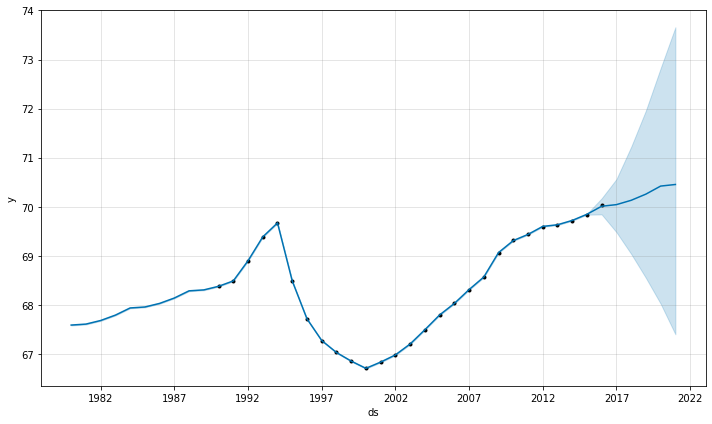

In [ ]:
fit_model_s(gbr_data_s)

In [ ]:
optimizer, _, _ = getOpt_s(gbr_data_s)

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 20.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ph7zk3pv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/rreosttm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70737', 'data', 'file=/tmp/tmppq7tkcfl/ph7zk3pv.json', 'init=/tmp/tmppq7tkcfl/rreosttm.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model6q4q5e_2/prophet_model-20221114002401.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:24:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmds

|   iter    |  target   | yearly... |
-------------------------------------


INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/lv0frfo4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ii9b8h9x.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=98112', 'data', 'file=/tmp/tmppq7tkcfl/lv0frfo4.json', 'init=/tmp/tmppq7tkcfl/ii9b8h9x.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelkkijodpe/prophet_model-20221114002401.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:24:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:24:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/2mj4sihm.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.2204   | -0.3319   |


INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/4hempsoo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/l4c_1yi3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=54342', 'data', 'file=/tmp/tmppq7tkcfl/4hempsoo.json', 'init=/tmp/tmppq7tkcfl/l4c_1yi3.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelqddrw_0m/prophet_model-20221114002414.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:24:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:24:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/raajofju.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.2281   | 0.8813    |


00:24:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/48lu6d4b.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/gic9y04a.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79362', 'data', 'file=/tmp/tmppq7tkcfl/48lu6d4b.json', 'init=/tmp/tmppq7tkcfl/gic9y04a.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelyjkb_6gx/prophet_model-20221114002428.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:24:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:24:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/h6107qxh.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -0.2021   | -2.0      |


00:24:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/nq68i793.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/5p9m3v8w.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70826', 'data', 'file=/tmp/tmppq7tkcfl/nq68i793.json', 'init=/tmp/tmppq7tkcfl/5p9m3v8w.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model_gnyw37y/prophet_model-20221114002442.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:24:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:24:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ql39hmme.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.2152   | -0.7907   |


INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/hu40_9kw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/_6hx5y2c.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=34888', 'data', 'file=/tmp/tmppq7tkcfl/hu40_9kw.json', 'init=/tmp/tmppq7tkcfl/_6hx5y2c.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelp8sxe0so/prophet_model-20221114002455.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:24:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:24:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/l7h67_4x.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.2099   | -1.413    |


00:25:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/kuia5unq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/bo8jicor.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=25903', 'data', 'file=/tmp/tmppq7tkcfl/kuia5unq.json', 'init=/tmp/tmppq7tkcfl/bo8jicor.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model253tnt75/prophet_model-20221114002508.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:25:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:25:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/94hyac65.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.2083   | -1.631    |


00:25:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/kbzhytg3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/p473ojun.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79688', 'data', 'file=/tmp/tmppq7tkcfl/kbzhytg3.json', 'init=/tmp/tmppq7tkcfl/p473ojun.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model5bei2u_i/prophet_model-20221114002522.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:25:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:25:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/_m1weuvx.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.2111   | -1.255    |


INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/rw9mvne2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/4wvyvvw6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=81547', 'data', 'file=/tmp/tmppq7tkcfl/rw9mvne2.json', 'init=/tmp/tmppq7tkcfl/4wvyvvw6.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelzwm_guct/prophet_model-20221114002536.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:25:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:25:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/mj_p73cx.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.2182   | -0.6178   |


00:25:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/exq3af4r.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/wz06b9px.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60024', 'data', 'file=/tmp/tmppq7tkcfl/exq3af4r.json', 'init=/tmp/tmppq7tkcfl/wz06b9px.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model9zvkbx5_/prophet_model-20221114002549.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:25:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:25:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/6j7o4n61.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -0.2201   | -0.4129   |


00:26:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/fk40ucli.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/5gqvrplz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=96840', 'data', 'file=/tmp/tmppq7tkcfl/fk40ucli.json', 'init=/tmp/tmppq7tkcfl/5gqvrplz.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelfw0b_yef/prophet_model-20221114002603.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:26:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:26:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/y_m8wyxc.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -0.2267   | 0.1553    |


INFO:prophet:n_changepoints greater than number of observations. Using 20.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/8jjbj9zd.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/kioqjj_b.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84622', 'data', 'file=/tmp/tmppq7tkcfl/8jjbj9zd.json', 'init=/tmp/tmppq7tkcfl/kioqjj_b.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelbgrrmm5g/prophet_model-20221114002617.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:26:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:26:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/t3yqy0hl.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/54_mvhiq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=38086', 'data', 'file=/tmp/tmppq7tkcfl/t3yqy0hl.json', 'init=/tmp/tmppq7tkcfl/54_mvhiq.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model5erx5kny/prophet_model-20221114002617.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:26:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:26:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/956jz4q3.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -0.2863   | 2.0       |


00:26:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/lunwxbmw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/6en6w33h.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=42925', 'data', 'file=/tmp/tmppq7tkcfl/lunwxbmw.json', 'init=/tmp/tmppq7tkcfl/6en6w33h.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelno8be9ob/prophet_model-20221114002631.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:26:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:26:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/qu55yy2r.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.2021   | -2.0      |


00:26:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/0g33cd6o.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/5bxdsirm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=35930', 'data', 'file=/tmp/tmppq7tkcfl/0g33cd6o.json', 'init=/tmp/tmppq7tkcfl/5bxdsirm.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model26wxsc6q/prophet_model-20221114002644.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:26:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:26:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/nfob_7dk.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -0.2014   | -1.971    |


00:26:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 16 forecasts with cutoffs between 2000-01-05 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/5_0z4pqn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/sup10vny.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=4294', 'data', 'file=/tmp/tmppq7tkcfl/5_0z4pqn.json', 'init=/tmp/tmppq7tkcfl/sup10vny.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelri1lrrr8/prophet_model-20221114002659.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:26:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:26:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/na6eokgx.json
DEBUG:cmdstanpy:input tempfile: 

| 14        | -0.202    | -1.869    |


INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 20.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/2p697m42.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/a89glp03.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=3653', 'data', 'file=/tmp/tmppq7tkcfl/2p697m42.json', 'init=/tmp/tmppq7tkcfl/a89glp03.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model5gczgx5q/prophet_model-20221114002712.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:27:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdst

  0%|          | 0/16 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/b3ui_n0m.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/a_eeqmgl.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=28410', 'data', 'file=/tmp/tmppq7tkcfl/b3ui_n0m.json', 'init=/tmp/tmppq7tkcfl/a_eeqmgl.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model4fr546_j/prophet_model-20221114002712.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:27:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:27:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/8ui8vsz1.json
DEBUG:cmdstanpy:input tempfile:

--------------------Evaluation---------------------
MSE :  0.059744025080450715
MAE :  0.20296213762803744
MAPE :  0.28721864882606774
--------------------Evaluation---------------------


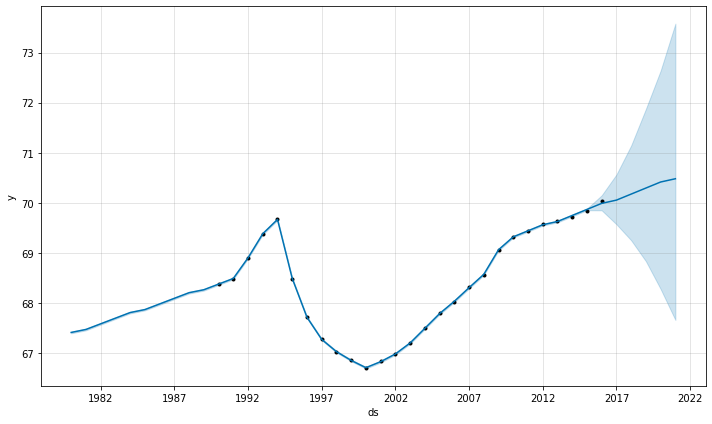

In [ ]:
evaluate_model_s(optimizer, gbr_data_s)

## India

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/wy70gxq1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/f2trdvm0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=74170', 'data', 'file=/tmp/tmpu84toiig/wy70gxq1.json', 'init=/tmp/tmpu84toiig/f2trdvm0.json', 'output', 'file=/tmp/tmpu84toiig/prophet_models_jh1b53/prophet_model-20221130154648.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:46:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing


|   iter    |  target   | yearly... |
-------------------------------------


15:46:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/vj3bttvc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/n4r79c0l.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=15050', 'data', 'file=/tmp/tmpu84toiig/vj3bttvc.json', 'init=/tmp/tmpu84toiig/n4r79c0l.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelgnbhsxf9/prophet_model-20221130154648.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:46:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:46:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/l_ryyk4j.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.9252   | -0.3319   |


INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/7qff4m3_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/xzvxk1j5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=67526', 'data', 'file=/tmp/tmpu84toiig/7qff4m3_.json', 'init=/tmp/tmpu84toiig/xzvxk1j5.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelbimxi0yt/prophet_model-20221130154707.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:47:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:47:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/yvx780c0.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.9388   | 0.8813    |


15:47:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/vfi5qyle.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/m35_gn9p.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=22263', 'data', 'file=/tmp/tmpu84toiig/vfi5qyle.json', 'init=/tmp/tmpu84toiig/m35_gn9p.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelr6wm8gv3/prophet_model-20221130154727.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:47:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:47:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ca96pmmj.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -0.9077   | -2.0      |


INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/4gtz71tt.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/u01q1rb1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=59450', 'data', 'file=/tmp/tmpu84toiig/4gtz71tt.json', 'init=/tmp/tmpu84toiig/u01q1rb1.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model34hrlfhu/prophet_model-20221130154746.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:47:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:47:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/1mkygmhc.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.9217   | -0.7907   |


15:48:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/hc7ohu56.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ccmpc_bn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39119', 'data', 'file=/tmp/tmpu84toiig/hc7ohu56.json', 'init=/tmp/tmpu84toiig/ccmpc_bn.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model6bvbihhi/prophet_model-20221130154806.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:48:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:48:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/d54pwcz8.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.9203   | -1.413    |


15:48:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ksaxs7ep.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/umzoa226.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=92652', 'data', 'file=/tmp/tmpu84toiig/ksaxs7ep.json', 'init=/tmp/tmpu84toiig/umzoa226.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modela_j371ix/prophet_model-20221130154826.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:48:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:48:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/3kxtzd_c.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.9081   | -1.631    |


15:48:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/39h85ut6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/on7lktod.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73872', 'data', 'file=/tmp/tmpu84toiig/39h85ut6.json', 'init=/tmp/tmpu84toiig/on7lktod.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modeljyemtc_t/prophet_model-20221130154845.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:48:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:48:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/oqmgugyx.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.9066   | -1.255    |


15:49:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/p72xilr_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/h_qjqdbn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=68139', 'data', 'file=/tmp/tmpu84toiig/p72xilr_.json', 'init=/tmp/tmpu84toiig/h_qjqdbn.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model891_yffn/prophet_model-20221130154906.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:49:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:49:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/_xx287s9.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.9206   | -0.6178   |


15:49:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/_ab1xjck.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/qitdnuq6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=85854', 'data', 'file=/tmp/tmpu84toiig/_ab1xjck.json', 'init=/tmp/tmpu84toiig/qitdnuq6.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modellniwqchm/prophet_model-20221130154926.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:49:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:49:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/uuk1ii1k.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -0.9244   | -0.4129   |


INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/v8g_2qqf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/fl2_8yyi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=1120', 'data', 'file=/tmp/tmpu84toiig/v8g_2qqf.json', 'init=/tmp/tmpu84toiig/fl2_8yyi.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model7rht5xob/prophet_model-20221130154946.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:49:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:49:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/6m81d1lj.json
DEBUG:cmdstanpy:input tempfile: 

| 10        | -0.9214   | 0.1553    |


15:50:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/r1lby05b.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/jdeigg7p.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=78583', 'data', 'file=/tmp/tmpu84toiig/r1lby05b.json', 'init=/tmp/tmpu84toiig/jdeigg7p.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model74fj7s3m/prophet_model-20221130155007.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:50:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:50:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/e4pjyq9o.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -0.9071   | -1.812    |


15:50:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/mse9u7uo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/me0x8e8l.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=90918', 'data', 'file=/tmp/tmpu84toiig/mse9u7uo.json', 'init=/tmp/tmpu84toiig/me0x8e8l.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelsqiatid_/prophet_model-20221130155027.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:50:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:50:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/u42_l8_7.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.9066   | -1.265    |


15:50:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/kilwhjfy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/2i__9qsw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=26190', 'data', 'file=/tmp/tmpu84toiig/kilwhjfy.json', 'init=/tmp/tmpu84toiig/2i__9qsw.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model7o9sez_3/prophet_model-20221130155047.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:50:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:50:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/nlblynvg.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -0.9708   | 1.999     |


15:51:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/jhosi3ow.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/baa7kqz0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=2665', 'data', 'file=/tmp/tmpu84toiig/jhosi3ow.json', 'init=/tmp/tmpu84toiig/baa7kqz0.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelmq0y0560/prophet_model-20221130155107.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:51:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:51:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/4p11_x42.json
DEBUG:cmdstanpy:input tempfile: 

| 14        | -0.9504   | 1.374     |


15:51:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/gwyneh2b.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/07jnp4zv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=18225', 'data', 'file=/tmp/tmpu84toiig/gwyneh2b.json', 'init=/tmp/tmpu84toiig/07jnp4zv.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelejttx853/prophet_model-20221130155129.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:51:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:51:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/dohe1zxc.json
DEBUG:cmdstanpy:input tempfile:

Index(['ds', 'trend', 'yhat_lower', 'yhat_upper', 'trend_lower', 'trend_upper',
       'additive_terms', 'additive_terms_lower', 'additive_terms_upper',
       'yearly', 'yearly_lower', 'yearly_upper', 'multiplicative_terms',
       'multiplicative_terms_lower', 'multiplicative_terms_upper', 'yhat'],
      dtype='object')
|   iter    |  target   | yearly... |
-------------------------------------


15:51:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/g9ybq5fr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/32oawfnn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=98454', 'data', 'file=/tmp/tmpu84toiig/g9ybq5fr.json', 'init=/tmp/tmpu84toiig/32oawfnn.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelrn8vucd5/prophet_model-20221130155150.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:51:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:51:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/sub6p0iv.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.9782   | -0.3319   |


15:52:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/mgnmj8h6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ezj5lgf6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=82289', 'data', 'file=/tmp/tmpu84toiig/mgnmj8h6.json', 'init=/tmp/tmpu84toiig/ezj5lgf6.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelko4zqcfs/prophet_model-20221130155215.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:52:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:52:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/5pfanfik.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.9677   | 0.8813    |


15:52:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/aby_3lti.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/6752t35e.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=54986', 'data', 'file=/tmp/tmpu84toiig/aby_3lti.json', 'init=/tmp/tmpu84toiig/6752t35e.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modellk5x45pk/prophet_model-20221130155240.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:52:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:52:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/sqna_xh1.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -0.9665   | -2.0      |


15:53:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ujfgjzno.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/xopius2w.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=28471', 'data', 'file=/tmp/tmpu84toiig/ujfgjzno.json', 'init=/tmp/tmpu84toiig/xopius2w.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model34j0ya89/prophet_model-20221130155305.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:53:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:53:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/vdyj97x8.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.9771   | -0.7907   |


15:53:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/44uiawv1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/v4xtts9r.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=48069', 'data', 'file=/tmp/tmpu84toiig/44uiawv1.json', 'init=/tmp/tmpu84toiig/v4xtts9r.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelwqjflk4s/prophet_model-20221130155330.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:53:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:53:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/330eugix.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.9766   | -1.413    |


15:53:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/6iwxkiv7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/nh50j48l.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=48435', 'data', 'file=/tmp/tmpu84toiig/6iwxkiv7.json', 'init=/tmp/tmpu84toiig/nh50j48l.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model9p6eglam/prophet_model-20221130155355.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:53:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:53:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/j69kp810.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.9671   | -1.631    |


15:54:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/q0jnsp45.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/a4vu792e.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=91537', 'data', 'file=/tmp/tmpu84toiig/q0jnsp45.json', 'init=/tmp/tmpu84toiig/a4vu792e.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model0hm35c9r/prophet_model-20221130155419.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:54:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:54:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/yo7gep80.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.9659   | -1.255    |


15:54:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/2ikg4jlj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/6gxfz66x.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=711', 'data', 'file=/tmp/tmpu84toiig/2ikg4jlj.json', 'init=/tmp/tmpu84toiig/6gxfz66x.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model76wrghzu/prophet_model-20221130155445.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:54:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:54:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/9iuqk7sh.json
DEBUG:cmdstanpy:input tempfile: /

| 8         | -0.9754   | -0.6178   |


15:55:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/620b47bo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/1jnhvmgt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=23142', 'data', 'file=/tmp/tmpu84toiig/620b47bo.json', 'init=/tmp/tmpu84toiig/1jnhvmgt.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model7r3p4rl7/prophet_model-20221130155510.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:55:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:55:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/b6xpg2tb.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -0.9783   | -0.4129   |


15:55:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/1iwdujcf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/rcyvweyt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7977', 'data', 'file=/tmp/tmpu84toiig/1iwdujcf.json', 'init=/tmp/tmpu84toiig/rcyvweyt.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelltezbfh2/prophet_model-20221130155535.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:55:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:55:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/1juvz0v1.json
DEBUG:cmdstanpy:input tempfile: 

| 10        | -0.9754   | 0.1553    |


INFO:cmdstanpy:Chain [1] start processing
15:56:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/h3gprvel.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/71y3nsjz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39069', 'data', 'file=/tmp/tmpu84toiig/h3gprvel.json', 'init=/tmp/tmpu84toiig/71y3nsjz.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model1b5xh9mk/prophet_model-20221130155600.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:56:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:56:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/7mrqubks.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -0.977    | -1.162    |


15:56:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/xa6klltb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/0vwt9vx7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=66461', 'data', 'file=/tmp/tmpu84toiig/xa6klltb.json', 'init=/tmp/tmpu84toiig/0vwt9vx7.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model1m2kidgi/prophet_model-20221130155626.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:56:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:56:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/xh20_f_z.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.9661   | -1.264    |


15:56:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/effo17qt.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/19vs4hyv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63015', 'data', 'file=/tmp/tmpu84toiig/effo17qt.json', 'init=/tmp/tmpu84toiig/19vs4hyv.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modeljbmh54q5/prophet_model-20221130155651.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:56:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:56:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/vjqhr7o3.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -0.9669   | -1.925    |


DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60757', 'data', 'file=/tmp/tmpu84toiig/wza2cj31.json', 'init=/tmp/tmpu84toiig/e73krhur.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelicudxfiu/prophet_model-20221130155718.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:57:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:57:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/xsc4mp9m.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/d6x7ycyn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89180', 'data', 'file=/tmp/tmpu84toiig/xsc4mp9m.json', 'init=/tmp/tmpu84toiig/d6x7ycyn.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modeluzpzr9zo/prophet_model-20221130155718.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:57:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:57:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/v7riiy54.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -0.9659   | -1.731    |


15:57:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/l0d1rv4d.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/aetkru90.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=74247', 'data', 'file=/tmp/tmpu84toiig/l0d1rv4d.json', 'init=/tmp/tmpu84toiig/aetkru90.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modeltv7_uagt/prophet_model-20221130155744.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:57:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:57:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/bzah5k95.json
DEBUG:cmdstanpy:input tempfile:

Index(['ds', 'trend', 'yhat_lower', 'yhat_upper', 'trend_lower', 'trend_upper',
       'additive_terms', 'additive_terms_lower', 'additive_terms_upper',
       'yearly', 'yearly_lower', 'yearly_upper', 'multiplicative_terms',
       'multiplicative_terms_lower', 'multiplicative_terms_upper', 'yhat'],
      dtype='object')


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:70: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:78: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/rn6ycorx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/j4ppecg7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=10958', 'data', 'file=/tmp/tmpu84toiig/rn6ycorx.json', 'init=/tmp/tmpu84toiig/j4ppecg7.json', 'o

|   iter    |  target   | yearly... |
-------------------------------------


15:58:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/epehrzrg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/et9zp8kv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=62747', 'data', 'file=/tmp/tmpu84toiig/epehrzrg.json', 'init=/tmp/tmpu84toiig/et9zp8kv.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelah9fbr7v/prophet_model-20221130155811.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:58:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:58:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/3ed3p6mk.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -1.244    | -0.3319   |


15:58:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/vncs6lek.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/zhbvsgkb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=1557', 'data', 'file=/tmp/tmpu84toiig/vncs6lek.json', 'init=/tmp/tmpu84toiig/zhbvsgkb.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelqxstur3y/prophet_model-20221130155833.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:58:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:58:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/66zncpm8.json
DEBUG:cmdstanpy:input tempfile: 

| 2         | -1.262    | 0.8813    |


15:58:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/bwamo1kw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ddc1viac.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=87365', 'data', 'file=/tmp/tmpu84toiig/bwamo1kw.json', 'init=/tmp/tmpu84toiig/ddc1viac.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelk6fmooy5/prophet_model-20221130155855.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:58:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:58:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/fh27hiky.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -1.216    | -2.0      |


15:59:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/f8tuf2y9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/7oywvjt_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=326', 'data', 'file=/tmp/tmpu84toiig/f8tuf2y9.json', 'init=/tmp/tmpu84toiig/7oywvjt_.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelkl3ugegm/prophet_model-20221130155917.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:59:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:59:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/muzx05ku.json
DEBUG:cmdstanpy:input tempfile: /

| 4         | -1.211    | -0.7907   |


15:59:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/w6z7wzk1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/s5bpx6e9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=59134', 'data', 'file=/tmp/tmpu84toiig/w6z7wzk1.json', 'init=/tmp/tmpu84toiig/s5bpx6e9.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelc682vhj9/prophet_model-20221130155939.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:59:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:59:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/vq5ze4g9.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -1.206    | -1.413    |


16:00:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/3m4huytp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/9byknk26.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=81215', 'data', 'file=/tmp/tmpu84toiig/3m4huytp.json', 'init=/tmp/tmpu84toiig/9byknk26.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelvztl3b9x/prophet_model-20221130160001.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:00:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:00:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/554p2_jx.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -1.215    | -1.631    |


16:00:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/u0li9h1n.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/zqj8owxx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=17916', 'data', 'file=/tmp/tmpu84toiig/u0li9h1n.json', 'init=/tmp/tmpu84toiig/zqj8owxx.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelhlg0ktc0/prophet_model-20221130160023.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:00:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:00:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/bc1vez3p.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -1.222    | -1.255    |


16:00:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/9j414z5c.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/wrx9wioy.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37442', 'data', 'file=/tmp/tmpu84toiig/9j414z5c.json', 'init=/tmp/tmpu84toiig/wrx9wioy.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modeluccih629/prophet_model-20221130160046.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:00:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:00:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/uw4k_m06.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -1.236    | -0.6178   |


16:01:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/3trh10pe.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ykrozmuj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=76341', 'data', 'file=/tmp/tmpu84toiig/3trh10pe.json', 'init=/tmp/tmpu84toiig/ykrozmuj.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modellkcou996/prophet_model-20221130160108.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:01:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:01:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/gqlyh1vk.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -1.305    | -0.4129   |


16:01:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/hg0nprxu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/h6w3w_5i.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=9411', 'data', 'file=/tmp/tmpu84toiig/hg0nprxu.json', 'init=/tmp/tmpu84toiig/h6w3w_5i.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelmyyoj34l/prophet_model-20221130160131.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:01:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:01:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/inbaruar.json
DEBUG:cmdstanpy:input tempfile: 

| 10        | -1.245    | 0.1553    |


16:01:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/x08b6aqa.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/_qsilkne.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=54182', 'data', 'file=/tmp/tmpu84toiig/x08b6aqa.json', 'init=/tmp/tmpu84toiig/_qsilkne.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model4ih8xnci/prophet_model-20221130160153.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:01:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:01:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/v_eaqbll.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -1.236    | -1.399    |


16:02:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ig7rdqut.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/d0xonpl_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=76998', 'data', 'file=/tmp/tmpu84toiig/ig7rdqut.json', 'init=/tmp/tmpu84toiig/d0xonpl_.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelpp4bazvr/prophet_model-20221130160216.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:02:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:02:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/k4umack4.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -1.212    | -1.419    |


16:02:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/x994uktx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/po2oh99i.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12556', 'data', 'file=/tmp/tmpu84toiig/x994uktx.json', 'init=/tmp/tmpu84toiig/po2oh99i.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelfrdp7bi2/prophet_model-20221130160240.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:02:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:02:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/trdam2e_.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -1.213    | -0.7708   |


16:03:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/r71_r77s.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/g6tax5kc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=10219', 'data', 'file=/tmp/tmpu84toiig/r71_r77s.json', 'init=/tmp/tmpu84toiig/g6tax5kc.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model0tr6t163/prophet_model-20221130160303.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:03:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:03:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/aj01nq8e.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -1.212    | -0.8145   |


16:03:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/74gtegtm.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/bhpogqzs.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=38581', 'data', 'file=/tmp/tmpu84toiig/74gtegtm.json', 'init=/tmp/tmpu84toiig/bhpogqzs.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modeln_3v9i5e/prophet_model-20221130160326.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:03:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:03:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/q72r5z8a.json
DEBUG:cmdstanpy:input tempfile:

|   iter    |  target   | yearly... |
-------------------------------------


16:03:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/_jfhs3pz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/_vbmgykq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70092', 'data', 'file=/tmp/tmpu84toiig/_jfhs3pz.json', 'init=/tmp/tmpu84toiig/_vbmgykq.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelgls_tvwq/prophet_model-20221130160350.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:03:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:03:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ne5xe55_.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -1.234    | -0.3319   |


16:04:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/1pilgkl9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/z7n_t_ea.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=90303', 'data', 'file=/tmp/tmpu84toiig/1pilgkl9.json', 'init=/tmp/tmpu84toiig/z7n_t_ea.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modeloohzkhm_/prophet_model-20221130160417.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:04:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:04:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/gevb1lg8.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -1.238    | 0.8813    |


16:04:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/yjklz3y5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/q9ooi0yx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84656', 'data', 'file=/tmp/tmpu84toiig/yjklz3y5.json', 'init=/tmp/tmpu84toiig/q9ooi0yx.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelhc8rh_46/prophet_model-20221130160445.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:04:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:04:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/suh6c9v9.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -1.204    | -2.0      |


16:05:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/kt7f2yoh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/sr6a5ygr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=46118', 'data', 'file=/tmp/tmpu84toiig/kt7f2yoh.json', 'init=/tmp/tmpu84toiig/sr6a5ygr.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelaw3_uzl2/prophet_model-20221130160513.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:05:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:05:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/26_sd_to.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -1.204    | -0.7907   |


16:05:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/7sxgs6va.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/u75r1gtw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57812', 'data', 'file=/tmp/tmpu84toiig/7sxgs6va.json', 'init=/tmp/tmpu84toiig/u75r1gtw.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model6qnl3o5b/prophet_model-20221130160541.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:05:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:05:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/w8fsjk6a.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -1.2      | -1.413    |


16:06:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/vhxafj0m.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/p3j3ypkn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=8516', 'data', 'file=/tmp/tmpu84toiig/vhxafj0m.json', 'init=/tmp/tmpu84toiig/p3j3ypkn.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelmqee0v_5/prophet_model-20221130160609.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:06:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:06:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/6j5p5qd1.json
DEBUG:cmdstanpy:input tempfile: 

| 6         | -1.208    | -1.631    |


16:06:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/5gxbt6bt.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/j3rcjbpy.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=67729', 'data', 'file=/tmp/tmpu84toiig/5gxbt6bt.json', 'init=/tmp/tmpu84toiig/j3rcjbpy.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model8xe7oydb/prophet_model-20221130160637.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:06:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:06:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/mglzny_x.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -1.215    | -1.255    |


16:07:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/q4ludvxq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/jup_ftz9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=32789', 'data', 'file=/tmp/tmpu84toiig/q4ludvxq.json', 'init=/tmp/tmpu84toiig/jup_ftz9.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelworkfbvn/prophet_model-20221130160704.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:07:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:07:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/6feraqiv.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -1.227    | -0.6178   |


16:07:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/xai29ihf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/l5ksr8v9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63734', 'data', 'file=/tmp/tmpu84toiig/xai29ihf.json', 'init=/tmp/tmpu84toiig/l5ksr8v9.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelrxvsi8o7/prophet_model-20221130160733.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:07:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:07:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/bxo2gvbn.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -1.287    | -0.4129   |


16:08:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/04bmtgsk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/zv8st0pg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=77934', 'data', 'file=/tmp/tmpu84toiig/04bmtgsk.json', 'init=/tmp/tmpu84toiig/zv8st0pg.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modely81pg27_/prophet_model-20221130160802.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:08:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:08:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/onnrndfr.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -1.234    | 0.1553    |


DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=26939', 'data', 'file=/tmp/tmpu84toiig/8zgbtoir.json', 'init=/tmp/tmpu84toiig/uc67t1wx.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelybrmuosl/prophet_model-20221130160830.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:08:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:08:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/id291f7f.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/rtszw86t.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=23582', 'data', 'file=/tmp/tmpu84toiig/id291f7f.json', 'init=/tmp/tmpu84toiig/rtszw86t.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model5yzxddb1/prophet_model-20221130160830.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:08:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:08:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/5cw3chxr.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -1.225    | -1.399    |


16:08:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/5jctzjya.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/sjtcwdb8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=5190', 'data', 'file=/tmp/tmpu84toiig/5jctzjya.json', 'init=/tmp/tmpu84toiig/sjtcwdb8.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelstpanlp2/prophet_model-20221130160859.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:08:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:08:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/pulebuv9.json
DEBUG:cmdstanpy:input tempfile: 

| 12        | -1.205    | -2.0      |


DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/l4admd_z.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=93833', 'data', 'file=/tmp/tmpu84toiig/o_n8x9kb.json', 'init=/tmp/tmpu84toiig/l4admd_z.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model3lyil_6u/prophet_model-20221130160926.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:09:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:09:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ibeym2yx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/q0b_34kk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73932', 'data', 'file=/tmp/tmpu84toiig/ibeym2yx.json', 'init=/tmp/tmpu84toiig/q0b_34kk.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model2_tg_ikh/prophet_model-20221130160927.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:09:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:09:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/w8lby8xi.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -1.209    | -1.992    |


16:09:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/muty_lb7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/tvc_d15s.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36660', 'data', 'file=/tmp/tmpu84toiig/muty_lb7.json', 'init=/tmp/tmpu84toiig/tvc_d15s.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model6fzgh9n0/prophet_model-20221130160955.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:09:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:09:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/88w3ilqy.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -1.194    | -1.421    |


16:10:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 31 forecasts with cutoffs between 1990-01-09 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/31 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/7mv2h6fr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/aij_6mat.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=59924', 'data', 'file=/tmp/tmpu84toiig/7mv2h6fr.json', 'init=/tmp/tmpu84toiig/aij_6mat.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelgsmnsx73/prophet_model-20221130161024.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:10:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:10:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/t04yedle.json
DEBUG:cmdstanpy:input tempfile:

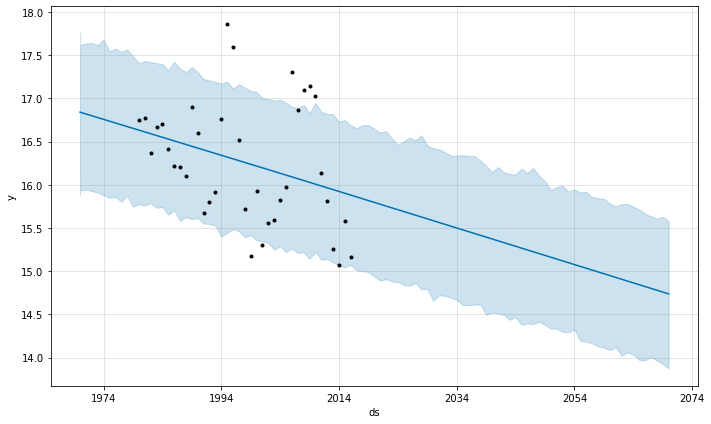

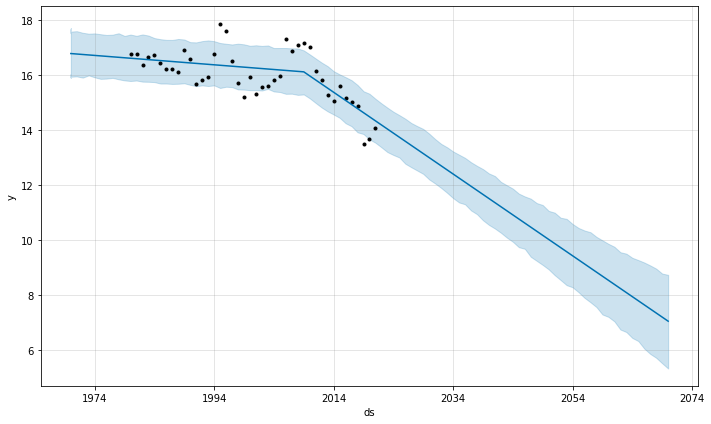

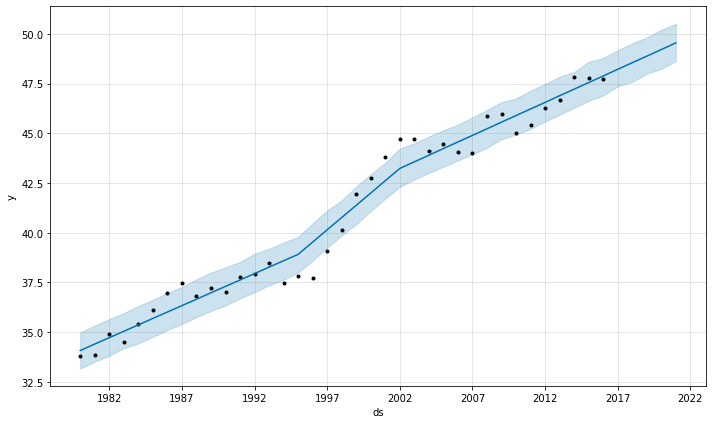

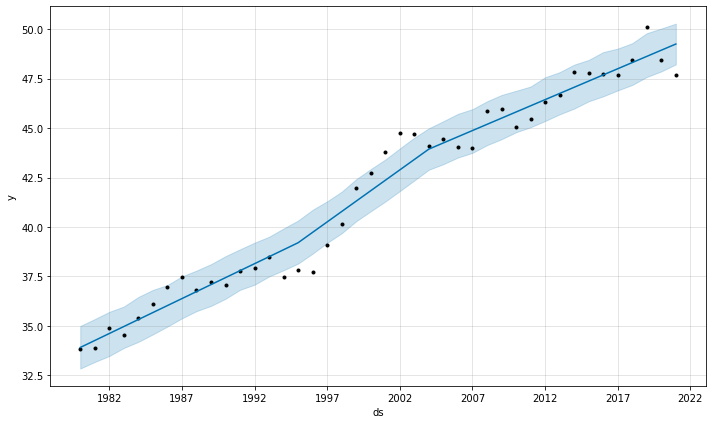

In [26]:
generate_results_m(ind_data_m, "IND")
generate_results_s(ind_data_s, "IND")

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/042gkn4z.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/myyplugi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=19258', 'data', 'file=/tmp/tmpjad4h45l/042gkn4z.json', 'init=/tmp/tmpjad4h45l/myyplugi.json', 'output', 'file=/tmp/tmpjad4h45l/prophet_model_u8qhzfq/prophet_model-20221022001651.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:16:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:16:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


--------------------Evaluation---------------------
MSE :  0.877656097734854
MAE :  0.8802202139757711
MAPE :  5.810670113590662
--------------------Evaluation---------------------


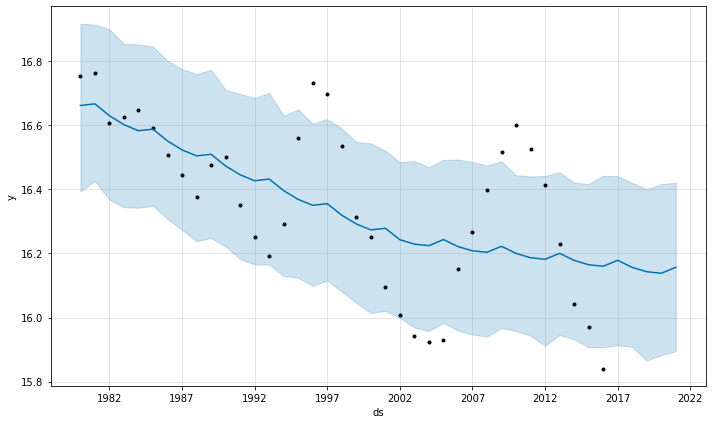

In [ ]:
fit_model_m(ind_data_m)

In [ ]:
optimizer, _, _ = getOpt(ind_data_m)

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/vkds73cp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/duxgkfpg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=11269', 'data', 'file=/tmp/tmppq7tkcfl/vkds73cp.json', 'init=/tmp/tmppq7tkcfl/duxgkfpg.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelmtb3sl3q/prophet_model-20221113234544.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:45:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing


|   iter    |  target   | yearly... |
-------------------------------------


23:45:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ffo11tsf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/kr0yqe13.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=69610', 'data', 'file=/tmp/tmppq7tkcfl/ffo11tsf.json', 'init=/tmp/tmppq7tkcfl/kr0yqe13.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelwozwhs6n/prophet_model-20221113234544.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:45:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:45:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/_9ju4nes.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.3217   | -0.3319   |


23:46:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/w51ikqcp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/8ygd90ye.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=51749', 'data', 'file=/tmp/tmppq7tkcfl/w51ikqcp.json', 'init=/tmp/tmppq7tkcfl/8ygd90ye.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelzvn6vgt0/prophet_model-20221113234607.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:46:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:46:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/latoptnh.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.339    | 0.8813    |


23:46:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/h903hj09.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ckrqq3k2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53826', 'data', 'file=/tmp/tmppq7tkcfl/h903hj09.json', 'init=/tmp/tmppq7tkcfl/ckrqq3k2.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model5zckthcl/prophet_model-20221113234629.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:46:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:46:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/q0s6o85d.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -0.3183   | -2.0      |


23:46:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/7dukqxvz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/72vfb129.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99518', 'data', 'file=/tmp/tmppq7tkcfl/7dukqxvz.json', 'init=/tmp/tmppq7tkcfl/72vfb129.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelzizw0q0v/prophet_model-20221113234652.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:46:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:46:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/0rr8750r.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.3193   | -0.7907   |


23:47:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/qp188rav.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/4t69olkp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=65621', 'data', 'file=/tmp/tmppq7tkcfl/qp188rav.json', 'init=/tmp/tmppq7tkcfl/4t69olkp.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model34wmv_ik/prophet_model-20221113234713.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:47:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:47:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/y5enduqd.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.3174   | -1.413    |


23:47:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/0ypm21gb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/o_9rxn0n.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=59368', 'data', 'file=/tmp/tmppq7tkcfl/0ypm21gb.json', 'init=/tmp/tmppq7tkcfl/o_9rxn0n.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelbe83i97j/prophet_model-20221113234736.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:47:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:47:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/jkxqra_7.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.3175   | -1.631    |


INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/wgn_th4r.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/bvzjnkr5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=14856', 'data', 'file=/tmp/tmppq7tkcfl/wgn_th4r.json', 'init=/tmp/tmppq7tkcfl/bvzjnkr5.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelawf9udk5/prophet_model-20221113234758.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:47:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:47:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/f5p1dd2m.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.319    | -1.255    |


23:48:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/b2dsf26p.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/21vm1aw4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=74710', 'data', 'file=/tmp/tmppq7tkcfl/b2dsf26p.json', 'init=/tmp/tmppq7tkcfl/21vm1aw4.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelkc5rqxc2/prophet_model-20221113234821.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:48:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:48:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/keff916x.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.3208   | -0.6178   |


23:48:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/5b5kojkr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/wa577s6e.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=68960', 'data', 'file=/tmp/tmppq7tkcfl/5b5kojkr.json', 'init=/tmp/tmppq7tkcfl/wa577s6e.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model3vj29cwo/prophet_model-20221113234844.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:48:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:48:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/f1lxld0z.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -0.3166   | -0.4129   |


23:49:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/tnnvxi6u.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/1k7d0i8b.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=96572', 'data', 'file=/tmp/tmppq7tkcfl/tnnvxi6u.json', 'init=/tmp/tmppq7tkcfl/1k7d0i8b.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model9hr6gj2m/prophet_model-20221113234907.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:49:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:49:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/oqm7hg16.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -0.3222   | 0.1553    |


23:49:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/g4q3w_n4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/jrr3x9ii.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=15772', 'data', 'file=/tmp/tmppq7tkcfl/g4q3w_n4.json', 'init=/tmp/tmppq7tkcfl/jrr3x9ii.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelkv6wyiqy/prophet_model-20221113234929.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:49:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:49:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/bz7etayu.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -0.3311   | 2.0       |


23:49:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/fty8i9q6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/y83aie2j.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=68847', 'data', 'file=/tmp/tmppq7tkcfl/fty8i9q6.json', 'init=/tmp/tmppq7tkcfl/y83aie2j.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model9lq_phoo/prophet_model-20221113234953.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:49:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:49:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/f6v1rpzh.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.3203   | -0.4255   |


23:50:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/nuhxe603.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/uetu31yd.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=25436', 'data', 'file=/tmp/tmppq7tkcfl/nuhxe603.json', 'init=/tmp/tmppq7tkcfl/uetu31yd.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelora28rhn/prophet_model-20221113235016.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:50:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:50:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/num_g2u5.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -0.3245   | -0.3814   |


23:50:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/6fjw9tx8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/e_j7qh1c.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=31525', 'data', 'file=/tmp/tmppq7tkcfl/6fjw9tx8.json', 'init=/tmp/tmppq7tkcfl/e_j7qh1c.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model_s6pldaq/prophet_model-20221113235039.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:50:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:50:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/qfw4_k_z.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -0.3181   | -1.437    |


INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/s_1rgmyw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/cp7o3usv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=52274', 'data', 'file=/tmp/tmppq7tkcfl/s_1rgmyw.json', 'init=/tmp/tmppq7tkcfl/cp7o3usv.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelmigpagfp/prophet_model-20221113235103.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:51:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:51:03 - cmdstanpy - INFO - Chain [1] do

  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/1p3piqe5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/6t7kdm2_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=8275', 'data', 'file=/tmp/tmppq7tkcfl/1p3piqe5.json', 'init=/tmp/tmppq7tkcfl/6t7kdm2_.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model96llvzfx/prophet_model-20221113235103.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:51:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:51:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/l1tn10vh.json
DEBUG:cmdstanpy:input tempfile: 

--------------------Evaluation---------------------
MSE :  0.8755309621025079
MAE :  0.8793865019119884
MAPE :  5.805066841045025
--------------------Evaluation---------------------


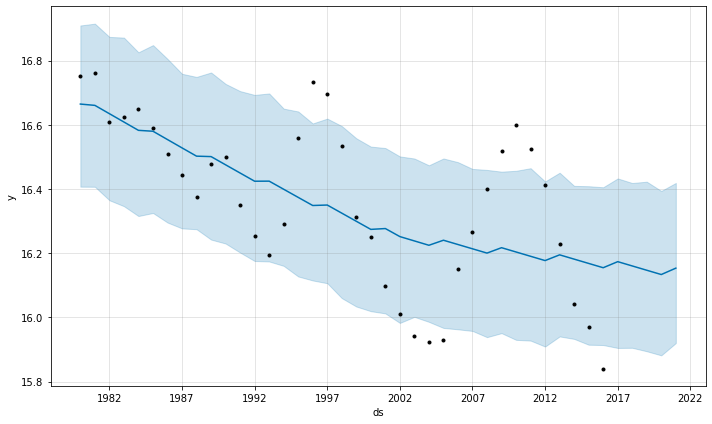

In [ ]:
evaluate_model(optimizer, ind_data_m)

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/zz7msbuq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/9s1o9n3t.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=98957', 'data', 'file=/tmp/tmpjad4h45l/zz7msbuq.json', 'init=/tmp/tmpjad4h45l/9s1o9n3t.json', 'output', 'file=/tmp/tmpjad4h45l/prophet_modelhniyhe7j/prophet_model-20221022001705.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:17:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:17:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


--------------------Evaluation---------------------
MSE :  0.01890724658650656
MAE :  0.105882180287864
MAPE :  0.22402782212192607
--------------------Evaluation---------------------


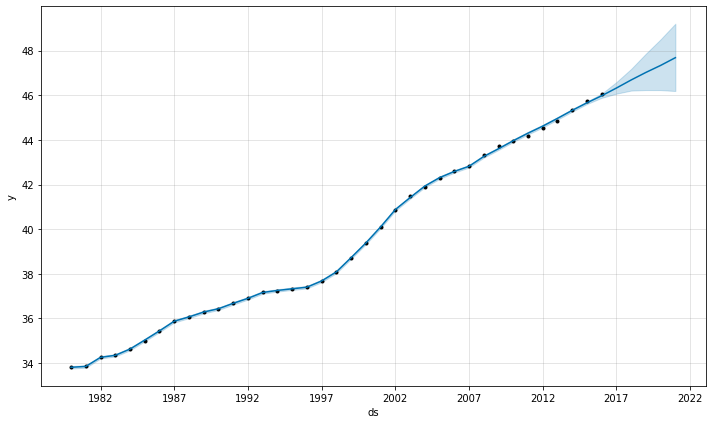

In [ ]:
fit_model_s(ind_data_s)

In [ ]:
optimizer, _, _ = getOpt_s(ind_data_s)

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/xe0eazvf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/s1h9hgzz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=88423', 'data', 'file=/tmp/tmppq7tkcfl/xe0eazvf.json', 'init=/tmp/tmppq7tkcfl/s1h9hgzz.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeljyykdrc2/prophet_model-20221114002726.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:27:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing


|   iter    |  target   | yearly... |
-------------------------------------


00:27:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ulh07nxu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/53871_0e.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=71094', 'data', 'file=/tmp/tmppq7tkcfl/ulh07nxu.json', 'init=/tmp/tmppq7tkcfl/53871_0e.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeladsrnplu/prophet_model-20221114002726.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:27:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:27:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/zc23am7o.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.3308   | -0.3319   |


00:27:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/d9fnv0pg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/wj4vw_w2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=80324', 'data', 'file=/tmp/tmppq7tkcfl/d9fnv0pg.json', 'init=/tmp/tmppq7tkcfl/wj4vw_w2.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelag26k8d4/prophet_model-20221114002749.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:27:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:27:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/eccyh_2b.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.3482   | 0.8813    |


00:28:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/m2tb3kvq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/5d4jwg7q.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=48878', 'data', 'file=/tmp/tmppq7tkcfl/m2tb3kvq.json', 'init=/tmp/tmppq7tkcfl/5d4jwg7q.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model_qxied0o/prophet_model-20221114002811.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:28:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:28:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/02co74k5.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -0.3241   | -2.0      |


00:28:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/6zipjsgs.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/p_7hoho4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53999', 'data', 'file=/tmp/tmppq7tkcfl/6zipjsgs.json', 'init=/tmp/tmppq7tkcfl/p_7hoho4.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelw6e56vrj/prophet_model-20221114002835.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:28:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:28:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/p4efsp3m.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.3248   | -0.7907   |


00:28:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/r3zfnt3a.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/pjwqzb2_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=4828', 'data', 'file=/tmp/tmppq7tkcfl/r3zfnt3a.json', 'init=/tmp/tmppq7tkcfl/pjwqzb2_.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeljae878g7/prophet_model-20221114002857.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:28:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:28:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/hjxp3988.json
DEBUG:cmdstanpy:input tempfile: 

| 5         | -0.3206   | -1.413    |


00:29:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/zxtsuu8e.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/6g2y_opi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=98671', 'data', 'file=/tmp/tmppq7tkcfl/zxtsuu8e.json', 'init=/tmp/tmppq7tkcfl/6g2y_opi.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelrq0m03oz/prophet_model-20221114002920.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:29:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:29:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/05anhjz2.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.3208   | -1.631    |


00:29:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/02m1rf81.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ja6fcaav.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57261', 'data', 'file=/tmp/tmppq7tkcfl/02m1rf81.json', 'init=/tmp/tmppq7tkcfl/ja6fcaav.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelzgk5mqyn/prophet_model-20221114002942.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:29:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:29:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/9jnp9can.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.3215   | -1.255    |


00:30:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/dm4phv37.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/qx9z4zxv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=55774', 'data', 'file=/tmp/tmppq7tkcfl/dm4phv37.json', 'init=/tmp/tmppq7tkcfl/qx9z4zxv.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeln2z3311z/prophet_model-20221114003006.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:30:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:30:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/jz8fxyuk.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.3261   | -0.6178   |


00:30:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/zgdabt20.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/paa2bn17.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=41183', 'data', 'file=/tmp/tmppq7tkcfl/zgdabt20.json', 'init=/tmp/tmppq7tkcfl/paa2bn17.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model5784f0tu/prophet_model-20221114003028.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:30:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:30:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/et1cx686.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -0.3292   | -0.4129   |


00:30:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/027ikbf8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/9dqd3mli.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=69769', 'data', 'file=/tmp/tmppq7tkcfl/027ikbf8.json', 'init=/tmp/tmppq7tkcfl/9dqd3mli.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelv21r_g7u/prophet_model-20221114003052.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:30:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:30:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/qovkc5z3.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -0.3435   | 0.1553    |


00:31:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/u94cq3zb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/bqu7kfj0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=62580', 'data', 'file=/tmp/tmppq7tkcfl/u94cq3zb.json', 'init=/tmp/tmppq7tkcfl/bqu7kfj0.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model04evbp4n/prophet_model-20221114003115.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:31:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:31:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/bwn13rfa.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -0.3448   | 2.0       |


INFO:cmdstanpy:Chain [1] start processing
00:31:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/6lfq7hvv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/bwjaxc92.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=18722', 'data', 'file=/tmp/tmppq7tkcfl/6lfq7hvv.json', 'init=/tmp/tmppq7tkcfl/bwjaxc92.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelbxisur37/prophet_model-20221114003139.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:31:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:31:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/0i982sao.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.3207   | -1.515    |


00:32:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:32:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/y02xmc7f.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/bb6g50qo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=2705', 'data', 'file=/tmp/tmppq7tkcfl/y02xmc7f.json', 'init=/tmp/tmppq7tkcfl/bb6g50qo.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modellvfjruk6/prophet_model-20221114003202.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:32:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:32:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/rqhpymzi.json
DEBUG:cmdstanpy:input tempfile: 

| 13        | -0.322    | -1.733    |


INFO:cmdstanpy:Chain [1] start processing
00:32:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/zjusgjbu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/237gx9ty.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=88314', 'data', 'file=/tmp/tmppq7tkcfl/zjusgjbu.json', 'init=/tmp/tmppq7tkcfl/237gx9ty.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelkqwv1ddn/prophet_model-20221114003226.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:32:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:32:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/2mz6mhs6.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -0.3209   | -1.367    |


INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/e7qpt68w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/kt1v1bec.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=77526', 'data', 'file=/tmp/tmppq7tkcfl/e7qpt68w.json', 'init=/tmp/tmppq7tkcfl/kt1v1bec.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelbstfwnvj/prophet_model-20221114003249.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:32:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:32:49 - cmdstanpy - INFO - Chain [1] do

  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/u2r53oqr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/u5n94waj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=52982', 'data', 'file=/tmp/tmppq7tkcfl/u2r53oqr.json', 'init=/tmp/tmppq7tkcfl/u5n94waj.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model54jbbh7n/prophet_model-20221114003250.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:32:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:32:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/cnn22g2q.json
DEBUG:cmdstanpy:input tempfile:

--------------------Evaluation---------------------
MSE :  0.022522364281365455
MAE :  0.11206140592626639
MAPE :  0.2373160958428866
--------------------Evaluation---------------------


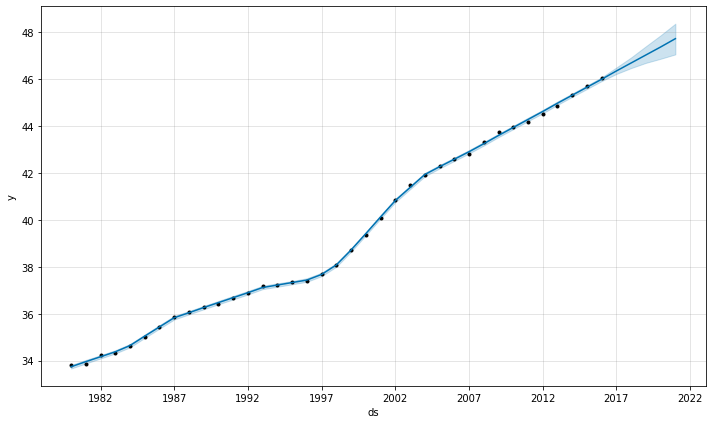

In [ ]:
evaluate_model_s(optimizer, ind_data_s)

## Japan

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 17.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/o_8ahsi3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/p2sbkky9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57776', 'data', 'file=/tmp/tmpb7lz_7lg/o_8ahsi3.json', 'init=/tmp/tmpb7lz_7lg/p2sbkky9.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model7i31zf3t/prophet_model-20221130035708.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:57:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmds

|   iter    |  target   | yearly... |
-------------------------------------


INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/b9mi7wwt.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/grubg8z9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=69217', 'data', 'file=/tmp/tmpb7lz_7lg/b9mi7wwt.json', 'init=/tmp/tmpb7lz_7lg/grubg8z9.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model0a5ljpbp/prophet_model-20221130035708.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:57:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:57:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/sz5_uyo1.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -1.023    | -0.3319   |


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/980fgtaz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/t700azbq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=16668', 'data', 'file=/tmp/tmpb7lz_7lg/980fgtaz.json', 'init=/tmp/tmpb7lz_7lg/t700azbq.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelqsc54nf8/prophet_model-20221130035717.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:57:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:57:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/986rilrc.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -1.049    | 0.8813    |


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/crtt1c5x.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/176gfa3w.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=6347', 'data', 'file=/tmp/tmpb7lz_7lg/crtt1c5x.json', 'init=/tmp/tmpb7lz_7lg/176gfa3w.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelvr8ytapf/prophet_model-20221130035726.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:57:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:57:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/bzks1xui.json
DEBUG:cmdstanpy:input tempfile: 

| 3         | -1.004    | -2.0      |


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/78i8qaro.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/yihqm0p8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=81332', 'data', 'file=/tmp/tmpb7lz_7lg/78i8qaro.json', 'init=/tmp/tmpb7lz_7lg/yihqm0p8.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelup_1magn/prophet_model-20221130035734.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:57:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:57:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/bqmqtvv7.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -1.028    | -0.7907   |


INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/p26zl6oa.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/38bqec81.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=80862', 'data', 'file=/tmp/tmpb7lz_7lg/p26zl6oa.json', 'init=/tmp/tmpb7lz_7lg/38bqec81.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model3yfgnn1a/prophet_model-20221130035744.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:57:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:57:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/9ozlqvtq.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -1.003    | -1.413    |


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/o723c6lm.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/y1s2tzxe.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=72406', 'data', 'file=/tmp/tmpb7lz_7lg/o723c6lm.json', 'init=/tmp/tmpb7lz_7lg/y1s2tzxe.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelnidbhjvv/prophet_model-20221130035752.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:57:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:57:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/4b7gqgk_.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -1.005    | -1.631    |


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/xxpzt5g6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/sq6n8ohk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=78218', 'data', 'file=/tmp/tmpb7lz_7lg/xxpzt5g6.json', 'init=/tmp/tmpb7lz_7lg/sq6n8ohk.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelyzz57iyq/prophet_model-20221130035801.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:58:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:58:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ov0ker89.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -1.007    | -1.255    |


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ec24a7h5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/k7qc061k.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=56033', 'data', 'file=/tmp/tmpb7lz_7lg/ec24a7h5.json', 'init=/tmp/tmpb7lz_7lg/k7qc061k.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model5wharwrp/prophet_model-20221130035810.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:58:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:58:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ord0g61g.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -1.031    | -0.6178   |


INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/g1z091w4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/d4k4i0kq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63658', 'data', 'file=/tmp/tmpb7lz_7lg/g1z091w4.json', 'init=/tmp/tmpb7lz_7lg/d4k4i0kq.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model3fg7yp1y/prophet_model-20221130035819.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:58:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:58:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/2wy6fs0n.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -1.016    | -0.4129   |


03:58:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/40mjbrbr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/uzkm4s6e.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=47711', 'data', 'file=/tmp/tmpb7lz_7lg/40mjbrbr.json', 'init=/tmp/tmpb7lz_7lg/uzkm4s6e.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelkhwu5a7s/prophet_model-20221130035828.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:58:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:58:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/3y3l07h8.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -1.031    | 0.1553    |


03:58:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/abjto2tg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/e8aiaa4p.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=43867', 'data', 'file=/tmp/tmpb7lz_7lg/abjto2tg.json', 'init=/tmp/tmpb7lz_7lg/e8aiaa4p.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model7a9l_q9q/prophet_model-20221130035837.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:58:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:58:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/71ep878m.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -1.002    | -1.826    |


03:58:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/z4kgorm0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/h22gvn_4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=24311', 'data', 'file=/tmp/tmpb7lz_7lg/z4kgorm0.json', 'init=/tmp/tmpb7lz_7lg/h22gvn_4.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelebukb2g6/prophet_model-20221130035846.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:58:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:58:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/8edqmm5e.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -1.002    | -1.826    |


INFO:prophet:n_changepoints greater than number of observations. Using 17.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/fnkvrrub.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/a18zm275.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99708', 'data', 'file=/tmp/tmpb7lz_7lg/fnkvrrub.json', 'init=/tmp/tmpb7lz_7lg/a18zm275.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelmg9w2ak2/prophet_model-20221130035855.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:58:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:58:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/uwvyzrer.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/1fkg9kbw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=61494', 'data', 'file=/tmp/tmpb7lz_7lg/uwvyzrer.json', 'init=/tmp/tmpb7lz_7lg/1fkg9kbw.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelnm7ovhqm/prophet_model-20221130035856.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:58:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:58:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/534ojezs.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -1.286    | 2.0       |


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 17.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/_mlp0uhp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/v7dkpwo2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=54570', 'data', 'file=/tmp/tmpb7lz_7lg/_mlp0uhp.json', 'init=/tmp/tmpb7lz_7lg/v7dkpwo2.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelv1hnapis/prophet_model-20221130035906.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:59:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:59:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:c

  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/1z_6p41d.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/8nmdqkcg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=46937', 'data', 'file=/tmp/tmpb7lz_7lg/1z_6p41d.json', 'init=/tmp/tmpb7lz_7lg/8nmdqkcg.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model8uqcsm8s/prophet_model-20221130035906.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:59:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:59:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/cbgrf6li.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -1.032    | 0.5161    |


03:59:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/sc9jznsp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/myc58k9g.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=49215', 'data', 'file=/tmp/tmpb7lz_7lg/sc9jznsp.json', 'init=/tmp/tmpb7lz_7lg/myc58k9g.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeldjke8klq/prophet_model-20221130035915.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:59:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:59:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/pl8gezjl.json
DEBUG:cmdstanpy:input tempfile:

Index(['ds', 'trend', 'yhat_lower', 'yhat_upper', 'trend_lower', 'trend_upper',
       'additive_terms', 'additive_terms_lower', 'additive_terms_upper',
       'yearly', 'yearly_lower', 'yearly_upper', 'multiplicative_terms',
       'multiplicative_terms_lower', 'multiplicative_terms_upper', 'yhat'],
      dtype='object')
|   iter    |  target   | yearly... |
-------------------------------------


03:59:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/nk1tgs6g.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/uj4nb51e.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=66670', 'data', 'file=/tmp/tmpb7lz_7lg/nk1tgs6g.json', 'init=/tmp/tmpb7lz_7lg/uj4nb51e.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modele8jttof_/prophet_model-20221130035925.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:59:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:59:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/8xuoek1o.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.977    | -0.3319   |


03:59:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/dk2_xjqt.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/j7123yrk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=10588', 'data', 'file=/tmp/tmpb7lz_7lg/dk2_xjqt.json', 'init=/tmp/tmpb7lz_7lg/j7123yrk.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modely_6zsofv/prophet_model-20221130035938.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:59:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:59:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/m3h5aaaa.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.9852   | 0.8813    |


03:59:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/p649pxaj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/hppus7t0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=55420', 'data', 'file=/tmp/tmpb7lz_7lg/p649pxaj.json', 'init=/tmp/tmpb7lz_7lg/hppus7t0.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelap6f6w76/prophet_model-20221130035952.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
03:59:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
03:59:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/emnz256j.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -0.9549   | -2.0      |


04:00:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/vdx_kyvx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/lphu_mdg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=58560', 'data', 'file=/tmp/tmpb7lz_7lg/vdx_kyvx.json', 'init=/tmp/tmpb7lz_7lg/lphu_mdg.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model5osq4d03/prophet_model-20221130040005.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:00:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:00:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/916cn97d.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.9731   | -0.7907   |


04:00:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/vfx7fm20.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/_50ikihc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=9214', 'data', 'file=/tmp/tmpb7lz_7lg/vfx7fm20.json', 'init=/tmp/tmpb7lz_7lg/_50ikihc.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeluth1x5sr/prophet_model-20221130040019.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:00:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:00:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/37p2riqk.json
DEBUG:cmdstanpy:input tempfile: 

| 5         | -0.9531   | -1.413    |


04:00:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/cp8dt_j7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/hiuh85n4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=94747', 'data', 'file=/tmp/tmpb7lz_7lg/cp8dt_j7.json', 'init=/tmp/tmpb7lz_7lg/hiuh85n4.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model2r7t59q1/prophet_model-20221130040032.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:00:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:00:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/e9cg39gm.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.9546   | -1.631    |


04:00:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/b8l8lbai.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/nse54p7_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=59701', 'data', 'file=/tmp/tmpb7lz_7lg/b8l8lbai.json', 'init=/tmp/tmpb7lz_7lg/nse54p7_.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeljxllx6tg/prophet_model-20221130040045.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:00:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:00:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/1zofwoge.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.9567   | -1.255    |


04:00:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/t697jujk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/i_s83xbx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=15187', 'data', 'file=/tmp/tmpb7lz_7lg/t697jujk.json', 'init=/tmp/tmpb7lz_7lg/i_s83xbx.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelxhj5aq0p/prophet_model-20221130040058.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:00:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:00:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/6ae8_gsp.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.9828   | -0.6178   |


04:01:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/m9q08q2q.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/6t_x44n4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70212', 'data', 'file=/tmp/tmpb7lz_7lg/m9q08q2q.json', 'init=/tmp/tmpb7lz_7lg/6t_x44n4.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelyg9xklu4/prophet_model-20221130040112.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:01:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:01:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/n3x3jxy3.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -0.9693   | -0.4129   |


04:01:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/o8g_rluc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/8fsbflfn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=86670', 'data', 'file=/tmp/tmpb7lz_7lg/o8g_rluc.json', 'init=/tmp/tmpb7lz_7lg/8fsbflfn.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model4b7xxjvi/prophet_model-20221130040125.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:01:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:01:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/cjccgx5a.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -0.9931   | 0.1553    |


04:01:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/z1qwvm1o.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/qx1oq90f.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=9103', 'data', 'file=/tmp/tmpb7lz_7lg/z1qwvm1o.json', 'init=/tmp/tmpb7lz_7lg/qx1oq90f.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeln5rcnw4k/prophet_model-20221130040138.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:01:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:01:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/6w7eei4l.json
DEBUG:cmdstanpy:input tempfile: 

| 11        | -0.9524   | -1.823    |


04:01:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/41utn1h3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/6j5op5hz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=31332', 'data', 'file=/tmp/tmpb7lz_7lg/41utn1h3.json', 'init=/tmp/tmpb7lz_7lg/6j5op5hz.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelgk4vgina/prophet_model-20221130040152.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:01:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:01:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/mohwhq9h.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.9539   | -1.833    |


04:02:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/mis9v9h2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/2kqv60ez.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=8471', 'data', 'file=/tmp/tmpb7lz_7lg/mis9v9h2.json', 'init=/tmp/tmpb7lz_7lg/2kqv60ez.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model2noszfb2/prophet_model-20221130040205.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:02:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:02:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/7krffzw7.json
DEBUG:cmdstanpy:input tempfile: 

| 13        | -1.235    | 1.999     |


04:02:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/09srj485.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/btavraqo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=59796', 'data', 'file=/tmp/tmpb7lz_7lg/09srj485.json', 'init=/tmp/tmpb7lz_7lg/btavraqo.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelrm64p8__/prophet_model-20221130040218.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:02:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:02:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/c2h45q0n.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -0.9941   | 0.5338    |


04:02:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/rbg_hp7j.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/camli2g1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=35418', 'data', 'file=/tmp/tmpb7lz_7lg/rbg_hp7j.json', 'init=/tmp/tmpb7lz_7lg/camli2g1.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_models2j84lr5/prophet_model-20221130040233.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:02:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:02:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/5parykot.json
DEBUG:cmdstanpy:input tempfile:

Index(['ds', 'trend', 'yhat_lower', 'yhat_upper', 'trend_lower', 'trend_upper',
       'additive_terms', 'additive_terms_lower', 'additive_terms_upper',
       'yearly', 'yearly_lower', 'yearly_upper', 'multiplicative_terms',
       'multiplicative_terms_lower', 'multiplicative_terms_upper', 'yhat'],
      dtype='object')


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:70: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:78: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 17.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/xm1cgazj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/h5ghbb9j.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=11863', 'data', 'file

|   iter    |  target   | yearly... |
-------------------------------------


04:02:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/miv1s477.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/vyf7_g5f.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=30976', 'data', 'file=/tmp/tmpb7lz_7lg/miv1s477.json', 'init=/tmp/tmpb7lz_7lg/vyf7_g5f.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model31vvb1qh/prophet_model-20221130040248.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:02:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:02:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/px02glwy.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.9702   | -0.3319   |


04:02:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/_vzjccsn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/vkdrl8oo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=16556', 'data', 'file=/tmp/tmpb7lz_7lg/_vzjccsn.json', 'init=/tmp/tmpb7lz_7lg/vkdrl8oo.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model75u23yjv/prophet_model-20221130040258.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:02:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:02:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/b2mzanqy.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -1.031    | 0.8813    |


04:03:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/oevpkfdg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/91pmhnig.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=14352', 'data', 'file=/tmp/tmpb7lz_7lg/oevpkfdg.json', 'init=/tmp/tmpb7lz_7lg/91pmhnig.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model0mhdw43c/prophet_model-20221130040308.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:03:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:03:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/kawem7am.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -0.9439   | -2.0      |


04:03:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/wsucktzj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/zlmm8arn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=61474', 'data', 'file=/tmp/tmpb7lz_7lg/wsucktzj.json', 'init=/tmp/tmpb7lz_7lg/zlmm8arn.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelklczjf3_/prophet_model-20221130040317.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:03:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:03:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/fo98i0m6.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.9391   | -0.7907   |


04:03:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/4lmqpaip.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/1xfqtqw4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=76255', 'data', 'file=/tmp/tmpb7lz_7lg/4lmqpaip.json', 'init=/tmp/tmpb7lz_7lg/1xfqtqw4.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelxsunj4cm/prophet_model-20221130040327.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:03:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:03:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/mjzqfekz.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.9464   | -1.413    |


04:03:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/n_i6dnsd.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/9t7wgnp0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=82923', 'data', 'file=/tmp/tmpb7lz_7lg/n_i6dnsd.json', 'init=/tmp/tmpb7lz_7lg/9t7wgnp0.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model5y0iph3f/prophet_model-20221130040338.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:03:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:03:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/kp8onlmo.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.9455   | -1.631    |


04:03:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/1nlep8u6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/9r9l553f.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=50554', 'data', 'file=/tmp/tmpb7lz_7lg/1nlep8u6.json', 'init=/tmp/tmpb7lz_7lg/9r9l553f.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model41k2zihr/prophet_model-20221130040347.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:03:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:03:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/rnub157m.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.9474   | -1.255    |


04:03:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/31ww2qko.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/tbfutqst.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=19030', 'data', 'file=/tmp/tmpb7lz_7lg/31ww2qko.json', 'init=/tmp/tmpb7lz_7lg/tbfutqst.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeldejs8l4s/prophet_model-20221130040357.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:03:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:03:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/qgzjdoxn.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.9517   | -0.6178   |


04:04:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/7c2x51js.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/1cw7jve0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=55030', 'data', 'file=/tmp/tmpb7lz_7lg/7c2x51js.json', 'init=/tmp/tmpb7lz_7lg/1cw7jve0.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelnvo73dyr/prophet_model-20221130040407.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:04:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:04:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/2o3kdzn2.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -0.9603   | -0.4129   |


04:04:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/cwdkpx3v.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/muu8w0tu.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=49656', 'data', 'file=/tmp/tmpb7lz_7lg/cwdkpx3v.json', 'init=/tmp/tmpb7lz_7lg/muu8w0tu.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeloogzlk2_/prophet_model-20221130040417.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:04:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:04:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ec_yes37.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -0.977    | 0.1553    |


04:04:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:04:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/4ww0gq_r.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/9sclzvuc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=17309', 'data', 'file=/tmp/tmpb7lz_7lg/4ww0gq_r.json', 'init=/tmp/tmpb7lz_7lg/9sclzvuc.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelp1ex_386/prophet_model-20221130040426.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:04:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:04:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/t41dujnp.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -1.089    | 2.0       |


04:04:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/506amrpw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/h1hthz7a.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=5139', 'data', 'file=/tmp/tmpb7lz_7lg/506amrpw.json', 'init=/tmp/tmpb7lz_7lg/h1hthz7a.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelgx9s6v69/prophet_model-20221130040437.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:04:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:04:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ftk3qufr.json
DEBUG:cmdstanpy:input tempfile: 

| 12        | -0.9362   | -0.9843   |


04:04:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/5h25wf5t.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/b3esf0he.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=45298', 'data', 'file=/tmp/tmpb7lz_7lg/5h25wf5t.json', 'init=/tmp/tmpb7lz_7lg/b3esf0he.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelr3ri1enu/prophet_model-20221130040446.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:04:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:04:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ib6iy5_m.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -0.9454   | -1.631    |


INFO:prophet:n_changepoints greater than number of observations. Using 17.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/sveaqku1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/5bm40x5q.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=78471', 'data', 'file=/tmp/tmpb7lz_7lg/sveaqku1.json', 'init=/tmp/tmpb7lz_7lg/5bm40x5q.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelsaq8gwl_/prophet_model-20221130040456.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:04:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:04:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/45eenaws.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/y2w6wv51.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=66284', 'data', 'file=/tmp/tmpb7lz_7lg/45eenaws.json', 'init=/tmp/tmpb7lz_7lg/y2w6wv51.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeloeuzzpeu/prophet_model-20221130040456.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:04:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:04:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/newr46zc.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -0.9332   | -1.841    |


04:05:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/1rv1lrxf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/4dccl21z.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=29281', 'data', 'file=/tmp/tmpb7lz_7lg/1rv1lrxf.json', 'init=/tmp/tmpb7lz_7lg/4dccl21z.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelniy8cf9z/prophet_model-20221130040506.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:05:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:05:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/89kv_qsq.json
DEBUG:cmdstanpy:input tempfile:

|   iter    |  target   | yearly... |
-------------------------------------


04:05:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ral128mv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/5zp8zpdx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79898', 'data', 'file=/tmp/tmpb7lz_7lg/ral128mv.json', 'init=/tmp/tmpb7lz_7lg/5zp8zpdx.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelwrw1w3bq/prophet_model-20221130040517.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:05:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:05:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/k8fz30nj.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -1.026    | -0.3319   |


04:05:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/4scmw2gk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/luxeegv8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=85284', 'data', 'file=/tmp/tmpb7lz_7lg/4scmw2gk.json', 'init=/tmp/tmpb7lz_7lg/luxeegv8.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelc7ymfhq_/prophet_model-20221130040531.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:05:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:05:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/gv9t4t3n.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -1.111    | 0.8813    |


04:05:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/jzl1li2e.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/hnoatfoz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7413', 'data', 'file=/tmp/tmpb7lz_7lg/jzl1li2e.json', 'init=/tmp/tmpb7lz_7lg/hnoatfoz.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelyhxa9l3f/prophet_model-20221130040545.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:05:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:05:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/g_e2jl5e.json
DEBUG:cmdstanpy:input tempfile: 

| 3         | -0.9922   | -2.0      |


04:06:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/8mnqoot3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/p0974zhk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=42341', 'data', 'file=/tmp/tmpb7lz_7lg/8mnqoot3.json', 'init=/tmp/tmpb7lz_7lg/p0974zhk.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model65zyuc00/prophet_model-20221130040600.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:06:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:06:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/q2tf840s.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -1.001    | -0.7907   |


04:06:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/641yquh7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/lhnqv8w0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=75881', 'data', 'file=/tmp/tmpb7lz_7lg/641yquh7.json', 'init=/tmp/tmpb7lz_7lg/lhnqv8w0.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modellqv0k12j/prophet_model-20221130040614.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:06:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:06:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/bzg9i53i.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.9938   | -1.413    |


04:06:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/o_4wdfsw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/u6g4oprd.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=4527', 'data', 'file=/tmp/tmpb7lz_7lg/o_4wdfsw.json', 'init=/tmp/tmpb7lz_7lg/u6g4oprd.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model9aah0enm/prophet_model-20221130040628.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:06:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:06:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/10ixg9fz.json
DEBUG:cmdstanpy:input tempfile: 

| 6         | -1.002    | -1.631    |


04:06:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/mrylsg99.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ude1evsr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73343', 'data', 'file=/tmp/tmpb7lz_7lg/mrylsg99.json', 'init=/tmp/tmpb7lz_7lg/ude1evsr.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelysopoy63/prophet_model-20221130040643.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:06:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:06:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/l404xbu0.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.9955   | -1.255    |


04:06:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/uwp7_i54.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/_wtpncwa.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=50737', 'data', 'file=/tmp/tmpb7lz_7lg/uwp7_i54.json', 'init=/tmp/tmpb7lz_7lg/_wtpncwa.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelfg4h13r2/prophet_model-20221130040658.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:06:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:06:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/tinmnot2.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -1.011    | -0.6178   |


04:07:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/t7sdies4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/keltrdzq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=17857', 'data', 'file=/tmp/tmpb7lz_7lg/t7sdies4.json', 'init=/tmp/tmpb7lz_7lg/keltrdzq.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelssve_wo3/prophet_model-20221130040712.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:07:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:07:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/aphsgwjv.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -1.018    | -0.4129   |


04:07:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/89xcj_9_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/vxezdqge.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=72828', 'data', 'file=/tmp/tmpb7lz_7lg/89xcj_9_.json', 'init=/tmp/tmpb7lz_7lg/vxezdqge.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelc2w65jwu/prophet_model-20221130040727.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:07:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:07:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/04ujq1t7.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -1.045    | 0.1553    |


04:07:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/nosswfbp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/s1qegus2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=44799', 'data', 'file=/tmp/tmpb7lz_7lg/nosswfbp.json', 'init=/tmp/tmpb7lz_7lg/s1qegus2.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelonqjj24s/prophet_model-20221130040741.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:07:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:07:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/a3zetli6.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -1.169    | 2.0       |


04:07:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/embkw5j6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/eukgtqta.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=54819', 'data', 'file=/tmp/tmpb7lz_7lg/embkw5j6.json', 'init=/tmp/tmpb7lz_7lg/eukgtqta.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modelzb6jo1hf/prophet_model-20221130040756.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:07:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:07:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ox0gkr16.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.9991   | -1.014    |


04:08:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/3xdsqkbu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/a81naobq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=49264', 'data', 'file=/tmp/tmpb7lz_7lg/3xdsqkbu.json', 'init=/tmp/tmpb7lz_7lg/a81naobq.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model40h7h1dd/prophet_model-20221130040810.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:08:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:08:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/5d4nc44y.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -1.001    | -1.977    |


DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/71v9im75.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73618', 'data', 'file=/tmp/tmpb7lz_7lg/tlc21yeq.json', 'init=/tmp/tmpb7lz_7lg/71v9im75.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modele77z8myw/prophet_model-20221130040824.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:08:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:08:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/jsprrb92.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/wg8l9nep.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=97632', 'data', 'file=/tmp/tmpb7lz_7lg/jsprrb92.json', 'init=/tmp/tmpb7lz_7lg/wg8l9nep.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeloqxsuazb/prophet_model-20221130040824.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:08:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:08:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/p3vl4i5p.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -1.119    | 1.386     |


04:08:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 17 forecasts with cutoffs between 2004-01-06 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/8ou9ujpp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/3q1ha56a.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89393', 'data', 'file=/tmp/tmpb7lz_7lg/8ou9ujpp.json', 'init=/tmp/tmpb7lz_7lg/3q1ha56a.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_model29_eahei/prophet_model-20221130040839.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:08:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
04:08:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/ijt36te2.json
DEBUG:cmdstanpy:input tempfile:

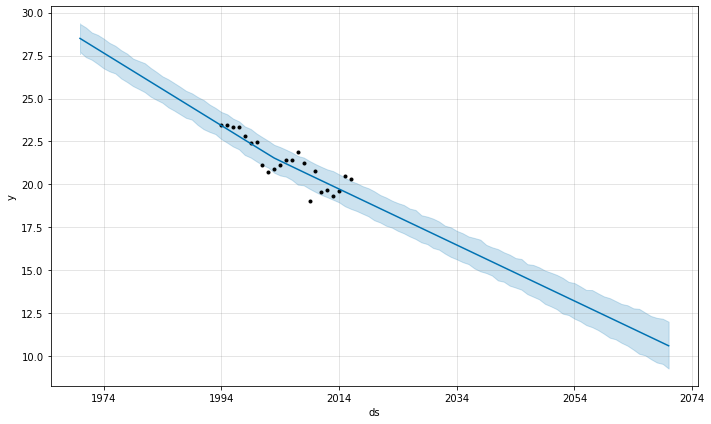

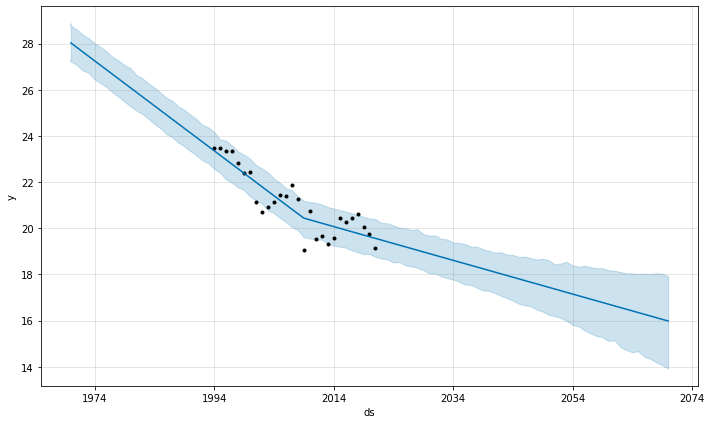

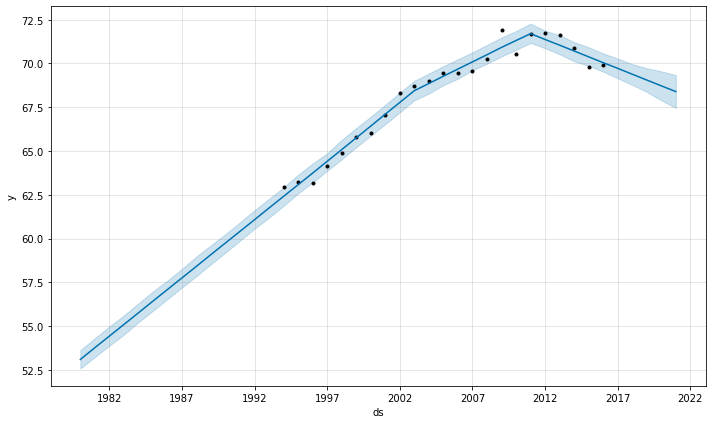

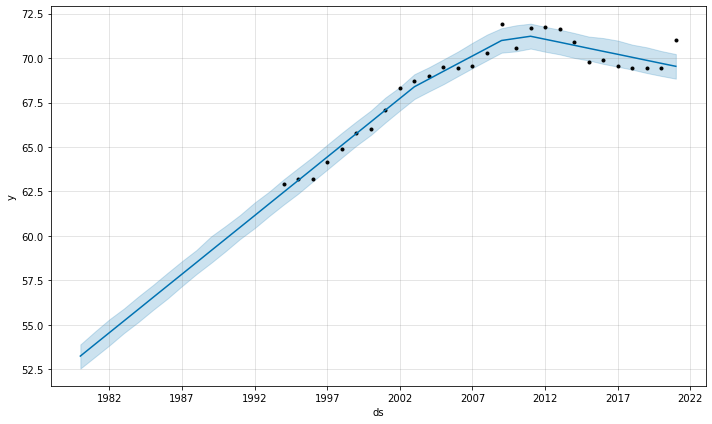

In [89]:
generate_results_m(jpn_data_m, "JPN")
generate_results_s(jpn_data_s, "JPN")

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 17.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/2q4f6rfc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/7rywfpbz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63838', 'data', 'file=/tmp/tmpjad4h45l/2q4f6rfc.json', 'init=/tmp/tmpjad4h45l/7rywfpbz.json', 'output', 'file=/tmp/tmpjad4h45l/prophet_model6d89wvfu/prophet_model-20221022001723.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:17:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:17:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:c

--------------------Evaluation---------------------
MSE :  0.1850039026128449
MAE :  0.4288823208017707
MAPE :  2.1102389983598346
--------------------Evaluation---------------------


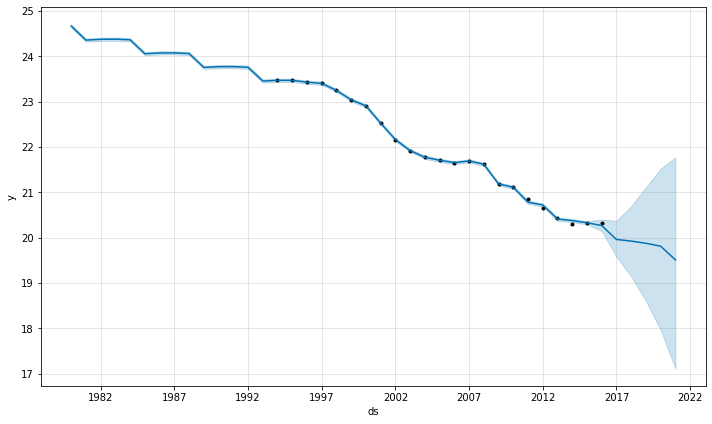

In [ ]:
fit_model_m(jpn_data_m)

In [ ]:
optimizer, _, _ = getOpt(jpn_data_m)

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 17.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/qdd9p3td.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/7hazv0wd.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12302', 'data', 'file=/tmp/tmppq7tkcfl/qdd9p3td.json', 'init=/tmp/tmppq7tkcfl/7hazv0wd.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model1lrjb1v2/prophet_model-20221113235125.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:51:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmds

|   iter    |  target   | yearly... |
-------------------------------------


INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ccdodjy2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/rjjbkzpk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=86365', 'data', 'file=/tmp/tmppq7tkcfl/ccdodjy2.json', 'init=/tmp/tmppq7tkcfl/rjjbkzpk.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelqm9dsqae/prophet_model-20221113235126.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:51:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:51:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/3htw49u_.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.2172   | -0.3319   |


INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/gh_93g5w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/wmwp8qas.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73214', 'data', 'file=/tmp/tmppq7tkcfl/gh_93g5w.json', 'init=/tmp/tmppq7tkcfl/wmwp8qas.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_models6clgwsr/prophet_model-20221113235135.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:51:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:51:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/zmqaup48.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.2421   | 0.8813    |


INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/u5uzrakh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/cu_du6o_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=26175', 'data', 'file=/tmp/tmppq7tkcfl/u5uzrakh.json', 'init=/tmp/tmppq7tkcfl/cu_du6o_.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelw3410ffb/prophet_model-20221113235146.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:51:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:51:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/dwyx2hj3.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -0.2052   | -2.0      |


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/j9v4vu65.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/chd6m6b1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=49196', 'data', 'file=/tmp/tmppq7tkcfl/j9v4vu65.json', 'init=/tmp/tmppq7tkcfl/chd6m6b1.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model1l5e04ia/prophet_model-20221113235155.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:51:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:51:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/nu5ev67q.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.2102   | -0.7907   |


23:52:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/0snd5n_7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/91hemwbp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=98102', 'data', 'file=/tmp/tmppq7tkcfl/0snd5n_7.json', 'init=/tmp/tmppq7tkcfl/91hemwbp.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model1_shmomj/prophet_model-20221113235205.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:52:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:52:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/2uz4uj4y.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.2049   | -1.413    |


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/qjt02bes.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/1zo5qals.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=31279', 'data', 'file=/tmp/tmppq7tkcfl/qjt02bes.json', 'init=/tmp/tmppq7tkcfl/1zo5qals.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelu_n_yfor/prophet_model-20221113235214.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:52:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:52:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/oh25dftu.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.2048   | -1.631    |


INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/nsw_29nd.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ummi6754.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=40774', 'data', 'file=/tmp/tmppq7tkcfl/nsw_29nd.json', 'init=/tmp/tmppq7tkcfl/ummi6754.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelraics40o/prophet_model-20221113235225.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:52:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:52:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/7fu5rw8g.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.2058   | -1.255    |


INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/3c6uirt_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/47zj39hw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=5132', 'data', 'file=/tmp/tmppq7tkcfl/3c6uirt_.json', 'init=/tmp/tmppq7tkcfl/47zj39hw.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model1kzqx1xq/prophet_model-20221113235235.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:52:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:52:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/vfer_cc8.json
DEBUG:cmdstanpy:input tempfile: 

| 8         | -0.2121   | -0.6178   |


INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/vlk3o78i.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/oyn7l48s.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=64993', 'data', 'file=/tmp/tmppq7tkcfl/vlk3o78i.json', 'init=/tmp/tmppq7tkcfl/oyn7l48s.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model3ovm5der/prophet_model-20221113235244.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:52:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:52:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/aiqmrc2b.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -0.2172   | -0.4129   |


INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/9yma354r.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/nznoiltb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=38551', 'data', 'file=/tmp/tmppq7tkcfl/9yma354r.json', 'init=/tmp/tmppq7tkcfl/nznoiltb.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelzqasivt7/prophet_model-20221113235254.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:52:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:52:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/2j62gav9.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -0.2198   | 0.1553    |


23:53:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/nrr_tixi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/9guqgs5x.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=74662', 'data', 'file=/tmp/tmppq7tkcfl/nrr_tixi.json', 'init=/tmp/tmppq7tkcfl/9guqgs5x.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelpwzf0ire/prophet_model-20221113235305.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:53:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:53:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/65azqu39.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -0.2844   | 2.0       |


23:53:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/j6nr2803.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/1a7dmxko.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=43946', 'data', 'file=/tmp/tmppq7tkcfl/j6nr2803.json', 'init=/tmp/tmppq7tkcfl/1a7dmxko.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelidg58889/prophet_model-20221113235315.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:53:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:53:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/wiv49v0g.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.205    | -1.838    |


23:53:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/gzf3aeeq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/c0omcwdd.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=69399', 'data', 'file=/tmp/tmppq7tkcfl/gzf3aeeq.json', 'init=/tmp/tmppq7tkcfl/c0omcwdd.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelygs1p28t/prophet_model-20221113235325.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:53:25 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:53:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/2sspajco.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -0.2047   | -1.523    |


23:53:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/nvji4i6g.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/2jt0_pt9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=88040', 'data', 'file=/tmp/tmppq7tkcfl/nvji4i6g.json', 'init=/tmp/tmppq7tkcfl/2jt0_pt9.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelzdor79f9/prophet_model-20221113235335.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:53:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:53:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/bgp65tp0.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -0.2049   | -1.736    |


INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 17.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/sqp6cdpo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/5qebkxu7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57881', 'data', 'file=/tmp/tmppq7tkcfl/sqp6cdpo.json', 'init=/tmp/tmppq7tkcfl/5qebkxu7.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelcxpot4vl/prophet_model-20221113235345.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:53:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmds

  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/s8vsruvq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/0gxcmaxc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60935', 'data', 'file=/tmp/tmppq7tkcfl/s8vsruvq.json', 'init=/tmp/tmppq7tkcfl/0gxcmaxc.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeliek52nyy/prophet_model-20221113235345.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:53:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:53:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/fsc1_97l.json
DEBUG:cmdstanpy:input tempfile:

--------------------Evaluation---------------------
MSE :  0.20371339366937105
MAE :  0.44163964646780496
MAPE :  2.1736380902732364
--------------------Evaluation---------------------


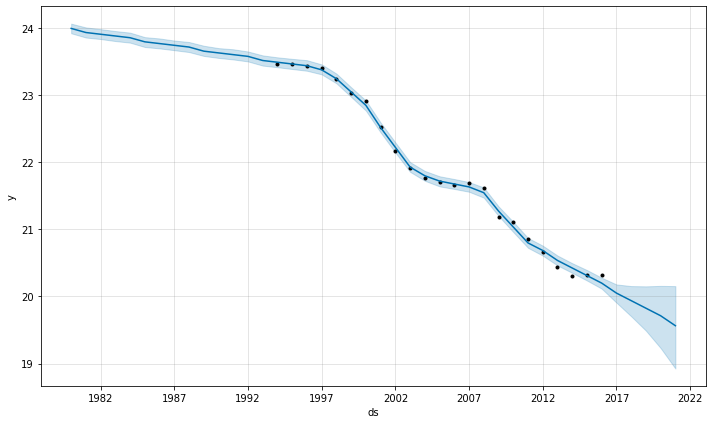

In [ ]:
evaluate_model(optimizer, jpn_data_m)

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 17.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/_oaf21p6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/_dyuqisf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=17789', 'data', 'file=/tmp/tmpjad4h45l/_oaf21p6.json', 'init=/tmp/tmpjad4h45l/_dyuqisf.json', 'output', 'file=/tmp/tmpjad4h45l/prophet_modelc3jeolq5/prophet_model-20221022001740.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:17:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:17:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:c

--------------------Evaluation---------------------
MSE :  0.6121047541290021
MAE :  0.7745571543498357
MAPE :  1.1073209993737734
--------------------Evaluation---------------------


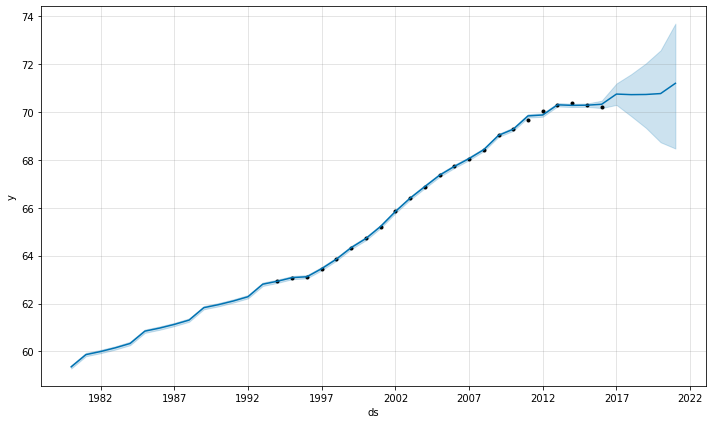

In [ ]:
fit_model_s(jpn_data_s)

In [ ]:
optimizer, _, _ = getOpt_s(jpn_data_s)

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 17.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/jc4rm9b8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/awbk0hq3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=15012', 'data', 'file=/tmp/tmppq7tkcfl/jc4rm9b8.json', 'init=/tmp/tmppq7tkcfl/awbk0hq3.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model_3szuefz/prophet_model-20221114003313.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:33:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmds

|   iter    |  target   | yearly... |
-------------------------------------


INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/i6qw_9_7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/un8_xpls.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=27817', 'data', 'file=/tmp/tmppq7tkcfl/i6qw_9_7.json', 'init=/tmp/tmppq7tkcfl/un8_xpls.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model6d205pfs/prophet_model-20221114003314.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:33:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:33:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/k8p1d1em.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.26     | -0.3319   |


INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/uupu5jjf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/sjb4l3kr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63912', 'data', 'file=/tmp/tmppq7tkcfl/uupu5jjf.json', 'init=/tmp/tmppq7tkcfl/sjb4l3kr.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model258bjxoy/prophet_model-20221114003323.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:33:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:33:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/xy9j8la3.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.267    | 0.8813    |


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/grwdan3x.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ya7jcblr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=17314', 'data', 'file=/tmp/tmppq7tkcfl/grwdan3x.json', 'init=/tmp/tmppq7tkcfl/ya7jcblr.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modell2y60xu2/prophet_model-20221114003333.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:33:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:33:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/_4m_00w1.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -0.2533   | -2.0      |


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/8m8g7t7s.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/_98o9f8f.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=38598', 'data', 'file=/tmp/tmppq7tkcfl/8m8g7t7s.json', 'init=/tmp/tmppq7tkcfl/_98o9f8f.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modela15cgd1d/prophet_model-20221114003343.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:33:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:33:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/muy3dtlp.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.255    | -0.7907   |


INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/o1q54n8v.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/eb36_dhf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=32850', 'data', 'file=/tmp/tmppq7tkcfl/o1q54n8v.json', 'init=/tmp/tmppq7tkcfl/eb36_dhf.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeld5wpss0i/prophet_model-20221114003353.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:33:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:33:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/g9gbl3iy.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.2557   | -1.413    |


INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/9esvg5vd.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/9xubs138.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=44945', 'data', 'file=/tmp/tmppq7tkcfl/9esvg5vd.json', 'init=/tmp/tmppq7tkcfl/9xubs138.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelyl1sxkz3/prophet_model-20221114003403.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:34:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:34:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/z8pdw6_7.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.2566   | -1.631    |


INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/8q30sril.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/7yftaslo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=554', 'data', 'file=/tmp/tmppq7tkcfl/8q30sril.json', 'init=/tmp/tmppq7tkcfl/7yftaslo.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelwby25203/prophet_model-20221114003413.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:34:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:34:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/1je14aae.json
DEBUG:cmdstanpy:input tempfile: /

| 7         | -0.2554   | -1.255    |


INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/akx4mnuv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/u0syab3_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=98472', 'data', 'file=/tmp/tmppq7tkcfl/akx4mnuv.json', 'init=/tmp/tmppq7tkcfl/u0syab3_.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model1_dgy5u8/prophet_model-20221114003424.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:34:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:34:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/d7bhe3_m.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.2558   | -0.6178   |


INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/h6v4j_w9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ybk5vc9o.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=66400', 'data', 'file=/tmp/tmppq7tkcfl/h6v4j_w9.json', 'init=/tmp/tmppq7tkcfl/ybk5vc9o.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeljit83oaz/prophet_model-20221114003434.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:34:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:34:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/bk7iz5z3.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -0.2579   | -0.4129   |


INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/tojw9sd8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/qb1iejo8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7920', 'data', 'file=/tmp/tmppq7tkcfl/tojw9sd8.json', 'init=/tmp/tmppq7tkcfl/qb1iejo8.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelwpf1quk2/prophet_model-20221114003444.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:34:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:34:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/re5c2ezd.json
DEBUG:cmdstanpy:input tempfile: 

| 10        | -0.2654   | 0.1553    |


00:34:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ywpf7iu9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/clfvi56u.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=58456', 'data', 'file=/tmp/tmppq7tkcfl/ywpf7iu9.json', 'init=/tmp/tmppq7tkcfl/clfvi56u.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelzzk7jiyk/prophet_model-20221114003453.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:34:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:34:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/35ovyx6z.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -0.2731   | 2.0       |


INFO:prophet:n_changepoints greater than number of observations. Using 17.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/2u7a1qqw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/5rlzpjim.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=35885', 'data', 'file=/tmp/tmppq7tkcfl/2u7a1qqw.json', 'init=/tmp/tmppq7tkcfl/5rlzpjim.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeltt9fys3d/prophet_model-20221114003504.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:35:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:35:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/j3tt_bxy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/43yhzeem.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=44346', 'data', 'file=/tmp/tmppq7tkcfl/j3tt_bxy.json', 'init=/tmp/tmppq7tkcfl/43yhzeem.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelf7uapjbr/prophet_model-20221114003504.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:35:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:35:04 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/pijteftp.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.2541   | -1.923    |


00:35:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/is1i0d4c.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/p1cysqkz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=58805', 'data', 'file=/tmp/tmppq7tkcfl/is1i0d4c.json', 'init=/tmp/tmppq7tkcfl/p1cysqkz.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelbbzsl2hd/prophet_model-20221114003514.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:35:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:35:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/h5nszh7d.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -0.2549   | -1.001    |


00:35:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 12 forecasts with cutoffs between 2004-01-04 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/pnkmgyws.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/boovpbl_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36257', 'data', 'file=/tmp/tmppq7tkcfl/pnkmgyws.json', 'init=/tmp/tmppq7tkcfl/boovpbl_.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelya87cta3/prophet_model-20221114003524.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:35:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:35:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/r2a5h79w.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -0.2549   | -1.001    |


INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 17.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/vj2kbniw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/eq8p7dna.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=6527', 'data', 'file=/tmp/tmppq7tkcfl/vj2kbniw.json', 'init=/tmp/tmppq7tkcfl/eq8p7dna.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelg5a1xnmn/prophet_model-20221114003534.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:35:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdst

  0%|          | 0/12 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/xomams7c.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/6kyy30l8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=48642', 'data', 'file=/tmp/tmppq7tkcfl/xomams7c.json', 'init=/tmp/tmppq7tkcfl/6kyy30l8.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelyoq7n5wj/prophet_model-20221114003534.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:35:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:35:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/1d80q52z.json
DEBUG:cmdstanpy:input tempfile:

--------------------Evaluation---------------------
MSE :  0.6333977434344644
MAE :  0.7619122491786712
MAPE :  1.0895006341038012
--------------------Evaluation---------------------


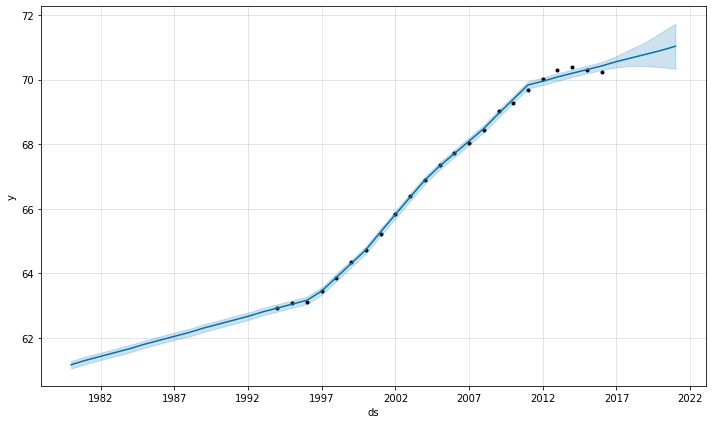

In [ ]:
evaluate_model_s(optimizer, jpn_data_s)

## Singapore

In [ ]:
generate_results_m(sgp_data_m, "SGP")
generate_results_s(sgp_data_s, "SGP")

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/9cfo4z4s.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb7lz_7lg/onlvypsl.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79567', 'data', 'file=/tmp/tmpb7lz_7lg/9cfo4z4s.json', 'init=/tmp/tmpb7lz_7lg/onlvypsl.json', 'output', 'file=/tmp/tmpb7lz_7lg/prophet_modeljgz6_wts/prophet_model-20221130040856.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
04:08:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing


|   iter    |  target   | yearly... |
-------------------------------------


04:08:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/w_dax26g.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/0os1a4w3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=4225', 'data', 'file=/tmp/tmpjad4h45l/w_dax26g.json', 'init=/tmp/tmpjad4h45l/0os1a4w3.json', 'output', 'file=/tmp/tmpjad4h45l/prophet_modelpbyu1xbn/prophet_model-20221022001755.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:17:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:17:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


--------------------Evaluation---------------------
MSE :  3.834845649268735
MAE :  1.7581067936322576
MAPE :  8.839313736315617
--------------------Evaluation---------------------


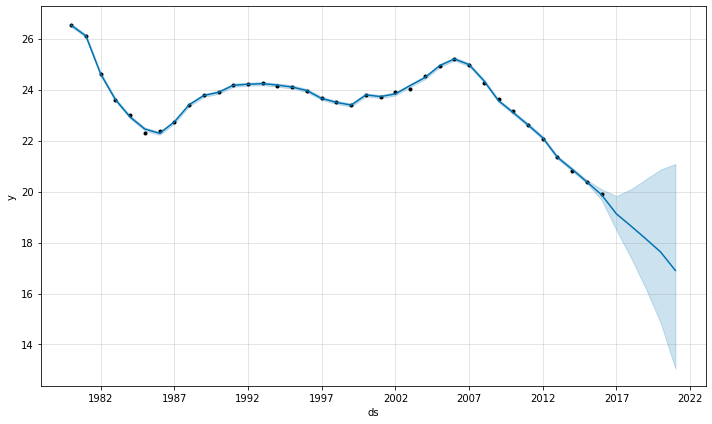

In [ ]:
fit_model_m(sgp_data_m)

In [ ]:
optimizer,_,_ = getOpt(sgp_data_m)

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/v56mxvgu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/bm00qwj9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=78390', 'data', 'file=/tmp/tmppq7tkcfl/v56mxvgu.json', 'init=/tmp/tmppq7tkcfl/bm00qwj9.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeleefh8xhn/prophet_model-20221113235356.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:53:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing


|   iter    |  target   | yearly... |
-------------------------------------


23:53:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/_wtyxte_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/xugkoubt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99364', 'data', 'file=/tmp/tmppq7tkcfl/_wtyxte_.json', 'init=/tmp/tmppq7tkcfl/xugkoubt.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelay40rfep/prophet_model-20221113235356.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:53:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:53:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/j84uykz5.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -1.169    | -0.3319   |


23:54:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/6tnofyuy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/deza5tks.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=5680', 'data', 'file=/tmp/tmppq7tkcfl/6tnofyuy.json', 'init=/tmp/tmppq7tkcfl/deza5tks.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelwmw97u0o/prophet_model-20221113235418.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:54:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:54:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/wjg1g46n.json
DEBUG:cmdstanpy:input tempfile: 

| 2         | -1.288    | 0.8813    |


23:54:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/hgt28zsz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/f6qq7o51.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=4852', 'data', 'file=/tmp/tmppq7tkcfl/hgt28zsz.json', 'init=/tmp/tmppq7tkcfl/f6qq7o51.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelxhi6ucx9/prophet_model-20221113235441.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:54:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:54:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/svpodf1k.json
DEBUG:cmdstanpy:input tempfile: 

| 3         | -1.168    | -2.0      |


23:55:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/l5ntfcyk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/wszcz8i5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=32222', 'data', 'file=/tmp/tmppq7tkcfl/l5ntfcyk.json', 'init=/tmp/tmppq7tkcfl/wszcz8i5.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelz0pej9_n/prophet_model-20221113235503.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:55:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:55:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/udpw6eqv.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -1.168    | -0.7907   |


23:55:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/jqf8kptn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ltfjo8dt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=41614', 'data', 'file=/tmp/tmppq7tkcfl/jqf8kptn.json', 'init=/tmp/tmppq7tkcfl/ltfjo8dt.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeluagb_ktn/prophet_model-20221113235526.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:55:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:55:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/2y16t17o.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -1.149    | -1.413    |


23:55:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/e2vbiuw9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/2ph1s_2a.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57988', 'data', 'file=/tmp/tmppq7tkcfl/e2vbiuw9.json', 'init=/tmp/tmppq7tkcfl/2ph1s_2a.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelwmjzc6rq/prophet_model-20221113235548.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:55:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:55:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/jwvoehgi.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -1.075    | -1.631    |


INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/v1e4mt77.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/zonmbw7a.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=14886', 'data', 'file=/tmp/tmppq7tkcfl/v1e4mt77.json', 'init=/tmp/tmppq7tkcfl/zonmbw7a.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelt3d8z9in/prophet_model-20221113235611.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:56:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:56:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/2svwp4qv.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -1.156    | -1.255    |


23:56:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/y5xjvbnc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/gjrhjcy7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=83066', 'data', 'file=/tmp/tmppq7tkcfl/y5xjvbnc.json', 'init=/tmp/tmppq7tkcfl/gjrhjcy7.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelttb2eayz/prophet_model-20221113235635.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:56:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:56:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/v8ihb09y.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -1.138    | -0.6178   |


23:56:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/dvj_1a11.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/dbo7kwph.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=52924', 'data', 'file=/tmp/tmppq7tkcfl/dvj_1a11.json', 'init=/tmp/tmppq7tkcfl/dbo7kwph.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelz2yb8p6i/prophet_model-20221113235657.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:56:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:56:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/9qmosj8m.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -1.178    | -0.4129   |


23:57:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/56y9sbz8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/6dqsje9c.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=98108', 'data', 'file=/tmp/tmppq7tkcfl/56y9sbz8.json', 'init=/tmp/tmppq7tkcfl/6dqsje9c.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelelultznz/prophet_model-20221113235720.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:57:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:57:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/t5d8ui_n.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -1.209    | 0.1553    |


23:57:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/s6_0v4xo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/mj6_wh8f.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=30747', 'data', 'file=/tmp/tmppq7tkcfl/s6_0v4xo.json', 'init=/tmp/tmppq7tkcfl/mj6_wh8f.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeletmez_z7/prophet_model-20221113235743.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:57:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:57:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/so3xtcrl.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -1.089    | -1.756    |


23:58:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/gp9afh1m.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/gf8l22ah.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=27116', 'data', 'file=/tmp/tmppq7tkcfl/gp9afh1m.json', 'init=/tmp/tmppq7tkcfl/gf8l22ah.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model_5gdkvzd/prophet_model-20221113235807.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:58:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:58:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/b_ems85d.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -1.156    | -1.622    |


23:58:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/3iv7n4zw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/09am_9yi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=3882', 'data', 'file=/tmp/tmppq7tkcfl/3iv7n4zw.json', 'init=/tmp/tmppq7tkcfl/09am_9yi.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model5qyn_srw/prophet_model-20221113235830.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:58:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:58:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/bxywsa7t.json
DEBUG:cmdstanpy:input tempfile: 

| 13        | -1.075    | -1.631    |


DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/jgiisme3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/zdb7j6ox.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=930', 'data', 'file=/tmp/tmppq7tkcfl/jgiisme3.json', 'init=/tmp/tmppq7tkcfl/zdb7j6ox.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model99qx2zm8/prophet_model-20221113235853.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:58:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:58:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/aiff3x5k.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/brzn64zc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60802', 'data', 'file=/tmp/tmppq7tkcfl/aiff3x5k.json', 'init=/tmp/tmppq7tkcfl/brzn64zc.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model2vt63tl6/prophet_model-20221113235854.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:58:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:58:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/0wwp0dif.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -1.147    | -1.643    |


INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/xzh9392a.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/j0ej4_d4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99059', 'data', 'file=/tmp/tmppq7tkcfl/xzh9392a.json', 'init=/tmp/tmppq7tkcfl/j0ej4_d4.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelp4pudw13/prophet_model-20221113235916.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:59:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:59:16 - cmdstanpy - INFO - Chain [1] do

  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/y4fkcd5c.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ikfr9k5w.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57307', 'data', 'file=/tmp/tmppq7tkcfl/y4fkcd5c.json', 'init=/tmp/tmppq7tkcfl/ikfr9k5w.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modellsz_b4qb/prophet_model-20221113235916.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:59:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:59:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/hx4la72w.json
DEBUG:cmdstanpy:input tempfile:

--------------------Evaluation---------------------
MSE :  0.31078282556903136
MAE :  0.4678674606352615
MAPE :  2.3593206204537474
--------------------Evaluation---------------------


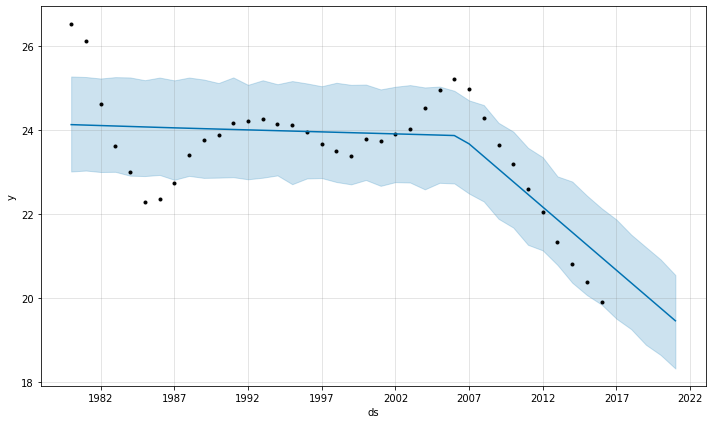

In [ ]:
evaluate_model(optimizer, sgp_data_m)

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/655n5mt7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/9dt2lw1f.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37068', 'data', 'file=/tmp/tmpjad4h45l/655n5mt7.json', 'init=/tmp/tmpjad4h45l/9dt2lw1f.json', 'output', 'file=/tmp/tmpjad4h45l/prophet_modelknqga6pv/prophet_model-20221022001812.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:18:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:18:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


--------------------Evaluation---------------------
MSE :  1.1744589832601917
MAE :  1.000725019010406
MAPE :  1.4437127525492497
--------------------Evaluation---------------------


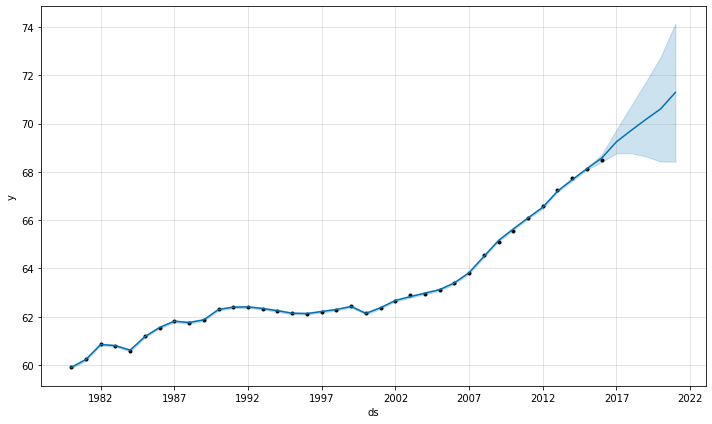

In [ ]:
fit_model_s(sgp_data_s)

In [ ]:
optimizer, _, _ = getOpt_s(sgp_data_s)

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/smlj740_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/q0dszaut.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99356', 'data', 'file=/tmp/tmppq7tkcfl/smlj740_.json', 'init=/tmp/tmppq7tkcfl/q0dszaut.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelf_c1vl_v/prophet_model-20221114003545.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:35:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing


|   iter    |  target   | yearly... |
-------------------------------------


00:35:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/60t4gv1f.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/14rq7399.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=14423', 'data', 'file=/tmp/tmppq7tkcfl/60t4gv1f.json', 'init=/tmp/tmppq7tkcfl/14rq7399.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelkg534uv2/prophet_model-20221114003545.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:35:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:35:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/szlpwn_o.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.3073   | -0.3319   |


00:36:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/esvqg2up.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/d03th2xp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=91602', 'data', 'file=/tmp/tmppq7tkcfl/esvqg2up.json', 'init=/tmp/tmppq7tkcfl/d03th2xp.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelpgzs9rkt/prophet_model-20221114003607.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:36:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:36:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/xu4n5v7c.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.3367   | 0.8813    |


00:36:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/h0jktu_q.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/43o2rnx1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=26987', 'data', 'file=/tmp/tmppq7tkcfl/h0jktu_q.json', 'init=/tmp/tmppq7tkcfl/43o2rnx1.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelthyhuvdi/prophet_model-20221114003629.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:36:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:36:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/w2yhia_2.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -0.284    | -2.0      |


00:36:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/hn65v5j4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/iadr1mo0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=2097', 'data', 'file=/tmp/tmppq7tkcfl/hn65v5j4.json', 'init=/tmp/tmppq7tkcfl/iadr1mo0.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeldm54hwav/prophet_model-20221114003652.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:36:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:36:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/a9rak60m.json
DEBUG:cmdstanpy:input tempfile: 

| 4         | -0.2989   | -0.7907   |


00:37:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/fcen6pmi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/gr86p61e.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=16490', 'data', 'file=/tmp/tmppq7tkcfl/fcen6pmi.json', 'init=/tmp/tmppq7tkcfl/gr86p61e.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelsk4vc9g1/prophet_model-20221114003715.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:37:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:37:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/w0wyngro.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.2859   | -1.413    |


00:37:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/y7gbtbp9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/54u_fx8q.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=62007', 'data', 'file=/tmp/tmppq7tkcfl/y7gbtbp9.json', 'init=/tmp/tmppq7tkcfl/54u_fx8q.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelpszfvrz_/prophet_model-20221114003738.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:37:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:37:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/1q74mtoa.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.2845   | -1.631    |


00:38:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/toahxa1k.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/q25gb2p6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=87091', 'data', 'file=/tmp/tmppq7tkcfl/toahxa1k.json', 'init=/tmp/tmppq7tkcfl/q25gb2p6.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelvs181paz/prophet_model-20221114003800.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:38:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:38:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/1ww18no8.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.2884   | -1.255    |


00:38:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/kpi87fmj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/q5tu7mgv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=87334', 'data', 'file=/tmp/tmppq7tkcfl/kpi87fmj.json', 'init=/tmp/tmppq7tkcfl/q5tu7mgv.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelr2_32umy/prophet_model-20221114003823.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:38:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:38:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/z1ju4tsc.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.3008   | -0.6178   |


00:38:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/59uy0qyb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/dpbm_8aq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=38504', 'data', 'file=/tmp/tmppq7tkcfl/59uy0qyb.json', 'init=/tmp/tmppq7tkcfl/dpbm_8aq.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model0jxwa790/prophet_model-20221114003846.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:38:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:38:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/xywl_ilj.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -0.3049   | -0.4129   |


00:39:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/dt4_lgra.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/3hwy8epz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=25498', 'data', 'file=/tmp/tmppq7tkcfl/dt4_lgra.json', 'init=/tmp/tmppq7tkcfl/3hwy8epz.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeluczjd_28/prophet_model-20221114003909.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:39:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:39:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/gyio7zv7.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -0.3233   | 0.1553    |


00:39:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/91s3xvox.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/epjp0q2z.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=4591', 'data', 'file=/tmp/tmppq7tkcfl/91s3xvox.json', 'init=/tmp/tmppq7tkcfl/epjp0q2z.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelhjvgd1ps/prophet_model-20221114003932.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:39:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:39:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/xpj16ac7.json
DEBUG:cmdstanpy:input tempfile: 

| 11        | -0.2839   | -1.856    |


DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=32790', 'data', 'file=/tmp/tmppq7tkcfl/z87onys6.json', 'init=/tmp/tmppq7tkcfl/28vc_4xz.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelhr5vb34o/prophet_model-20221114003955.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:39:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:39:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/r88189hl.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/iymfc02f.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36922', 'data', 'file=/tmp/tmppq7tkcfl/r88189hl.json', 'init=/tmp/tmppq7tkcfl/iymfc02f.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model538k64ie/prophet_model-20221114003956.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:39:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:39:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/v6pe95sa.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.2841   | -1.921    |


00:40:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/lyb8bw1f.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/syinjo3e.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=1816', 'data', 'file=/tmp/tmppq7tkcfl/lyb8bw1f.json', 'init=/tmp/tmppq7tkcfl/syinjo3e.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeljj2xy_9r/prophet_model-20221114004019.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:40:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:40:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/_v2zxsf4.json
DEBUG:cmdstanpy:input tempfile: 

| 13        | -0.3315   | 2.0       |


00:40:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 26 forecasts with cutoffs between 1990-01-07 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/tkv_z9ii.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/vvter896.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73297', 'data', 'file=/tmp/tmppq7tkcfl/tkv_z9ii.json', 'init=/tmp/tmppq7tkcfl/vvter896.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelr8oo6_zc/prophet_model-20221114004043.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:40:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:40:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/mjxr_1nf.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -0.2839   | -1.773    |


INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/oo94r7j0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/lwk1a10m.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=3073', 'data', 'file=/tmp/tmppq7tkcfl/oo94r7j0.json', 'init=/tmp/tmppq7tkcfl/lwk1a10m.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelcwg3dq7o/prophet_model-20221114004106.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:41:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:41:07 - cmdstanpy - INFO - Chain [1] don

  0%|          | 0/26 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/n9jgct58.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/wx7zrrrt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39443', 'data', 'file=/tmp/tmppq7tkcfl/n9jgct58.json', 'init=/tmp/tmppq7tkcfl/wx7zrrrt.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model52gqh6re/prophet_model-20221114004107.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:41:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:41:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/vh5kdnpe.json
DEBUG:cmdstanpy:input tempfile:

--------------------Evaluation---------------------
MSE :  1.2395465258282166
MAE :  1.0269976147950928
MAPE :  1.4814088407868835
--------------------Evaluation---------------------


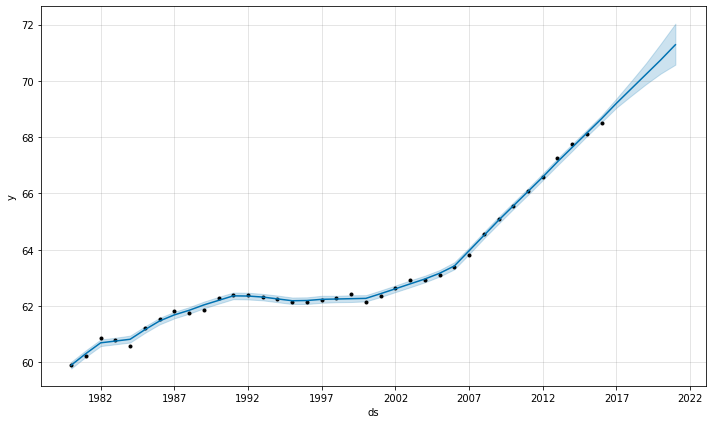

In [ ]:
evaluate_model_s(optimizer, sgp_data_s)

## The United States

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 15.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/0o0jcnzc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/tjxl6u4y.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=29868', 'data', 'file=/tmp/tmpu84toiig/0o0jcnzc.json', 'init=/tmp/tmpu84toiig/tjxl6u4y.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelkjz8x03r/prophet_model-20221130161054.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:10:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmds

|   iter    |  target   | yearly... |
-------------------------------------


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/odzj8aqf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/t1e9gk8i.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=54400', 'data', 'file=/tmp/tmpu84toiig/odzj8aqf.json', 'init=/tmp/tmpu84toiig/t1e9gk8i.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model86wpoccr/prophet_model-20221130161054.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:10:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:10:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/vu61k9uk.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.367    | -0.3319   |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/5o8ip57s.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/97gid3sa.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89343', 'data', 'file=/tmp/tmpu84toiig/5o8ip57s.json', 'init=/tmp/tmpu84toiig/97gid3sa.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model9buot36u/prophet_model-20221130161101.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:11:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:11:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ujcer6f5.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.3549   | 0.8813    |


INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/2dw3c4z1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/3rwjbvf_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=65651', 'data', 'file=/tmp/tmpu84toiig/2dw3c4z1.json', 'init=/tmp/tmpu84toiig/3rwjbvf_.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelxq6kkk88/prophet_model-20221130161108.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:11:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:11:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/mgqy0d5x.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -0.3389   | -2.0      |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/dov52wvm.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ytl_2kcz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=90111', 'data', 'file=/tmp/tmpu84toiig/dov52wvm.json', 'init=/tmp/tmpu84toiig/ytl_2kcz.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelcjpa_oep/prophet_model-20221130161114.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:11:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:11:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/tas5g2cl.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.3314   | -0.7907   |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/lb3iot3r.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/jjirj0o5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=27494', 'data', 'file=/tmp/tmpu84toiig/lb3iot3r.json', 'init=/tmp/tmpu84toiig/jjirj0o5.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelfnwrwo1i/prophet_model-20221130161121.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:11:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:11:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/_b70jne1.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.3327   | -1.413    |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/w543iuph.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ti337fkh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53745', 'data', 'file=/tmp/tmpu84toiig/w543iuph.json', 'init=/tmp/tmpu84toiig/ti337fkh.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modeluc87nkig/prophet_model-20221130161128.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:11:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:11:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/vzdlom01.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.3345   | -1.631    |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/zg8ft4ix.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/9vx6r2b2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=16229', 'data', 'file=/tmp/tmpu84toiig/zg8ft4ix.json', 'init=/tmp/tmpu84toiig/9vx6r2b2.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelqwiidr97/prophet_model-20221130161135.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:11:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:11:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/hxyr0wqe.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.3284   | -1.255    |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/1xtbzumw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/1qwk5iak.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=28751', 'data', 'file=/tmp/tmpu84toiig/1xtbzumw.json', 'init=/tmp/tmpu84toiig/1qwk5iak.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model22e0i12h/prophet_model-20221130161141.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:11:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:11:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/u32oppak.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.3517   | -0.6178   |


INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/9aye3nne.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/n3symcte.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=11025', 'data', 'file=/tmp/tmpu84toiig/9aye3nne.json', 'init=/tmp/tmpu84toiig/n3symcte.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modeluvvkfpdp/prophet_model-20221130161148.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:11:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:11:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/3ii652v9.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -0.3556   | -0.4129   |


INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/aqc4souu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/8xh_r48b.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=71216', 'data', 'file=/tmp/tmpu84toiig/aqc4souu.json', 'init=/tmp/tmpu84toiig/8xh_r48b.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelphvuq0_g/prophet_model-20221130161155.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:11:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:11:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/6catz4wl.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -0.373    | 0.1553    |


16:12:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/anczs6_o.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/_mrb3t7q.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=19371', 'data', 'file=/tmp/tmpu84toiig/anczs6_o.json', 'init=/tmp/tmpu84toiig/_mrb3t7q.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modely6zain0t/prophet_model-20221130161202.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:12:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:12:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/l_aa1cfm.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -0.3353   | -1.011    |


16:12:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/3ecp58yg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ktmxc3mp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=65775', 'data', 'file=/tmp/tmpu84toiig/3ecp58yg.json', 'init=/tmp/tmpu84toiig/ktmxc3mp.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model3j6051xh/prophet_model-20221130161209.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:12:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:12:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/7b2uy4s1.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.3329   | -1.245    |


16:12:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/tgd5m8bz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/rwvf1njn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84658', 'data', 'file=/tmp/tmpu84toiig/tgd5m8bz.json', 'init=/tmp/tmpu84toiig/rwvf1njn.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelx9rgfnhg/prophet_model-20221130161216.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:12:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:12:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/5pcha53i.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -0.3328   | -1.325    |


16:12:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/lehwf86b.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/iodxa4_a.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=77502', 'data', 'file=/tmp/tmpu84toiig/lehwf86b.json', 'init=/tmp/tmpu84toiig/iodxa4_a.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modellypb1310/prophet_model-20221130161223.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:12:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:12:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/8oyuc61z.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -0.3339   | -0.8786   |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/zlvoi16d.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/oy1k9i_i.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=69001', 'data', 'file=/tmp/tmpu84toiig/zlvoi16d.json', 'init=/tmp/tmpu84toiig/oy1k9i_i.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelzpnvnith/prophet_model-20221130161230.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:12:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:12:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/id4w2tbh.json
DEBUG:cmdstanpy:input tempfile:

Index(['ds', 'trend', 'yhat_lower', 'yhat_upper', 'trend_lower', 'trend_upper',
       'additive_terms', 'additive_terms_lower', 'additive_terms_upper',
       'yearly', 'yearly_lower', 'yearly_upper', 'multiplicative_terms',
       'multiplicative_terms_lower', 'multiplicative_terms_upper', 'yhat'],
      dtype='object')
|   iter    |  target   | yearly... |
-------------------------------------


16:12:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/6iigm0m4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/d6anyk4j.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=2758', 'data', 'file=/tmp/tmpu84toiig/6iigm0m4.json', 'init=/tmp/tmpu84toiig/d6anyk4j.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelbqs1mtc7/prophet_model-20221130161238.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:12:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:12:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/nvn0263z.json
DEBUG:cmdstanpy:input tempfile: 

| 1         | -0.3504   | -0.3319   |


16:12:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/q84e5cga.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ebuwm4f0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12653', 'data', 'file=/tmp/tmpu84toiig/q84e5cga.json', 'init=/tmp/tmpu84toiig/ebuwm4f0.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model2ii_uv7e/prophet_model-20221130161248.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:12:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:12:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/kqzxmq4q.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.3981   | 0.8813    |


INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/notbowsi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/8zxwght8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=21235', 'data', 'file=/tmp/tmpu84toiig/notbowsi.json', 'init=/tmp/tmpu84toiig/8zxwght8.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modely31o5rin/prophet_model-20221130161259.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:12:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:12:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/t15j5l8c.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -0.3472   | -2.0      |


16:13:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/y5ec5mgm.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ojpttcec.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=15099', 'data', 'file=/tmp/tmpu84toiig/y5ec5mgm.json', 'init=/tmp/tmpu84toiig/ojpttcec.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelpuw9nwah/prophet_model-20221130161310.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:13:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:13:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/md7o7fi9.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.3367   | -0.7907   |


16:13:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/xg46irg_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/eiqpbvm2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63523', 'data', 'file=/tmp/tmpu84toiig/xg46irg_.json', 'init=/tmp/tmpu84toiig/eiqpbvm2.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modeldq4wgnki/prophet_model-20221130161323.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:13:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:13:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ecsx1798.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.3419   | -1.413    |


INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/lcq1xng6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/szbjzloe.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=44431', 'data', 'file=/tmp/tmpu84toiig/lcq1xng6.json', 'init=/tmp/tmpu84toiig/szbjzloe.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modeliaoqnlho/prophet_model-20221130161334.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:13:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:13:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/8a7r1f6q.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.3435   | -1.631    |


16:13:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/m0updorf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/9takpwh9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=86879', 'data', 'file=/tmp/tmpu84toiig/m0updorf.json', 'init=/tmp/tmpu84toiig/9takpwh9.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelwg1hh4pa/prophet_model-20221130161344.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:13:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:13:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/6ta2_rho.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.3383   | -1.255    |


16:13:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/64v2dqz7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/dyq2liqm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=11973', 'data', 'file=/tmp/tmpu84toiig/64v2dqz7.json', 'init=/tmp/tmpu84toiig/dyq2liqm.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model4758noq0/prophet_model-20221130161356.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:13:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:13:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/kf4ii4su.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.3429   | -0.6178   |


16:14:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/fuse4y0t.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/1owz01jl.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=69794', 'data', 'file=/tmp/tmpu84toiig/fuse4y0t.json', 'init=/tmp/tmpu84toiig/1owz01jl.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelufxuy31z/prophet_model-20221130161407.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:14:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:14:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/5oz002hb.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -0.3446   | -0.4129   |


16:14:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/3n1i1z_1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/v9q3z080.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60898', 'data', 'file=/tmp/tmpu84toiig/3n1i1z_1.json', 'init=/tmp/tmpu84toiig/v9q3z080.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model8c9geg3_/prophet_model-20221130161418.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:14:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:14:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/jhz92nbn.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -0.3605   | 0.1553    |


16:14:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/9h3upbmp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/sgqrqlw9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=5543', 'data', 'file=/tmp/tmpu84toiig/9h3upbmp.json', 'init=/tmp/tmpu84toiig/sgqrqlw9.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model5449_y2g/prophet_model-20221130161429.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:14:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:14:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/jb5xdkib.json
DEBUG:cmdstanpy:input tempfile: 

| 11        | -0.6394   | 2.0       |


16:14:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/azccv4ms.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/1e5vtew_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7124', 'data', 'file=/tmp/tmpu84toiig/azccv4ms.json', 'init=/tmp/tmpu84toiig/1e5vtew_.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelyx_eeveg/prophet_model-20221130161440.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:14:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:14:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/l0e3a9m9.json
DEBUG:cmdstanpy:input tempfile: 

| 12        | -0.3723   | 0.4962    |


DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60817', 'data', 'file=/tmp/tmpu84toiig/9mfkg2xz.json', 'init=/tmp/tmpu84toiig/btgood9o.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modellqacochk/prophet_model-20221130161451.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:14:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:14:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/403020xv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/4jv6qpen.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=72470', 'data', 'file=/tmp/tmpu84toiig/403020xv.json', 'init=/tmp/tmpu84toiig/4jv6qpen.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model2r93s19b/prophet_model-20221130161451.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:14:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:14:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/sb8lmjv8.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -0.3375   | -1.008    |


16:15:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/85b22civ.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ose3po6g.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57863', 'data', 'file=/tmp/tmpu84toiig/85b22civ.json', 'init=/tmp/tmpu84toiig/ose3po6g.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelp3edcs33/prophet_model-20221130161502.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:15:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:15:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/qur6qnpy.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -0.3489   | -1.827    |


16:15:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ujt1yt8i.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/69tdrqpl.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=61800', 'data', 'file=/tmp/tmpu84toiig/ujt1yt8i.json', 'init=/tmp/tmpu84toiig/69tdrqpl.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model3r4yh1an/prophet_model-20221130161513.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:15:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:15:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/gubhi9h5.json
DEBUG:cmdstanpy:input tempfile:

Index(['ds', 'trend', 'yhat_lower', 'yhat_upper', 'trend_lower', 'trend_upper',
       'additive_terms', 'additive_terms_lower', 'additive_terms_upper',
       'yearly', 'yearly_lower', 'yearly_upper', 'multiplicative_terms',
       'multiplicative_terms_lower', 'multiplicative_terms_upper', 'yhat'],
      dtype='object')


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:70: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:78: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 15.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/s2unhavl.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/l_bngys9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37804', 'data', 'file

|   iter    |  target   | yearly... |
-------------------------------------


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/fd1hmz9r.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/m7bf73fv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=52223', 'data', 'file=/tmp/tmpu84toiig/fd1hmz9r.json', 'init=/tmp/tmpu84toiig/m7bf73fv.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modeltij6qf5v/prophet_model-20221130161526.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:15:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:15:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/j653epst.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -1.169    | -0.3319   |


INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/yon250f2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/dlk1h54f.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79901', 'data', 'file=/tmp/tmpu84toiig/yon250f2.json', 'init=/tmp/tmpu84toiig/dlk1h54f.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelxn4ouhjn/prophet_model-20221130161533.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:15:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:15:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/hm38pk6b.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -1.456    | 0.8813    |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/bdomean8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/6eex_bzn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=44793', 'data', 'file=/tmp/tmpu84toiig/bdomean8.json', 'init=/tmp/tmpu84toiig/6eex_bzn.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modely6dsz560/prophet_model-20221130161540.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:15:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:15:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/sbrue_no.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -1.139    | -2.0      |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/3_biu9vz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/e03b7fd9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79758', 'data', 'file=/tmp/tmpu84toiig/3_biu9vz.json', 'init=/tmp/tmpu84toiig/e03b7fd9.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model1_hagsud/prophet_model-20221130161547.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:15:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:15:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/gfnkjnpi.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -1.168    | -0.7907   |


INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/g7snxgk7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/yuu7m_bb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=44886', 'data', 'file=/tmp/tmpu84toiig/g7snxgk7.json', 'init=/tmp/tmpu84toiig/yuu7m_bb.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelc820beck/prophet_model-20221130161555.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:15:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:15:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/00uqiyd0.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -1.143    | -1.413    |


INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/2ene_chs.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/fis3kq2k.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=21888', 'data', 'file=/tmp/tmpu84toiig/2ene_chs.json', 'init=/tmp/tmpu84toiig/fis3kq2k.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelfvtowbws/prophet_model-20221130161602.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:16:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:16:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/lr80p2r0.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -1.144    | -1.631    |


16:16:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/uz95wp3k.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/d0no6pwh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37107', 'data', 'file=/tmp/tmpu84toiig/uz95wp3k.json', 'init=/tmp/tmpu84toiig/d0no6pwh.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modeloa9n4fku/prophet_model-20221130161609.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:16:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:16:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/xebargnd.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -1.144    | -1.255    |


16:16:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/fhh4p52c.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/pjiclx3e.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=22305', 'data', 'file=/tmp/tmpu84toiig/fhh4p52c.json', 'init=/tmp/tmpu84toiig/pjiclx3e.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model6m68640e/prophet_model-20221130161616.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:16:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:16:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/apeo10ki.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -1.168    | -0.6178   |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/wkx34802.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/kzge7ttt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=14954', 'data', 'file=/tmp/tmpu84toiig/wkx34802.json', 'init=/tmp/tmpu84toiig/kzge7ttt.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model5b7a18es/prophet_model-20221130161624.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:16:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:16:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/zzpv__12.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -1.177    | -0.4129   |


16:16:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/1_j6lfqn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/fldd0gfd.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=44337', 'data', 'file=/tmp/tmpu84toiig/1_j6lfqn.json', 'init=/tmp/tmpu84toiig/fldd0gfd.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelkhsmqnoq/prophet_model-20221130161631.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:16:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:16:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/31_c2jft.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -1.198    | 0.1553    |


16:16:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/1a4izowq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/zxqsdave.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=8821', 'data', 'file=/tmp/tmpu84toiig/1a4izowq.json', 'init=/tmp/tmpu84toiig/zxqsdave.json', 'output', 'file=/tmp/tmpu84toiig/prophet_models6igs8jn/prophet_model-20221130161638.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:16:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:16:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/2lwl10v7.json
DEBUG:cmdstanpy:input tempfile: 

| 11        | -1.746    | 2.0       |


16:16:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/5q441wgd.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/84rs_0fo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=15501', 'data', 'file=/tmp/tmpu84toiig/5q441wgd.json', 'init=/tmp/tmpu84toiig/84rs_0fo.json', 'output', 'file=/tmp/tmpu84toiig/prophet_model6ivde6bb/prophet_model-20221130161645.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:16:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:16:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/4x982ao8.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -1.14     | -1.851    |


DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/s8nl__u3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/6l8_woy2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=68343', 'data', 'file=/tmp/tmpu84toiig/s8nl__u3.json', 'init=/tmp/tmpu84toiig/6l8_woy2.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modeljjwf64f5/prophet_model-20221130161652.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:16:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:16:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/mcj3xpv4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/u5aeig_b.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=82982', 'data', 'file=/tmp/tmpu84toiig/mcj3xpv4.json', 'init=/tmp/tmpu84toiig/u5aeig_b.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelgbp9azbm/prophet_model-20221130161653.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:16:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:16:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/dvwwoqze.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -1.173    | -0.0897   |


16:17:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/80c6r3_c.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/yy3knzeb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=11646', 'data', 'file=/tmp/tmpu84toiig/80c6r3_c.json', 'init=/tmp/tmpu84toiig/yy3knzeb.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modeldhn6i1a8/prophet_model-20221130161700.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:17:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:17:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/uk9jc1bz.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -1.151    | -1.098    |


16:17:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/x4_z443j.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/2emw4qvi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=87674', 'data', 'file=/tmp/tmpu84toiig/x4_z443j.json', 'init=/tmp/tmpu84toiig/2emw4qvi.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelhi7fjkv1/prophet_model-20221130161707.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:17:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:17:07 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/51uu6t4a.json
DEBUG:cmdstanpy:input tempfile:

|   iter    |  target   | yearly... |
-------------------------------------


16:17:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/w8vpawyy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/vm8ofp0q.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=30197', 'data', 'file=/tmp/tmpu84toiig/w8vpawyy.json', 'init=/tmp/tmpu84toiig/vm8ofp0q.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelvhampos1/prophet_model-20221130161716.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:17:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:17:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/hhs511sn.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -1.211    | -0.3319   |


16:17:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/2x11ju9g.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/vp5dhxjd.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=25', 'data', 'file=/tmp/tmpu84toiig/2x11ju9g.json', 'init=/tmp/tmpu84toiig/vp5dhxjd.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelfu_gfm2y/prophet_model-20221130161727.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:17:27 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:17:27 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/8ujsnqnx.json
DEBUG:cmdstanpy:input tempfile: /t

| 2         | -1.389    | 0.8813    |


16:17:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/nio1gs9z.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/zhj3soeh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=11400', 'data', 'file=/tmp/tmpu84toiig/nio1gs9z.json', 'init=/tmp/tmpu84toiig/zhj3soeh.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelyiwzqljk/prophet_model-20221130161738.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:17:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:17:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/7ojkbuog.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -1.169    | -2.0      |


16:17:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/hqoevsid.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/13lttmy8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89899', 'data', 'file=/tmp/tmpu84toiig/hqoevsid.json', 'init=/tmp/tmpu84toiig/13lttmy8.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelwsliit_f/prophet_model-20221130161749.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:17:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:17:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/26zf4z29.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -1.182    | -0.7907   |


16:18:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/hcyy2puu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/gkf1jliz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=86869', 'data', 'file=/tmp/tmpu84toiig/hcyy2puu.json', 'init=/tmp/tmpu84toiig/gkf1jliz.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelzx4g18d9/prophet_model-20221130161800.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:18:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:18:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/37e5nx2i.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -1.187    | -1.413    |


16:18:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/abphp1tv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/k2sw4og_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=14631', 'data', 'file=/tmp/tmpu84toiig/abphp1tv.json', 'init=/tmp/tmpu84toiig/k2sw4og_.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelj1t7j_ow/prophet_model-20221130161812.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:18:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:18:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/hvut0ifx.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -1.175    | -1.631    |


16:18:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/ixf1elqu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/sw9fg6n9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=2735', 'data', 'file=/tmp/tmpu84toiig/ixf1elqu.json', 'init=/tmp/tmpu84toiig/sw9fg6n9.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelbqdj3a6t/prophet_model-20221130161823.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:18:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:18:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/lyly7xpj.json
DEBUG:cmdstanpy:input tempfile: 

| 7         | -1.186    | -1.255    |


16:18:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/b344cl25.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/cm5h305_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=69443', 'data', 'file=/tmp/tmpu84toiig/b344cl25.json', 'init=/tmp/tmpu84toiig/cm5h305_.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelbxwr8d4r/prophet_model-20221130161836.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:18:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:18:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/siau6hwv.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -1.184    | -0.6178   |


16:18:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/tsexfh0v.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/_a94da9c.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79218', 'data', 'file=/tmp/tmpu84toiig/tsexfh0v.json', 'init=/tmp/tmpu84toiig/_a94da9c.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelb_x9xc1q/prophet_model-20221130161847.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:18:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:18:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/cc59ykf2.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -1.216    | -0.4129   |


16:18:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/yd0s8zma.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/lu1ym8ir.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7648', 'data', 'file=/tmp/tmpu84toiig/yd0s8zma.json', 'init=/tmp/tmpu84toiig/lu1ym8ir.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelw09ysjcs/prophet_model-20221130161859.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:18:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:18:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/gk3zl5xd.json
DEBUG:cmdstanpy:input tempfile: 

| 10        | -1.226    | 0.1553    |


16:19:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/pj93xuui.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/w69honcm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=28483', 'data', 'file=/tmp/tmpu84toiig/pj93xuui.json', 'init=/tmp/tmpu84toiig/w69honcm.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modellvgxhxjh/prophet_model-20221130161910.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:19:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:19:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/b50dwlpo.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -1.598    | 2.0       |


16:19:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/tjc_eymn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/jr5gjqfb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=19422', 'data', 'file=/tmp/tmpu84toiig/tjc_eymn.json', 'init=/tmp/tmpu84toiig/jr5gjqfb.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modely7ouplx5/prophet_model-20221130161922.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:19:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:19:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/zwgsf33q.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -1.17     | -1.839    |


16:19:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/jr376j7x.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/_lqqhqt3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=50438', 'data', 'file=/tmp/tmpu84toiig/jr376j7x.json', 'init=/tmp/tmpu84toiig/_lqqhqt3.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modeloct41qx2/prophet_model-20221130161934.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:19:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:19:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/novy9d4r.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -1.156    | -1.974    |


16:19:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/akfexp5_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/03fjii2b.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=74338', 'data', 'file=/tmp/tmpu84toiig/akfexp5_.json', 'init=/tmp/tmpu84toiig/03fjii2b.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelbov8jgyf/prophet_model-20221130161945.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:19:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:19:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/z5bmxq_9.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -1.178    | -1.98     |


16:19:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 14 forecasts with cutoffs between 2007-01-05 00:00:00 and 2020-01-02 00:00:00


  0%|          | 0/14 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/e2a7tq_k.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/zt6oq7l8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=42629', 'data', 'file=/tmp/tmpu84toiig/e2a7tq_k.json', 'init=/tmp/tmpu84toiig/zt6oq7l8.json', 'output', 'file=/tmp/tmpu84toiig/prophet_modelxsurcdzg/prophet_model-20221130161957.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
16:19:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:19:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpu84toiig/02zxghle.json
DEBUG:cmdstanpy:input tempfile:

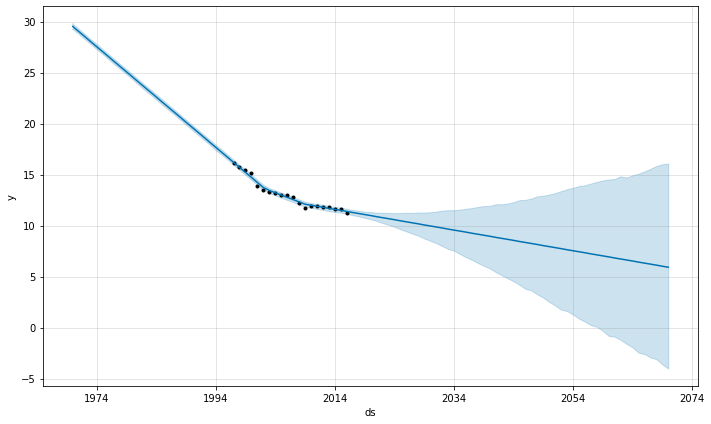

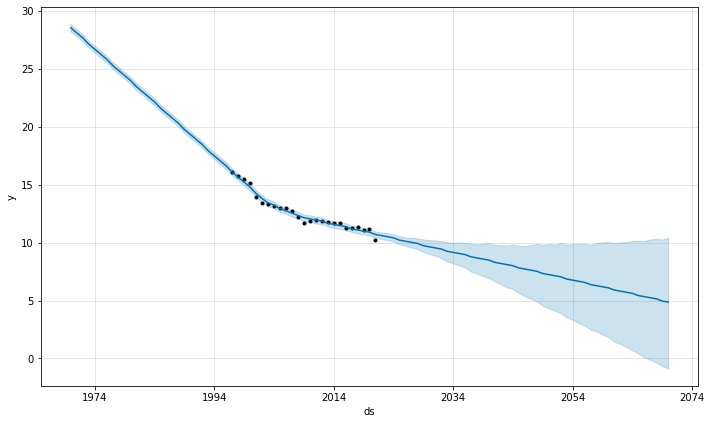

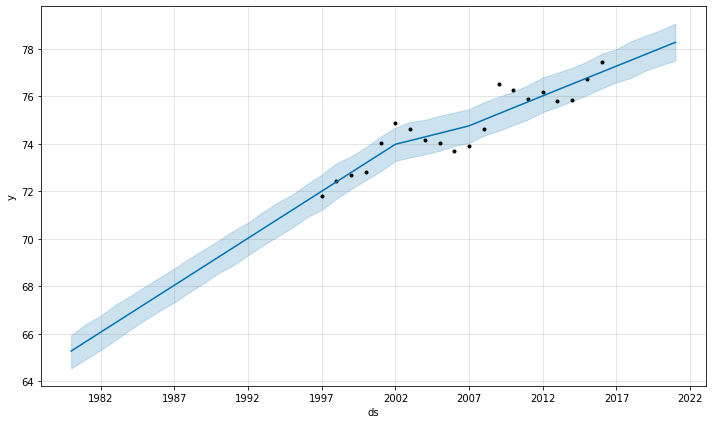

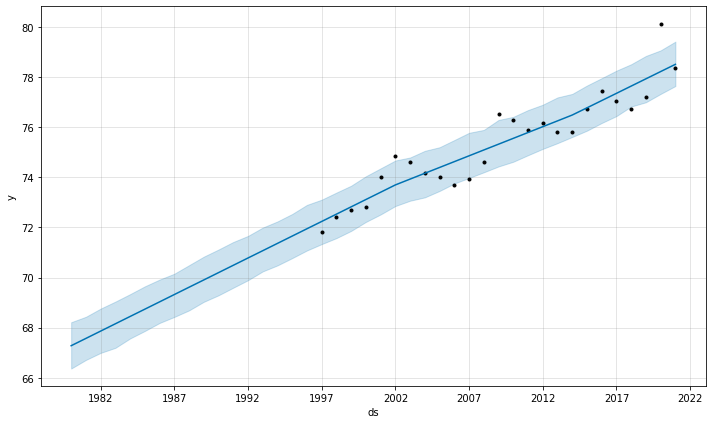

In [27]:
generate_results_m(usa_data_m, "USA")
generate_results_s(usa_data_s, "USA")

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 15.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/fpawsuiy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/u9uoycui.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=28735', 'data', 'file=/tmp/tmpjad4h45l/fpawsuiy.json', 'init=/tmp/tmpjad4h45l/u9uoycui.json', 'output', 'file=/tmp/tmpjad4h45l/prophet_model7sc1tp1h/prophet_model-20221022001832.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:18:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:18:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:c

--------------------Evaluation---------------------
MSE :  0.0019916258130815616
MAE :  0.03243005258463505
MAPE :  0.27818648599107754
--------------------Evaluation---------------------


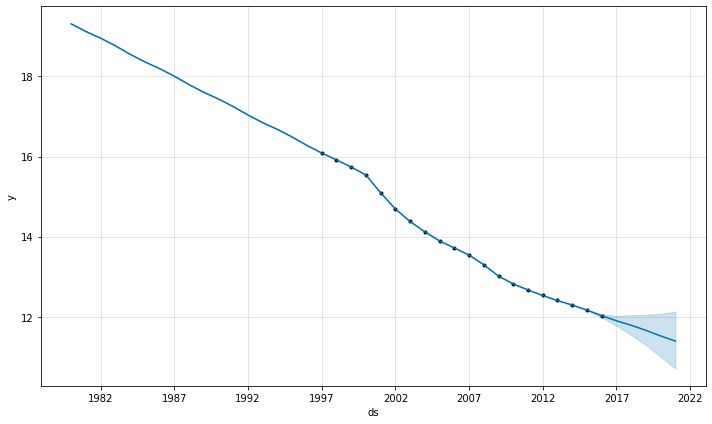

In [ ]:
fit_model_m(usa_data_m)

In [ ]:
optimizer, _, _ = getOpt(usa_data_m)

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 15.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/6d82kzh2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/5v1gyhza.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=24273', 'data', 'file=/tmp/tmppq7tkcfl/6d82kzh2.json', 'init=/tmp/tmppq7tkcfl/5v1gyhza.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelrzynfd1j/prophet_model-20221113235940.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:59:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmds

|   iter    |  target   | yearly... |
-------------------------------------


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/c8kej_wr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/h4ky77m8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=9829', 'data', 'file=/tmp/tmppq7tkcfl/c8kej_wr.json', 'init=/tmp/tmppq7tkcfl/h4ky77m8.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model7ykyo_3e/prophet_model-20221113235940.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:59:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:59:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/jwo9uhvq.json
DEBUG:cmdstanpy:input tempfile: 

| 1         | -0.08244  | -0.3319   |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/u2n62jt6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/jaipbbkr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37800', 'data', 'file=/tmp/tmppq7tkcfl/u2n62jt6.json', 'init=/tmp/tmppq7tkcfl/jaipbbkr.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeloh7z5wqs/prophet_model-20221113235947.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:59:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:59:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/_s7lw3vz.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.09801  | 0.8813    |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/gu7br0pz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/etcgd5rr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=8918', 'data', 'file=/tmp/tmppq7tkcfl/gu7br0pz.json', 'init=/tmp/tmppq7tkcfl/etcgd5rr.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model7srbd3oe/prophet_model-20221113235954.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:59:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:59:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/kel9wy_k.json
DEBUG:cmdstanpy:input tempfile: 

| 3         | -0.0787   | -2.0      |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/35ukh_df.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ycvj1bk7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=30926', 'data', 'file=/tmp/tmppq7tkcfl/35ukh_df.json', 'init=/tmp/tmppq7tkcfl/ycvj1bk7.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model9_pnbrc5/prophet_model-20221114000001.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:00:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:00:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/n6xnfujk.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.08142  | -0.7907   |


00:00:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/cjd8tm23.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/168xxvjr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=29399', 'data', 'file=/tmp/tmppq7tkcfl/cjd8tm23.json', 'init=/tmp/tmppq7tkcfl/168xxvjr.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model0v4n5ay1/prophet_model-20221114000010.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:00:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:00:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/bwueackh.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.07507  | -1.413    |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/nk4skcil.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/dw1wmnlj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=27760', 'data', 'file=/tmp/tmppq7tkcfl/nk4skcil.json', 'init=/tmp/tmppq7tkcfl/dw1wmnlj.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelwax2zx9i/prophet_model-20221114000017.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:00:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:00:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/4nl9576x.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.07687  | -1.631    |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/lc3z07yy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/8a8kj980.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=10728', 'data', 'file=/tmp/tmppq7tkcfl/lc3z07yy.json', 'init=/tmp/tmppq7tkcfl/8a8kj980.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeleb5455n1/prophet_model-20221114000024.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:00:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:00:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/d2tb7_5w.json
DEBUG:cmdstanpy:input tempfile:

| 7         | -0.07995  | -1.255    |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/y54km4fv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/gzcjwhiy.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70548', 'data', 'file=/tmp/tmppq7tkcfl/y54km4fv.json', 'init=/tmp/tmppq7tkcfl/gzcjwhiy.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelq3_mbokm/prophet_model-20221114000031.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:00:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:00:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/8jy4sptn.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.08165  | -0.6178   |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/b8phsnjp.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/6b3_vb3f.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39704', 'data', 'file=/tmp/tmppq7tkcfl/b8phsnjp.json', 'init=/tmp/tmppq7tkcfl/6b3_vb3f.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeli1jibozx/prophet_model-20221114000038.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:00:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:00:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/jor7bybu.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -0.08212  | -0.4129   |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/2vepaanh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/1s1_67wf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=71296', 'data', 'file=/tmp/tmppq7tkcfl/2vepaanh.json', 'init=/tmp/tmppq7tkcfl/1s1_67wf.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model0bsy3xpz/prophet_model-20221114000045.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:00:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:00:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/8_qljifg.json
DEBUG:cmdstanpy:input tempfile:

| 10        | -0.09002  | 0.1553    |


00:00:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/dxpa6n6o.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/3cqokyl2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=10944', 'data', 'file=/tmp/tmppq7tkcfl/dxpa6n6o.json', 'init=/tmp/tmppq7tkcfl/3cqokyl2.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelzx77eva3/prophet_model-20221114000054.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:00:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:00:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/_qafnaka.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -0.1029   | 2.0       |


00:01:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/k2fhlvgv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/jtqzue5_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99829', 'data', 'file=/tmp/tmppq7tkcfl/k2fhlvgv.json', 'init=/tmp/tmppq7tkcfl/jtqzue5_.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelwfzv7c6g/prophet_model-20221114000101.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:01:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:01:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ckz5jjdo.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.0759   | -1.499    |


INFO:prophet:n_changepoints greater than number of observations. Using 15.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/f80cjw14.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/y0qi2jjk.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=94244', 'data', 'file=/tmp/tmppq7tkcfl/f80cjw14.json', 'init=/tmp/tmppq7tkcfl/y0qi2jjk.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelfc5hnz0z/prophet_model-20221114000108.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:01:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:01:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/dvjghcvh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/edgajwhm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=17731', 'data', 'file=/tmp/tmppq7tkcfl/dvjghcvh.json', 'init=/tmp/tmppq7tkcfl/edgajwhm.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model58qp8qbm/prophet_model-20221114000108.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:01:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:01:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ffnqa6l_.json
DEBUG:cmdstanpy:input tempfile:

| 13        | -0.07926  | -1.822    |


00:01:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/g9na2mm8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/k55ndzhg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=10805', 'data', 'file=/tmp/tmppq7tkcfl/g9na2mm8.json', 'init=/tmp/tmppq7tkcfl/k55ndzhg.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model3afjjtpo/prophet_model-20221114000115.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:01:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:01:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/x_f45pv9.json
DEBUG:cmdstanpy:input tempfile:

| 14        | -0.08166  | -0.6177   |


INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 15.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/uvs7lwzx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ycws26rq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84661', 'data', 'file=/tmp/tmppq7tkcfl/uvs7lwzx.json', 'init=/tmp/tmppq7tkcfl/ycws26rq.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model4yps7rv4/prophet_model-20221114000122.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:01:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmds

  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/51bbtr7t.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/v7a7sfg9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=9845', 'data', 'file=/tmp/tmppq7tkcfl/51bbtr7t.json', 'init=/tmp/tmppq7tkcfl/v7a7sfg9.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelw0juw0p0/prophet_model-20221114000122.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:01:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:01:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/gsq2y2kl.json
DEBUG:cmdstanpy:input tempfile: 

--------------------Evaluation---------------------
MSE :  0.0015211037392409254
MAE :  0.03232981399351598
MAPE :  0.27665835639533454
--------------------Evaluation---------------------


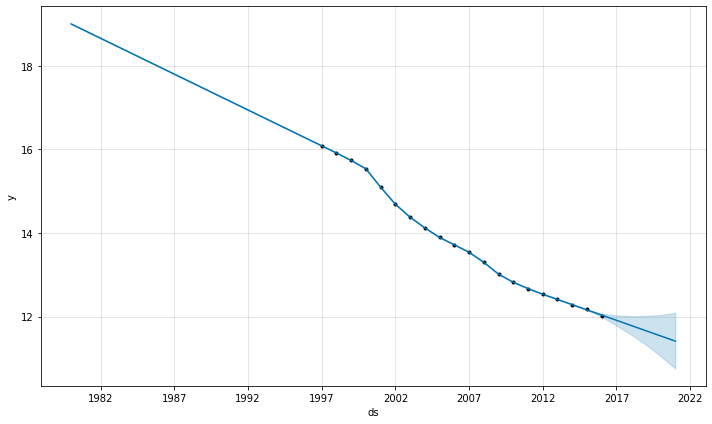

In [ ]:
evaluate_model(optimizer, usa_data_m)

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 15.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/8mwwse5h.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjad4h45l/dm0udjfj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7179', 'data', 'file=/tmp/tmpjad4h45l/8mwwse5h.json', 'init=/tmp/tmpjad4h45l/dm0udjfj.json', 'output', 'file=/tmp/tmpjad4h45l/prophet_model35wkt79n/prophet_model-20221022001844.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:18:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:18:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cm

--------------------Evaluation---------------------
MSE :  0.03125722777643269
MAE :  0.13122898801063343
MAPE :  0.17116874098556797
--------------------Evaluation---------------------


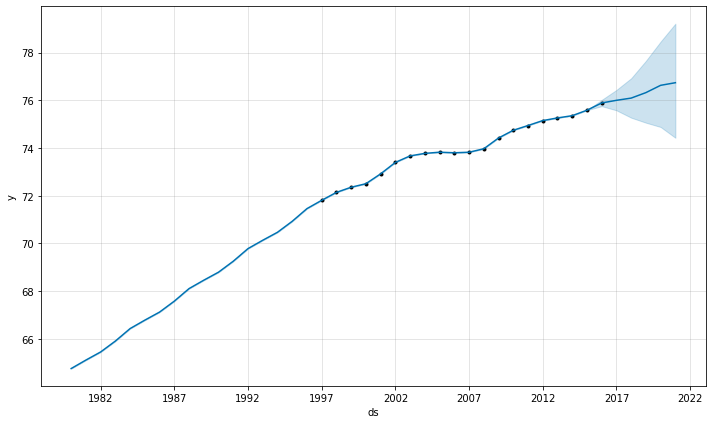

In [ ]:
fit_model_s(usa_data_s)

In [ ]:
optimizer, _, _ = getOpt_s(usa_data_s)

INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 15.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/aaxcf2hq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/lcm2yl4a.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=5212', 'data', 'file=/tmp/tmppq7tkcfl/aaxcf2hq.json', 'init=/tmp/tmppq7tkcfl/lcm2yl4a.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelfggmtpjn/prophet_model-20221114004131.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:41:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdst

|   iter    |  target   | yearly... |
-------------------------------------


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/xejqg2ry.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/funw14cy.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=29525', 'data', 'file=/tmp/tmppq7tkcfl/xejqg2ry.json', 'init=/tmp/tmppq7tkcfl/funw14cy.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modellgwa6qt2/prophet_model-20221114004131.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:41:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:41:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/9lx3dho4.json
DEBUG:cmdstanpy:input tempfile:

| 1         | -0.2442   | -0.3319   |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/26z1esr4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/rbo9i_1s.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=22984', 'data', 'file=/tmp/tmppq7tkcfl/26z1esr4.json', 'init=/tmp/tmppq7tkcfl/rbo9i_1s.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelczigl0_y/prophet_model-20221114004138.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:41:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:41:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/fu266m6l.json
DEBUG:cmdstanpy:input tempfile:

| 2         | -0.2936   | 0.8813    |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/7e0o13l_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/fnm6aeci.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=41272', 'data', 'file=/tmp/tmppq7tkcfl/7e0o13l_.json', 'init=/tmp/tmppq7tkcfl/fnm6aeci.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model73wzxjsw/prophet_model-20221114004145.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:41:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:41:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/q19z5juo.json
DEBUG:cmdstanpy:input tempfile:

| 3         | -0.2268   | -2.0      |


INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/g8vkl7sd.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/sc4lrrhn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=30399', 'data', 'file=/tmp/tmppq7tkcfl/g8vkl7sd.json', 'init=/tmp/tmppq7tkcfl/sc4lrrhn.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model2lj1l3sr/prophet_model-20221114004154.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:41:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:41:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/zirpjst1.json
DEBUG:cmdstanpy:input tempfile:

| 4         | -0.2419   | -0.7907   |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/h_b25pk1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/y98hr3lq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=42279', 'data', 'file=/tmp/tmppq7tkcfl/h_b25pk1.json', 'init=/tmp/tmppq7tkcfl/y98hr3lq.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelmp0znxxy/prophet_model-20221114004201.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:42:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:42:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/im1snj_5.json
DEBUG:cmdstanpy:input tempfile:

| 5         | -0.2402   | -1.413    |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/qaub20i_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/8nnp8jmd.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73079', 'data', 'file=/tmp/tmppq7tkcfl/qaub20i_.json', 'init=/tmp/tmppq7tkcfl/8nnp8jmd.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_models_ar7191/prophet_model-20221114004208.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:42:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:42:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/eii18xje.json
DEBUG:cmdstanpy:input tempfile:

| 6         | -0.2381   | -1.631    |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/n_wnqjsh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/pmiwzxe6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=8524', 'data', 'file=/tmp/tmppq7tkcfl/n_wnqjsh.json', 'init=/tmp/tmppq7tkcfl/pmiwzxe6.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeltitytr0i/prophet_model-20221114004216.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:42:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:42:16 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/4k2rhrhl.json
DEBUG:cmdstanpy:input tempfile: 

| 7         | -0.241    | -1.255    |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ma5heslt.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/y1qqjxvw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=54324', 'data', 'file=/tmp/tmppq7tkcfl/ma5heslt.json', 'init=/tmp/tmppq7tkcfl/y1qqjxvw.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modeljitpzgct/prophet_model-20221114004223.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:42:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:42:23 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/k56qs0jo.json
DEBUG:cmdstanpy:input tempfile:

| 8         | -0.2423   | -0.6178   |


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/tzzworh7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/0zphp06k.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=74128', 'data', 'file=/tmp/tmppq7tkcfl/tzzworh7.json', 'init=/tmp/tmppq7tkcfl/0zphp06k.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model9w68rpn9/prophet_model-20221114004230.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:42:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:42:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/mpvbz3tg.json
DEBUG:cmdstanpy:input tempfile:

| 9         | -0.2434   | -0.4129   |


INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/p5qur089.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/qnw8ql7n.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=9540', 'data', 'file=/tmp/tmppq7tkcfl/p5qur089.json', 'init=/tmp/tmppq7tkcfl/qnw8ql7n.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model1vg18qi6/prophet_model-20221114004239.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:42:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:42:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/qhby6ylt.json
DEBUG:cmdstanpy:input tempfile: 

| 10        | -0.2705   | 0.1553    |


00:42:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/s5xw8379.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ns53fxli.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=81140', 'data', 'file=/tmp/tmppq7tkcfl/s5xw8379.json', 'init=/tmp/tmppq7tkcfl/ns53fxli.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelf0gy220f/prophet_model-20221114004246.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:42:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:42:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/vpz9f533.json
DEBUG:cmdstanpy:input tempfile:

| 11        | -0.3038   | 2.0       |


INFO:prophet:n_changepoints greater than number of observations. Using 15.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/o3l707oi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/sz6_9u_6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=44969', 'data', 'file=/tmp/tmppq7tkcfl/o3l707oi.json', 'init=/tmp/tmppq7tkcfl/sz6_9u_6.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelwgbzv867/prophet_model-20221114004253.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:42:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:42:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 9 forecasts with cutoffs between 2007-01-03 00:00:00 and 2015-01-01 00:00:00


  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/_d48naj4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/jyimffzd.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=11688', 'data', 'file=/tmp/tmppq7tkcfl/_d48naj4.json', 'init=/tmp/tmppq7tkcfl/jyimffzd.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelf709ea37/prophet_model-20221114004254.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:42:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:42:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ehopjrn5.json
DEBUG:cmdstanpy:input tempfile:

| 12        | -0.2268   | -2.0      |
| 13        | -0.2268   | -2.0      |
| 14        | -0.2268   | -2.0      |


INFO:prophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 15.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/h7b5uali.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/ln35iyri.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=17102', 'data', 'file=/tmp/tmppq7tkcfl/h7b5uali.json', 'init=/tmp/tmppq7tkcfl/ln35iyri.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_modelvm1szn_8/prophet_model-20221114004301.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:43:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmds

  0%|          | 0/9 [00:00<?, ?it/s]

INFO:prophet:n_changepoints greater than number of observations. Using 7.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/yfnjg5kw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/gxxwruyu.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.7/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=6732', 'data', 'file=/tmp/tmppq7tkcfl/yfnjg5kw.json', 'init=/tmp/tmppq7tkcfl/gxxwruyu.json', 'output', 'file=/tmp/tmppq7tkcfl/prophet_model6vcdihah/prophet_model-20221114004301.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
00:43:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:43:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmppq7tkcfl/3ph3phh0.json
DEBUG:cmdstanpy:input tempfile: 

--------------------Evaluation---------------------
MSE :  0.052700573414843216
MAE :  0.15282422655549865
MAPE :  0.19917392088694488
--------------------Evaluation---------------------


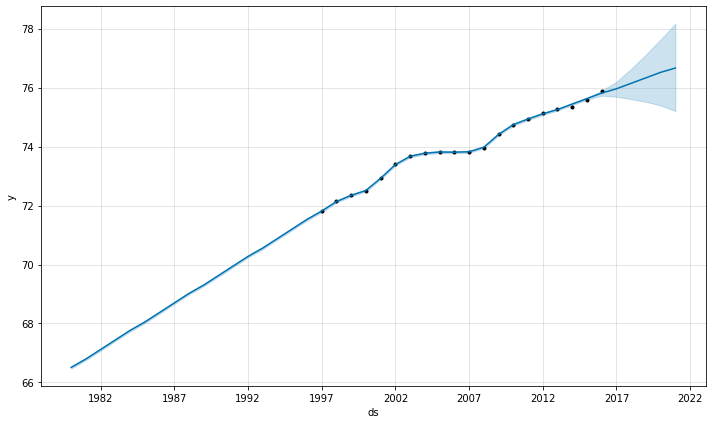

In [ ]:
evaluate_model_s(optimizer, usa_data_s)